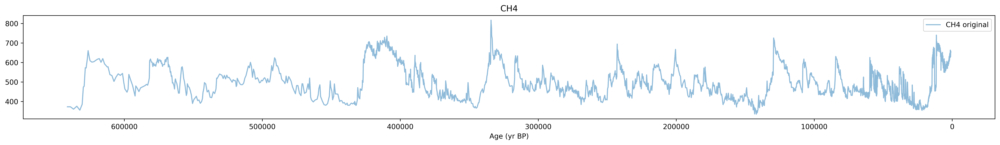

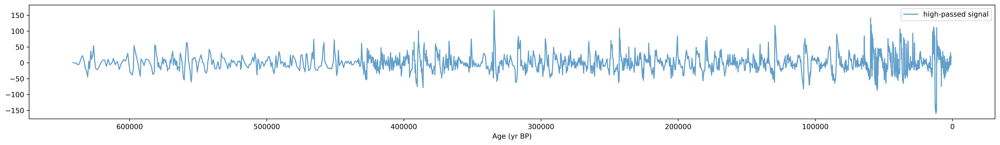

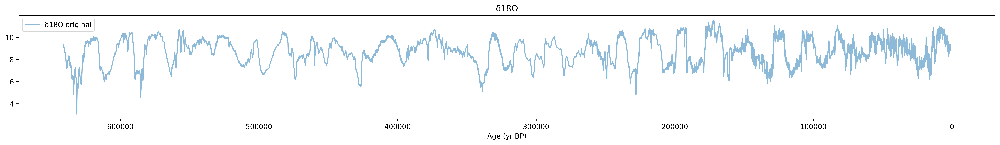

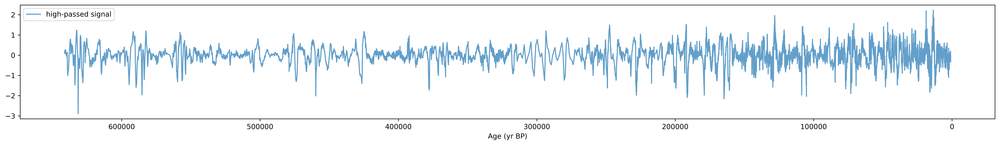

In [107]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.signal import butter, filtfilt
from sklearn.cluster import KMeans

# 0) Load raw data
df_ch4 = pd.read_excel('other_data/CH4_AICC2023.xlsx', sheet_name='Sheet1')
file_path = r"D:\VScode\bipolar_seesaw_CCM\other_data\monsoon.xlsx"
df_d18O = pd.read_excel(file_path)
df_d18O['age'] *= 1000  # to yrs BP
df_d18O['d18O'] = df_d18O['d18O'].values*-1
# renmae column d18O to 'd18O*-1'
df_d18O.rename(columns={'d18O': '-d18O'}, inplace=True)


# 1) Build common 10-yr age grid over their overlap
age_min = 1000 # max(df_ch4['age'].min(), df_d18O['age'].min())
age_max = min(df_ch4['age'].max(), df_d18O['age'].max())
ages = np.arange(age_min, age_max + 1, 20)

# 2) Interpolate each onto that grid
ch4 = np.interp(ages, df_ch4['age'], df_ch4['ch4'])
d18O = np.interp(ages, df_d18O['age'], df_d18O['-d18O'])
d180=d18O


ser_ch4  = pd.Series(ch4,  index=ages)
ser_d18O = pd.Series(d18O, index=ages)

# 1) Design a 4th-order Butterworth high-pass filter
fs = 1 / 20.0      # sampling rate: 1 sample per 10 yr → 0.1 yr⁻¹
fc = 1 / 10000.0   # cutoff frequency: want to remove periods > 10 000 yr
Wn = fc / (fs / 2) # normalized cutoff (Nyquist = fs/2)

b, a = butter(N=4, Wn=Wn, btype='highpass')

# 2) Apply filter to each series
#    filtfilt for zero phase‐shift
filt_ch4 = filtfilt(b, a, ser_ch4.values)
filt_d18O = filtfilt(b, a, ser_d18O.values)

# wrap back into Series
resid_ch4 = pd.Series(filt_ch4,  index=ser_ch4.index)
resid_d18O = pd.Series(filt_d18O, index=ser_d18O.index)


for name, orig, filt in [
    ('CH4',  ser_ch4,  resid_ch4),
    ('δ18O', ser_d18O, resid_d18O),
]:
    # original + high-passed + square fit
    plt.figure(figsize=(20,3),dpi=600)
    plt.plot(orig.index, orig,    label=f'{name} original', alpha=0.5)
    # plt.plot(filt.index, filt,    label=f'{name} high-pass (<10 ka)', lw=2)

    plt.gca().invert_xaxis()
    plt.xlabel('Age (yr BP)')
    plt.legend()
    plt.title(name)
    plt.tight_layout()
    plt.show()

    # high-passed + square fit only
    plt.figure(figsize=(20,3),dpi=600)
    plt.plot(filt.index, filt,    label='high-passed signal', alpha=0.7)

    plt.gca().invert_xaxis()
    plt.xlabel('Age (yr BP)')
    plt.legend()
    plt.tight_layout()
    plt.show()

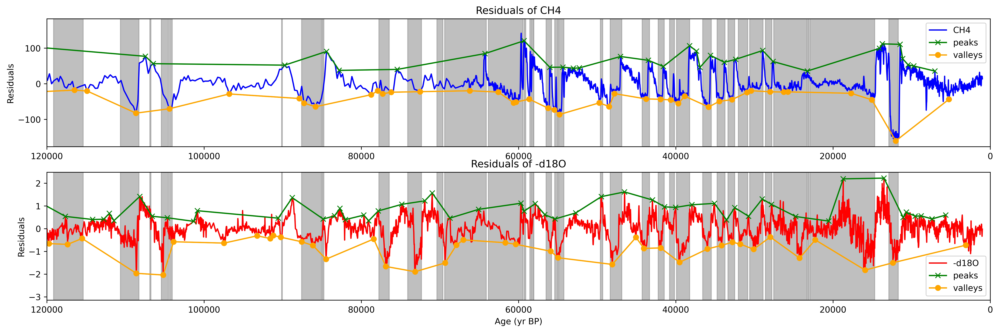

In [125]:
# plot residuals in 2 by 1 subplots
import matplotlib.gridspec as gridspec
fig = plt.figure(figsize=(20, 6), dpi=600)
gs = gridspec.GridSpec(2, 1, height_ratios=[1, 1])  # 2 rows, 1 column
ax0 = fig.add_subplot(gs[0])
ax1 = fig.add_subplot(gs[1])
ax0.plot(resid_ch4.index, resid_ch4, label='CH4', color='blue')
ax1.plot(resid_d18O.index, resid_d18O, label='-d18O', color='red')

# find peaks in resid_ch4, minimum distance between peaks is 15 data points
from scipy.signal import find_peaks
peaks_ch4, _ = find_peaks(resid_ch4, height=np.quantile(resid_ch4,0.90), distance=15, width =10)
peaks_d18O, _ = find_peaks(resid_d18O, height=np.quantile(resid_d18O,0.80), distance=15, width =10)
# find valleys in resid_ch4
valleys_ch4, _ = find_peaks(-resid_ch4, height=np.quantile(-resid_ch4,0.80), distance=15, width =15)
valleys_d18O, _ = find_peaks(-resid_d18O, height=np.quantile(-resid_d18O,0.80), distance=15, width =15)
# plot peaks and valleys, mark them with 'x' and 'o' respectively
ax0.plot(resid_ch4.index[peaks_ch4], resid_ch4.iloc[peaks_ch4], 'x', linestyle='-', color='green', label='peaks')
ax0.plot(resid_ch4.index[valleys_ch4], resid_ch4.iloc[valleys_ch4], 'o',  linestyle='-', color='orange', label='valleys')
ax1.plot(resid_d18O.index[peaks_d18O], resid_d18O.iloc[peaks_d18O], 'x',  linestyle='-', color='green', label='peaks')
ax1.plot(resid_d18O.index[valleys_d18O], resid_d18O.iloc[valleys_d18O], 'o',  linestyle='-', color='orange', label='valleys')



ax0.set_title('Residuals of CH4')
ax1.set_title('Residuals of -d18O')
ax0.set_ylabel('Residuals')
ax1.set_ylabel('Residuals')
ax1.set_xlabel('Age (yr BP)')
ax0.legend()
ax1.legend()
# set x-axis limits
ax0.set_xlim(120000, 0)
ax1.set_xlim(120000, 0)
# plot the following data as grey vertical spans
gs_data = {
    "start": np.array([11703, 14692, 23020, 23340, 27780, 28900, 30840, 32500, 33740, 35480,
                       38220, 40160, 41460, 43340, 46860, 49280, 54220, 55000, 55800, 58040,
                       58280, 59080, 59440, 64100, 69620, 72340, 76440, 84760, 85060, 90040,
                       104040,104520,106750,108280,115370]),
    "end":   np.array([12896, 22900, 23220, 27540, 28600, 30600, 32040, 33360, 34740, 36580,
                       39900, 40800, 42240, 44280, 48340, 49600, 54900, 55400, 56500, 58160,
                       58560, 59300, 63840, 69400, 70380, 74100, 77760, 84960, 87600, 90140,
                       104380,105440,106900,110640,119140])
}
for start, end in zip(gs_data["start"], gs_data["end"]):
    ax0.axvspan(start, end, color='grey', alpha=0.5)
    ax1.axvspan(start, end, color='grey', alpha=0.5)


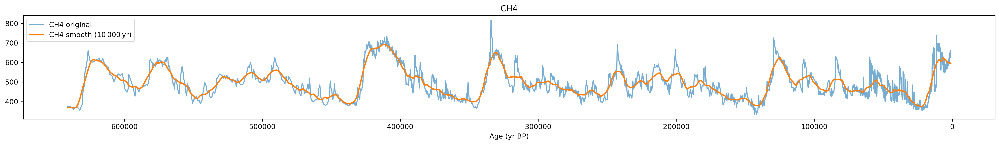

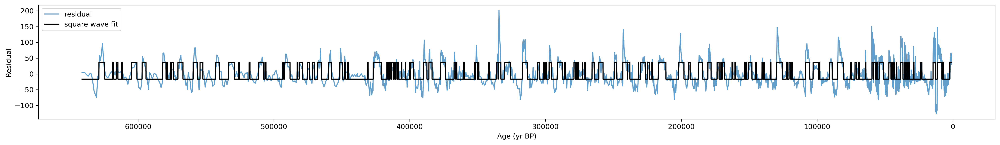

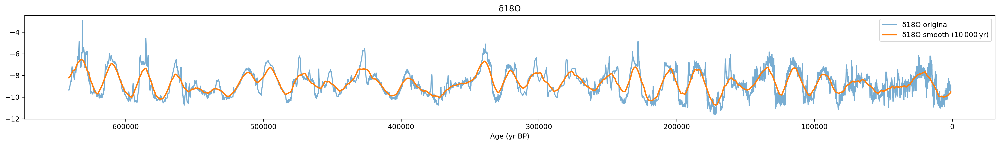

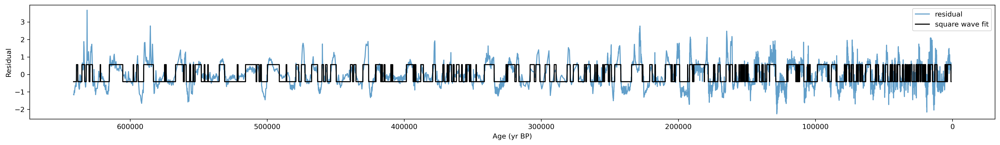

In [70]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

# 0) Load raw data
df_ch4 = pd.read_excel('other_data/CH4_AICC2023.xlsx', sheet_name='Sheet1')
file_path = r"D:\VScode\bipolar_seesaw_CCM\other_data\monsoon.xlsx"
df_d18O = pd.read_excel(file_path)
df_d18O['age'] *= 1000  # to yrs BP

# 1) Build common 10-yr age grid over their overlap
age_min = 1000 # max(df_ch4['age'].min(), df_d18O['age'].min())
age_max = min(df_ch4['age'].max(), df_d18O['age'].max())
ages = np.arange(age_min, age_max + 1, 10)

# 2) Interpolate each onto that grid
ch4 = np.interp(ages, df_ch4['age'], df_ch4['ch4'])
d18O = np.interp(ages, df_d18O['age'], df_d18O['d18O'])

# — assume you already have ages, ch4, d18O as before —
ser_ch4  = pd.Series(ch4,  index=ages)
ser_d18O = pd.Series(d18O, index=ages)

window_pts = int(10000 / 10)  # 10 000 yr / 10 yr per sample

smooth_ch4  = ser_ch4.rolling(window=window_pts, center=True, min_periods=1).mean()
smooth_d18O = ser_d18O.rolling(window=window_pts, center=True, min_periods=1).mean()

resid_ch4  = ser_ch4  - smooth_ch4
resid_d18O = ser_d18O - smooth_d18O

def enforce_min_duration(labels, min_pts):
    """
    Flip any runs of consecutive labels shorter than min_pts.
    """
    labels = labels.copy()
    # run‐length encode
    n = len(labels)
    # start indices of each run
    starts = np.concatenate(([0], np.where(labels[1:] != labels[:-1])[0] + 1))
    # end indices
    ends   = np.concatenate((starts[1:], [n]))
    for s, e in zip(starts, ends):
        length = e - s
        if length < min_pts:
            # flip this short run
            labels[s:e] = 1 - labels[s]
    return labels

def fit_square_with_min(resid, min_pts=30):
    """
    1) 2-cluster k-means to get raw labels & centers
    2) enforce a minimum run length of min_pts
    3) build the step function
    """
    X = resid.values.reshape(-1,1)
    km = KMeans(n_clusters=2, n_init=10, random_state=0).fit(X)
    centers = np.sort(km.cluster_centers_.flatten())
    raw_labels = km.labels_
    # if sorting swapped the labels order, reassign
    if km.cluster_centers_[0] > km.cluster_centers_[1]:
        raw_labels = 1 - raw_labels

    # enforce minimum duration:
    labels = enforce_min_duration(raw_labels, min_pts)

    # construct fitted square wave:
    fit = np.where(labels==1, centers[1], centers[0])
    return fit, labels, centers

# compute fits with min duration = 30
fit_ch4,  lbl_ch4,  cen_ch4  = fit_square_with_min(resid_ch4,  min_pts=30)
fit_d18O, lbl_d18O, cen_d18O = fit_square_with_min(resid_d18O, min_pts=30)

for name, orig, smooth, resid, fit, cen in [
    ('CH4',  ser_ch4,  smooth_ch4,  resid_ch4,  fit_ch4,  cen_ch4),
    ('δ18O', ser_d18O, smooth_d18O, resid_d18O, fit_d18O, cen_d18O),
]:
    # 1) data + smooth + square wave
    plt.figure(figsize=(20,3),dpi=300)
    plt.plot(orig.index, orig,    label=f'{name} original', alpha=0.6)
    plt.plot(smooth.index, smooth, label=f'{name} smooth (10 000 yr)', lw=2)
    # plt.step(orig.index, fit, where='mid',
    #          label=f'square wave (centers = {cen[0]:.2f}, {cen[1]:.2f})',
    #          color='k')
    plt.gca().invert_xaxis()
    plt.title(f'{name}')
    plt.xlabel('Age (yr BP)')
    plt.legend()
    plt.tight_layout()
    plt.show()

    # 2) residual + square wave
    plt.figure(figsize=(20,3),dpi=300)
    plt.plot(resid.index, resid, label='residual', alpha=0.7)
    plt.step(resid.index, fit, where='mid', label='square wave fit', color='k')
    plt.gca().invert_xaxis()
    plt.xlabel('Age (yr BP)')
    plt.ylabel('Residual')
    plt.legend()
    plt.tight_layout()
    plt.show()


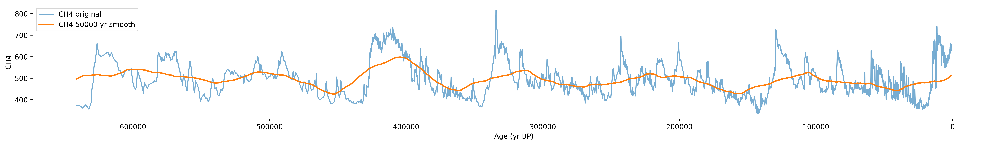

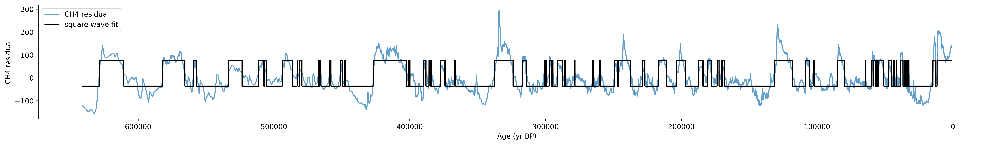

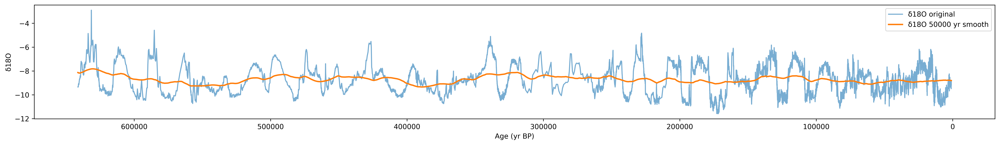

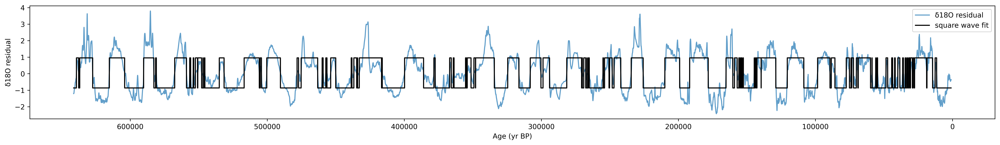

In [84]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans


# 0) Load raw data
df_ch4 = pd.read_excel('other_data/CH4_AICC2023.xlsx', sheet_name='Sheet1')
file_path = r"D:\VScode\bipolar_seesaw_CCM\other_data\monsoon.xlsx"
df_d18O = pd.read_excel(file_path)
df_d18O['age'] *= 1000  # to yrs BP

# 1) Build common 10-yr age grid over their overlap
age_min = 1000 # max(df_ch4['age'].min(), df_d18O['age'].min())
age_max = min(df_ch4['age'].max(), df_d18O['age'].max())
ages = np.arange(age_min, age_max + 1, 10)

# 2) Interpolate each onto that grid
ch4 = np.interp(ages, df_ch4['age'], df_ch4['ch4'])
d18O = np.interp(ages, df_d18O['age'], df_d18O['d18O'])
d180=d18O


ser_ch4  = pd.Series(ch4,  index=ages)
ser_d18O = pd.Series(d18O, index=ages)

window_pts = int(50000 / 10)  # 10 000 yr / 10 yr per sample

smooth_ch4  = ser_ch4.rolling(window=window_pts, center=True, min_periods=1).mean()
smooth_d18O = ser_d18O.rolling(window=window_pts, center=True, min_periods=1).mean()

resid_ch4  = ser_ch4  - smooth_ch4
resid_d18O = ser_d18O - smooth_d18O

# smooth the residuals with a 10 pt rolling mean
resid_ch4  = resid_ch4.rolling(window=30, center=True, min_periods=1).mean()
resid_d18O = resid_d18O.rolling(window=30, center=True, min_periods=1).mean()

def fit_square(resid):
    # 2-cluster k-means on the residual
    X = resid.values.reshape(-1,1)
    km = KMeans(n_clusters=2, n_init=10, random_state=0).fit(X)
    centers = km.cluster_centers_.flatten()
    labels  = km.labels_
    # enforce centers[0] < centers[1]
    if centers[0] > centers[1]:
        centers = centers[::-1]
        labels  = 1 - labels
    fit = np.where(labels==1, centers[1], centers[0])
    return fit, centers

fit_ch4,  cen_ch4  = fit_square(resid_ch4)
fit_d18O, cen_d18O = fit_square(resid_d18O)

for name, orig, smooth, resid, fit, cen in [
    ('CH4',  ser_ch4,  smooth_ch4,  resid_ch4,  fit_ch4,  cen_ch4),
    ('δ18O', ser_d18O, smooth_d18O, resid_d18O, fit_d18O, cen_d18O),
]:
    # 1) original + smooth + square wave
    plt.figure(figsize=(20,3),dpi=600)
    plt.plot(orig.index, orig,    label=f'{name} original', alpha=0.6)
    plt.plot(smooth.index, smooth, label=f'{name} {window_pts*10:d} yr smooth', lw=2)
    # plt.step(orig.index, fit, where='mid',
    #          label=f'{name} square wave (centers={cen[0]:.2f},{cen[1]:.2f})',
    #          color='k', lw=1.5)
    plt.gca().invert_xaxis()
    plt.xlabel('Age (yr BP)')
    plt.ylabel(name)
    plt.legend()
    plt.tight_layout()
    plt.show()

    # 2) residual + square wave
    plt.figure(figsize=(20,3),dpi=600)
    plt.plot(resid.index, resid,    label=f'{name} residual', alpha=0.7)
    plt.step(resid.index, fit, where='mid',
             label='square wave fit', color='k', lw=1.5)
    plt.gca().invert_xaxis()
    plt.xlabel('Age (yr BP)')
    plt.ylabel(f'{name} residual')
    plt.legend()
    plt.tight_layout()
    plt.show()


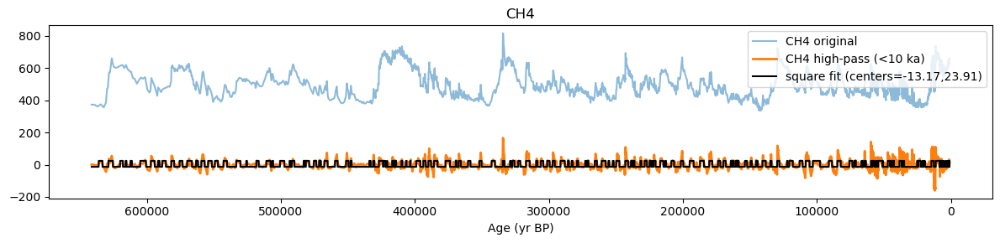

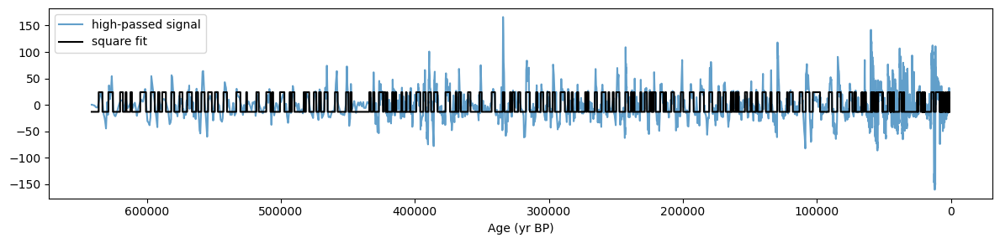

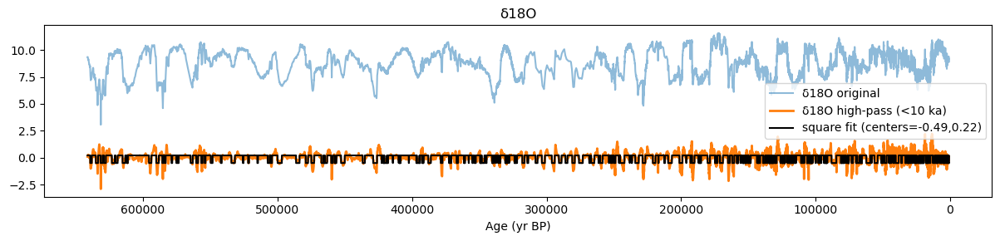

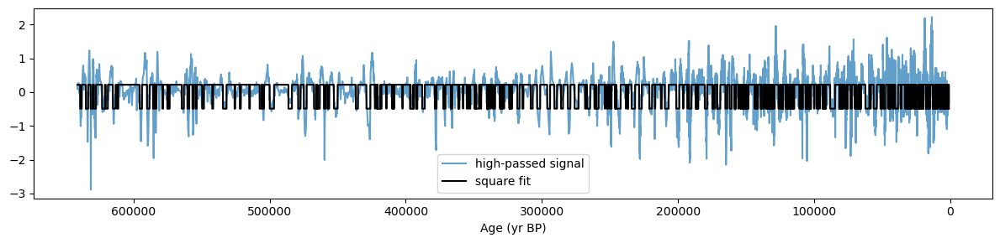

In [143]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.signal import butter, filtfilt
from sklearn.cluster import KMeans

# 0) Load raw data
df_ch4 = pd.read_excel('other_data/CH4_AICC2023.xlsx', sheet_name='Sheet1')
file_path = r"D:\VScode\bipolar_seesaw_CCM\other_data\monsoon.xlsx"
df_d18O = pd.read_excel(file_path)
df_d18O['age'] *= 1000  # to yrs BP
df_d18O['d18O'] = df_d18O['d18O'].values*-1
# renmae column d18O to 'd18O*-1'
df_d18O.rename(columns={'d18O': '-d18O'}, inplace=True)


# 1) Build common 10-yr age grid over their overlap
age_min = 1000 # max(df_ch4['age'].min(), df_d18O['age'].min())
age_max = min(df_ch4['age'].max(), df_d18O['age'].max())
ages = np.arange(age_min, age_max + 1, 20)

# 2) Interpolate each onto that grid
ch4 = np.interp(ages, df_ch4['age'], df_ch4['ch4'])
d18O = np.interp(ages, df_d18O['age'], df_d18O['-d18O'])



ser_ch4  = pd.Series(ch4,  index=ages)
ser_d18O = pd.Series(d18O, index=ages)

# 1) Design a 4th-order Butterworth high-pass filter
fs = 1 / 20.0      # sampling rate: 1 sample per 10 yr → 0.1 yr⁻¹
fc = 1 / 10000.0   # cutoff frequency: want to remove periods > 10 000 yr
Wn = fc / (fs / 2) # normalized cutoff (Nyquist = fs/2)

b, a = butter(N=4, Wn=Wn, btype='highpass')

# 2) Apply filter to each series
#    filtfilt for zero phase‐shift
filt_ch4 = filtfilt(b, a, ser_ch4.values)
filt_d18O = filtfilt(b, a, ser_d18O.values)

# wrap back into Series
resid_ch4 = pd.Series(filt_ch4,  index=ser_ch4.index)
resid_d18O = pd.Series(filt_d18O, index=ser_d18O.index)

def fit_square(resid, min_pts=None):
    """
    1) 2-cluster k-means on the high-passed data
    2) optionally enforce a minimum run length in points
    3) return fitted step wave + cluster centers
    """
    X = resid.values.reshape(-1,1)
    km = KMeans(n_clusters=2, n_init=10, random_state=0).fit(X)
    centers = km.cluster_centers_.flatten()
    labels  = km.labels_
    # ensure centers[0] < centers[1]
    if centers[0] > centers[1]:
        centers = centers[::-1]
        labels  = 1 - labels

    # optional: enforce minimum duration of each phase
    if min_pts is not None:
        def enforce_min(labels, minl):
            lab = labels.copy()
            n = len(lab)
            starts = np.concatenate(([0], np.where(lab[1:]!=lab[:-1])[0]+1))
            ends   = np.concatenate((starts[1:], [n]))
            for s,e in zip(starts, ends):
                if (e-s) < minl:
                    lab[s:e] = 1 - lab[s]
            return lab
        labels = enforce_min(labels, min_pts)

    fit = np.where(labels==1, centers[1], centers[0])
    return fit, centers

# 3) Fit square waves (with e.g. min duration = 30 points if you like)
fit_ch4,  cen_ch4  = fit_square(resid_ch4,  min_pts=30)
fit_d18O, cen_d18O = fit_square(resid_d18O, min_pts=30)

# 4) Plot
for name, orig, filt, fit, cen in [
    ('CH4',  ser_ch4,  resid_ch4,  fit_ch4,  cen_ch4),
    ('δ18O', ser_d18O, resid_d18O, fit_d18O, cen_d18O),
]:
    # original + high-passed + square fit
    plt.figure(figsize=(12,3))
    plt.plot(orig.index, orig,    label=f'{name} original', alpha=0.5)
    plt.plot(filt.index, filt,    label=f'{name} high-pass (<10 ka)', lw=2)
    plt.step(orig.index, fit, where='mid',
             label=f'square fit (centers={cen[0]:.2f},{cen[1]:.2f})',
             color='k')
    plt.gca().invert_xaxis()
    plt.xlabel('Age (yr BP)')
    plt.legend()
    plt.title(name)
    plt.tight_layout()
    plt.show()

    # high-passed + square fit only
    plt.figure(figsize=(12,3))
    plt.plot(filt.index, filt,    label='high-passed signal', alpha=0.7)
    plt.step(filt.index, fit, where='mid', label='square fit', color='k')
    plt.gca().invert_xaxis()
    plt.xlabel('Age (yr BP)')
    plt.legend()
    plt.tight_layout()
    plt.show()

df_filt_ch4 = pd.DataFrame({'age':filt.index, 'fit_ch4':fit_ch4})
df_filt_d18O = pd.DataFrame({'age':filt.index, 'fit_d18O':fit_d18O})


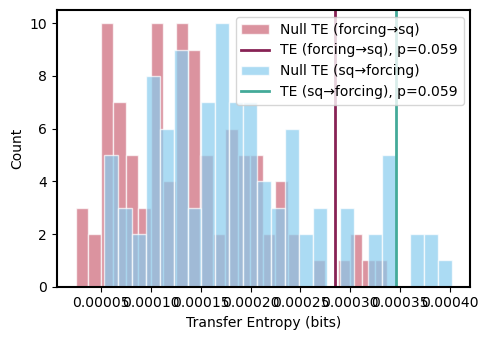

False

In [145]:
from toolbox import sq_ana as sa 
import importlib
importlib.reload(sa)

df_sq_i, df_pre_i, df_obl_i = sa.interpolate_data_forcing(df_filt_ch4.copy(), 20, if_plot=False)


pre = df_pre_i['pre'].values      # source (precession)
sq = df_sq_i['fit_ch4'].values    # target (residual)


result,fig=sa.transfer_entropy_surrogate_test(pre,sq, forcing_bins=4)

# fig.savefig('TE_NGRIP.pdf',format='pdf',bbox_inches='tight')

result

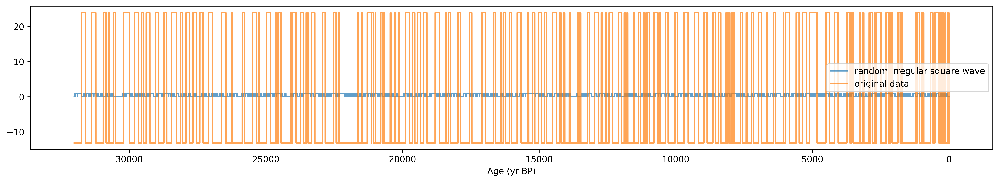

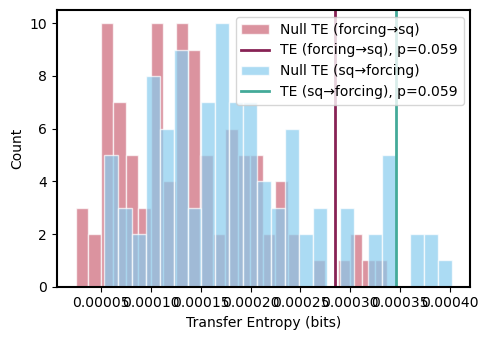

False

In [147]:
from toolbox import sq_ana as sa 
import importlib
importlib.reload(sa)

df_sq_i, df_pre_i, df_obl_i = sa.interpolate_data_forcing(df_filt_ch4.copy(), 20, if_plot=False)


pre = df_pre_i['pre'].values      # source (precession)
sq = df_sq_i['fit_ch4'].values    # target (residual)

# generate a random irregular square wave, with the same length as sq, the minium duration and maximum duration of the low or high phase is 10 and 400 respectively
np.random.seed(0)
n = len(sq)
min_duration = 10
max_duration = 400
# generate a random irregular square wave
random_wave = np.zeros(n)
for i in range(n):
    if i == 0:
        random_wave[i] = np.random.choice([0, 1])
    else:
        if random_wave[i-1] == 0:
            random_wave[i] = np.random.choice([0, 1], p=[1 - min_duration / max_duration, min_duration / max_duration])
        else:
            random_wave[i] = np.random.choice([0, 1], p=[min_duration / max_duration, 1 - min_duration / max_duration])

# plot the random irregular square wave
plt.figure(figsize=(20,3),dpi=600)
plt.plot(random_wave, label='random irregular square wave', alpha=0.7)
plt.gca().invert_xaxis()
# plot the original data
plt.plot(sq, label='original data', alpha=0.7)
plt.xlabel('Age (yr BP)')
plt.legend()



result,fig=sa.transfer_entropy_surrogate_test(pre,sq, forcing_bins=4)

# fig.savefig('TE_NGRIP.pdf',format='pdf',bbox_inches='tight')

result

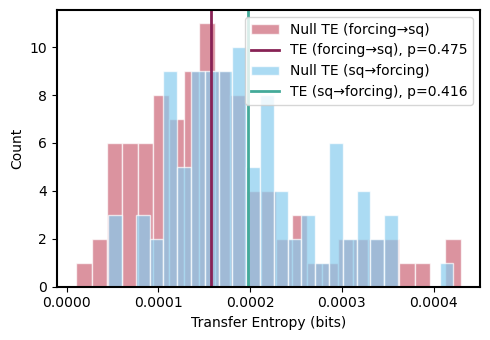

False

In [148]:
from toolbox import sq_ana as sa 
import importlib
importlib.reload(sa)

df_sq_i, df_pre_i, df_obl_i = sa.interpolate_data_forcing(df_filt_d18O.copy(), 20, if_plot=False)


pre = df_pre_i['pre'].values      # source (precession)
sq = df_sq_i['fit_d18O'].values    # target (residual)


result,fig=sa.transfer_entropy_surrogate_test(pre,sq, forcing_bins=4)

# fig.savefig('TE_NGRIP.pdf',format='pdf',bbox_inches='tight')

result

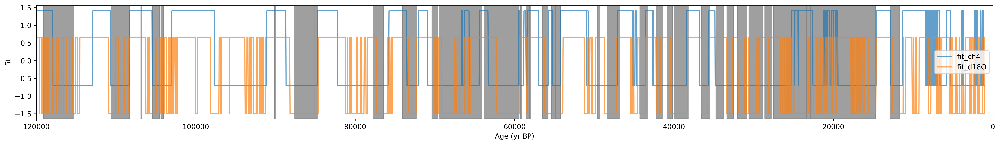

In [141]:
from scipy.stats import zscore
# zscore the fit_ch4 and fit_d18O

# plot fit_ch4 and fit_d18O
plt.figure(figsize=(20,3),dpi=600)
plt.plot(df_filt_ch4['age'], zscore(fit_ch4), label='fit_ch4', alpha=0.7)
plt.plot(df_filt_d18O['age'], zscore(fit_d18O), label='fit_d18O', alpha=0.7)

gs_data = {
    "start": np.array([11703, 14692, 23020, 23340, 27780, 28900, 30840, 32500, 33740, 35480,
                       38220, 40160, 41460, 43340, 46860, 49280, 54220, 55000, 55800, 58040,
                       58280, 59080, 59440, 64100, 69620, 72340, 76440, 84760, 85060, 90040,
                       104040,104520,106750,108280,115370]),
    "end":   np.array([12896, 22900, 23220, 27540, 28600, 30600, 32040, 33360, 34740, 36580,
                       39900, 40800, 42240, 44280, 48340, 49600, 54900, 55400, 56500, 58160,
                       58560, 59300, 63840, 69400, 70380, 74100, 77760, 84960, 87600, 90140,
                       104380,105440,106900,110640,119140])
}
for start, end in zip(gs_data["start"], gs_data["end"]):
    plt.axvspan(start, end, color='grey', alpha=0.5)
    plt.axvspan(start, end, color='grey', alpha=0.5)

# set x-axis limits
plt.xlim(0, 120000)

plt.gca().invert_xaxis()
plt.xlabel('Age (yr BP)')
plt.ylabel('fit')
plt.legend()
plt.tight_layout()

In [95]:
import numpy as np
import pandas as pd


# your glacier‐state start times:
gs_data = {
    "start": np.array([11703, 14692, 23020, 23340, 27780, 28900, 30840, 32500, 33740, 35480,
                       38220, 40160, 41460, 43340, 46860, 49280, 54220, 55000, 55800, 58040,
                       58280, 59080, 59440, 64100, 69620, 72340, 76440, 84760, 85060, 90040,
                       104040,104520,106750,108280,115370]),
    "end":   np.array([12896, 22900, 23220, 27540, 28600, 30600, 32040, 33360, 34740, 36580,
                       39900, 40800, 42240, 44280, 48340, 49600, 54900, 55400, 56500, 58160,
                       58560, 59300, 63840, 69400, 70380, 74100, 77760, 84960, 87600, 90140,
                       104380,105440,106900,110640,119140])
}

def crop_series(resid, age_max=120000):
    """Keep only ages ≤ age_max."""
    return resid[resid.index <= age_max]

def detect_starts(ser, thr):
    """
    Return array of ages where ser crosses up through thr:
    i.e. ser[t-1] ≤ thr < ser[t]
    """
    above = ser > thr
    # shift: previous point (fill False at start)
    prev = above.shift(1, fill_value=False)
    # rising edge = was below then above
    starts = ser.index[(~prev) & (above)]
    return starts.values

def find_best_threshold(ser, target_starts, thr_min=None, thr_max=None, n_steps=500):
    """
    Scan thresholds in [thr_min, thr_max], detect starts,
    pick thr that minimizes MSE against target_starts.
    """
    # default search window = 90–99.9 percentile of data
    vals = ser.values
    if thr_min is None:
        thr_min = np.percentile(vals, 90)
    if thr_max is None:
        thr_max = np.percentile(vals, 99.9)
    best = {'thr':None, 'score':np.inf, 'detected':None}
    for thr in np.linspace(thr_min, thr_max, n_steps):
        det = detect_starts(ser, thr)
        # only compare the first len(target) events
        det_trim = det[:len(target_starts)]
        # if we detect too few, penalize heavily
        if len(det_trim) < len(target_starts):
            score = np.inf
        else:
            score = np.mean((det_trim - target_starts)**2)
        if score < best['score']:
            best.update(thr=thr, score=score, detected=det_trim)
    return best

# 1) Crop both series
resid_ch4_crop = crop_series(resid_ch4, age_max=120000)
resid_d18O_crop = crop_series(resid_d18O, age_max=120000)

# 2) Find best thresholds
ch4_best  = find_best_threshold(resid_ch4_crop,  gs_data['start'])
d18O_best = find_best_threshold(resid_d18O_crop, gs_data['start'])

print(f"CH4 best threshold:  {ch4_best['thr']:.3f},  score={ch4_best['score']:.1f}")
print(f"δ18O best threshold: {d18O_best['thr']:.3f}, score={d18O_best['score']:.1f}")

# 3) Extract the final binary mask or thresholded series
mask_ch4  = resid_ch4_crop > ch4_best['thr']
mask_d18O = resid_d18O_crop > d18O_best['thr']

# Optional: get the detected starts
starts_ch4  = detect_starts(resid_ch4_crop, ch4_best['thr'])
starts_d18O = detect_starts(resid_d18O_crop, d18O_best['thr'])


CH4 best threshold:  51.306,  score=376686836.4
δ18O best threshold: 1.293, score=283450407.2


(-0.5, 0.5)

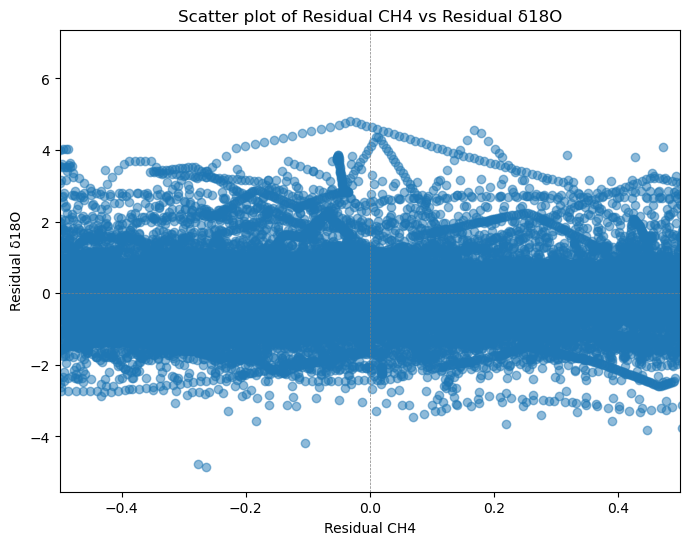

In [90]:


# plot a scatter plot for resid_ch4 vs resid_d18O
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import zscore

# Create a scatter plot
plt.figure(figsize=(8, 6), dpi=100)
plt.scatter(zscore(resid_ch4), zscore(resid_d18O), alpha=0.5)
plt.xlabel('Residual CH4')
plt.ylabel('Residual δ18O')
plt.title('Scatter plot of Residual CH4 vs Residual δ18O')
plt.axhline(0, color='gray', lw=0.5, ls='--')
plt.axvline(0, color='gray', lw=0.5, ls='--')
plt.xlim(-0.5, 0.5)


(-0.5, 0.5)

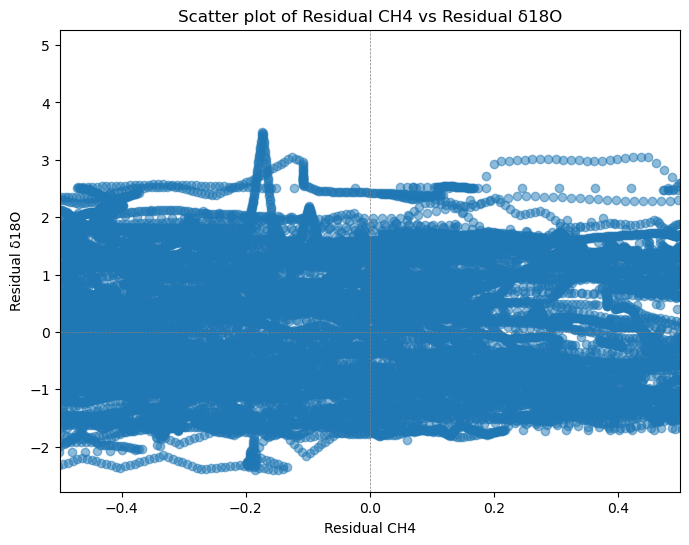

In [93]:


# plot a scatter plot for resid_ch4 vs resid_d18O
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import zscore

# Create a scatter plot
plt.figure(figsize=(8, 6), dpi=100)
plt.scatter(zscore(ser_ch4), zscore(ser_d18O), alpha=0.5)
plt.xlabel('Residual CH4')
plt.ylabel('Residual δ18O')
plt.title('Scatter plot of Residual CH4 vs Residual δ18O')
plt.axhline(0, color='gray', lw=0.5, ls='--')
plt.axvline(0, color='gray', lw=0.5, ls='--')
plt.xlim(-0.5, 0.5)

(64129,)
(64129,)


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


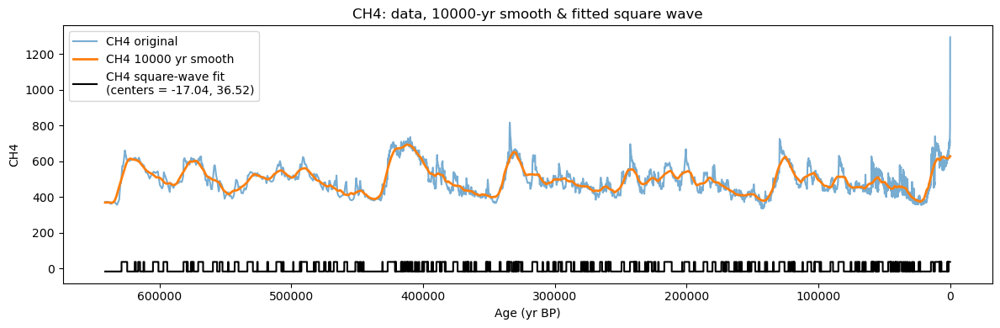

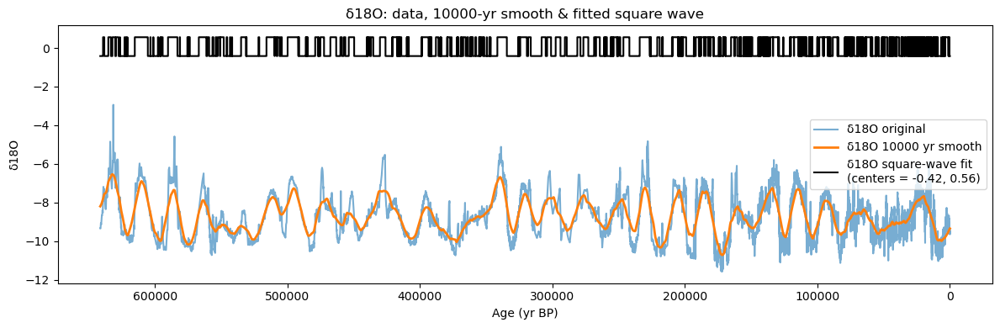

In [63]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# 0) Load raw data
df_ch4 = pd.read_excel('other_data/CH4_AICC2023.xlsx', sheet_name='Sheet1')
file_path = r"D:\VScode\bipolar_seesaw_CCM\other_data\monsoon.xlsx"
df_d18O = pd.read_excel(file_path)
df_d18O['age'] *= 1000  # to yrs BP

# 1) Build common 10-yr age grid over their overlap
age_min = max(df_ch4['age'].min(), df_d18O['age'].min())
age_max = min(df_ch4['age'].max(), df_d18O['age'].max())
ages = np.arange(age_min, age_max + 1, 10)

# 2) Interpolate each onto that grid
ch4 = np.interp(ages, df_ch4['age'], df_ch4['ch4'])
d18O = np.interp(ages, df_d18O['age'], df_d18O['d18O'])

print(ch4.shape)
print(d18O.shape)


import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans


# wrap in Series with age index
ser_ch4  = pd.Series(ch4,  index=ages)
ser_d18O = pd.Series(d18O, index=ages)

# smoothing window in points = 10 000 yr / 10 yr per sample
window_pts = int(10000 / 10)

# 1) compute centered moving‐average smooth
smooth_ch4  = ser_ch4.rolling(window=window_pts, center=True, min_periods=1).mean()
smooth_d18O = ser_d18O.rolling(window=window_pts, center=True, min_periods=1).mean()

# 2) residual = original − smooth
resid_ch4  = ser_ch4  - smooth_ch4
resid_d18O = ser_d18O - smooth_d18O

def fit_square(resid):
    """
    Fit an irregular square wave to a residual by 
    2-cluster k-means on its values.
    Returns the fitted step‐function (cluster centers) and labels.
    """
    # reshape for sklearn
    X = resid.values.reshape(-1,1)
    km = KMeans(n_clusters=2, random_state=0).fit(X)
    centers = km.cluster_centers_.flatten()
    labels  = km.labels_
    # ensure center[0] < center[1]
    if centers[0] > centers[1]:
        centers = centers[::-1]
        labels  = 1 - labels
    # build fitted wave
    fit = np.where(labels==1, centers[1], centers[0])
    return fit, labels, centers

# 3) fit square to each residual
fit_ch4,  lbl_ch4,  cen_ch4  = fit_square(resid_ch4)
fit_d18O, lbl_d18O, cen_d18O = fit_square(resid_d18O)

# 4) plotting
for name, orig, smooth, resid, fit, cen in [
    ('CH4',  ser_ch4,  smooth_ch4,  resid_ch4,  fit_ch4,  cen_ch4),
    ('δ18O', ser_d18O, smooth_d18O, resid_d18O, fit_d18O, cen_d18O),
]:
    plt.figure(figsize=(12,4))
    plt.plot(orig.index, orig.values,    label=f'{name} original', alpha=0.6)
    plt.plot(smooth.index, smooth.values, label=f'{name} {window_pts*10:d} yr smooth', lw=2)
    plt.step(orig.index, fit, where='mid',
             label=f'{name} square‐wave fit\n(centers = {cen[0]:.2f}, {cen[1]:.2f})',
             color='k', lw=1.5)
    plt.gca().invert_xaxis()  # if age is yrs BP
    plt.xlabel('Age (yr BP)')
    plt.ylabel(name)
    plt.title(f'{name}: data, {window_pts*10:d}-yr smooth & fitted square wave')
    plt.legend(loc='best')
    plt.tight_layout()

plt.show()




Best window:     5000 yr
Best thr CH₄:    185.14018983843184
Best thr δ¹⁸O:   0.166685222706914
Max overlap pts: 43644 / 64129


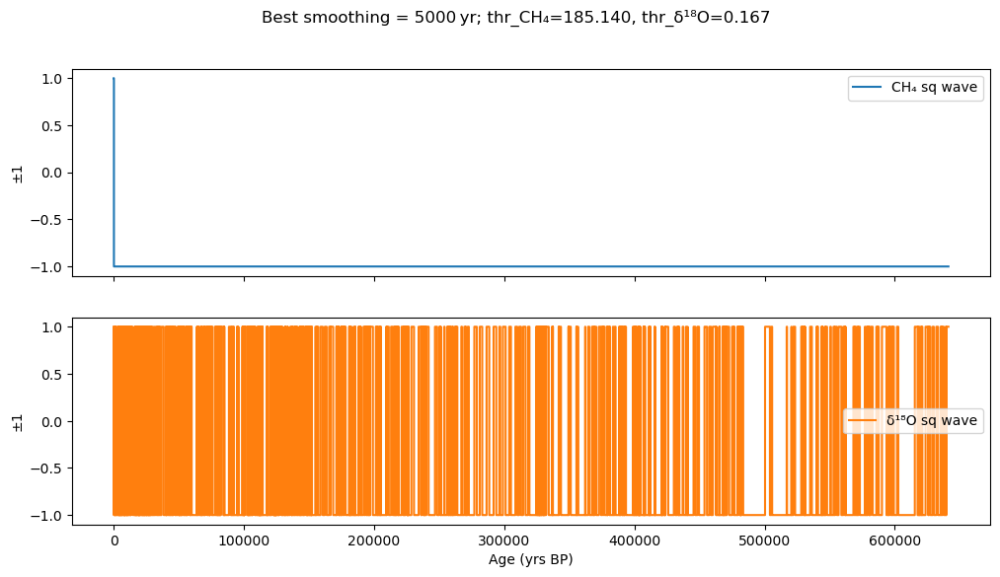

In [59]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# 0) Load raw data
df_ch4 = pd.read_excel('other_data/CH4_AICC2023.xlsx', sheet_name='Sheet1')
file_path = r"D:\VScode\bipolar_seesaw_CCM\other_data\monsoon.xlsx"
df_d18O = pd.read_excel(file_path)
df_d18O['age'] *= 1000  # to yrs BP

# 1) Build common 10-yr age grid over their overlap
age_min = max(df_ch4['age'].min(), df_d18O['age'].min())
age_max = min(df_ch4['age'].max(), df_d18O['age'].max())
ages = np.arange(age_min, age_max + 1, 10)

# 2) Interpolate each onto that grid
ch4 = np.interp(ages, df_ch4['age'], df_ch4['ch4'])
d18O = np.interp(ages, df_d18O['age'], df_d18O['d18O'])

# 3) Prepare search
def square_wave(resid, thr):
    # above→+1, below→−1
    return np.where(resid > thr, 1, -1)

best = {'window': None, 'thr_ch4': None, 'thr_d18O': None, 'overlap': -1}

# loop windows
for win_yr in range(5000, 50001, 1000):
    n = int(win_yr / 10)  # window length in samples
    
    # compute rolling‐mean smoothed signals
    ch4_smooth = pd.Series(ch4).rolling(window=n, center=True, min_periods=1).mean().values
    d_smooth  = pd.Series(-d18O).rolling(window=n, center=True, min_periods=1).mean().values
    
    # residuals
    ch4_res = ch4 - ch4_smooth
    d_res   = -d18O - d_smooth
    
    # threshold grids (101 steps)
    thr1_cands = np.linspace(ch4_res.min()+0.4*(ch4_res.max()-ch4_res.min()), ch4_res.max()-0.4*(ch4_res.max()-ch4_res.min()), 11)
    thr2_cands = np.linspace(d_res.min()+0.4*(d_res.max()-d_res.min()),   d_res.max()-0.4*(d_res.max()-d_res.min()),   11)
    
    # loop thresholds
    for thr1 in thr1_cands:
        sq1 = square_wave(ch4_res, thr1)
        for thr2 in thr2_cands:
            sq2 = square_wave(d_res, thr2)
            overlap = np.sum(sq1 == sq2)
            if overlap > best['overlap']:
                best.update(window=win_yr,
                            thr_ch4=thr1,
                            thr_d18O=thr2,
                            overlap=overlap)

print("Best window:    ", best['window'], "yr")
print("Best thr CH₄:   ", best['thr_ch4'])
print("Best thr δ¹⁸O:  ", best['thr_d18O'])
print("Max overlap pts:", best['overlap'], "/", len(ages))

# 4) Recompute square waves at optimum
n_best = int(best['window']/10)
ch4_res_best = ch4 - pd.Series(ch4).rolling(n_best, center=True, min_periods=1).mean()
d_res_best   = -d18O - pd.Series(-d18O).rolling(n_best, center=True, min_periods=1).mean()

sq_ch4  = square_wave(ch4_res_best, best['thr_ch4'])
sq_d18O = square_wave(d_res_best,   best['thr_d18O'])

# 5) Visualize
fig, ax = plt.subplots(2,1, figsize=(12, 6), sharex=True)

ax[0].plot(ages, sq_ch4, drawstyle='steps-post', label='CH₄ sq wave')
ax[0].set_ylabel('±1')
ax[0].legend()

ax[1].plot(ages, sq_d18O, drawstyle='steps-post', color='C1', label='δ¹⁸O sq wave')
ax[1].set_ylabel('±1')
ax[1].legend()

ax[1].set_xlabel('Age (yrs BP)')
plt.suptitle(f"Best smoothing = {best['window']} yr; thr_CH₄={best['thr_ch4']:.3f}, thr_δ¹⁸O={best['thr_d18O']:.3f}")
plt.show()


▶ Best cutoff=120000 yr, threshold gt -0.301, max F1=0.747


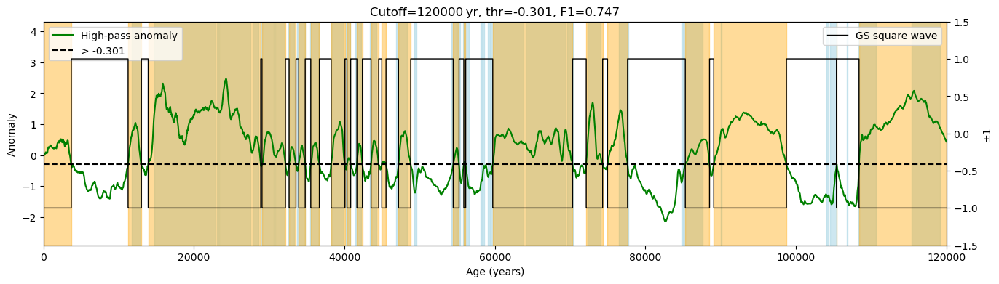

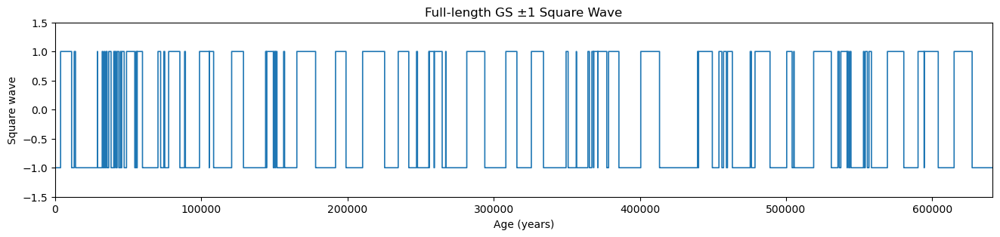

In [51]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.signal import butter, filtfilt
from scipy.interpolate import interp1d
from itertools import groupby

# --- 0) Load & resample your data (modify path as needed) ---
file_path = r"D:\VScode\bipolar_seesaw_CCM\other_data\monsoon.xlsx"
df_raw = pd.read_excel(file_path)
df_raw['age'] = df_raw['age'] * 1000  # convert to years BP
new_age = np.arange(0, 641260, 10)
f_interp = interp1d(df_raw['age'], df_raw['d18O'], kind='nearest',
                    bounds_error=False, fill_value=df_raw['d18O'].mean())
new_df = pd.DataFrame({'age': new_age, 'd18O': f_interp(new_age)})

ages  = new_df['age'].values
values = new_df['d18O'].values

# --- 1) GS ground-truth mask for ages <120kyr ---
gs_data = {
    "start": [11703, 14692, 23020, 23340, 27780, 28900, 30840, 32500, 33740, 35480,
              38220, 40160, 41460, 43340, 46860, 49280, 54220, 55000, 55800, 58040,
              58280, 59080, 59440, 64100, 69620, 72340, 76440, 84760, 85060, 90040,
              104040,104520,106750,108280,115370],
    "end":   [12896, 22900, 23220, 27540, 28600, 30600, 32040, 33360, 34740, 36580,
              39900, 40800, 42240, 44280, 48340, 49600, 54900, 55400, 56500, 58160,
              58560, 59300, 63840, 69400, 70380, 74100, 77760, 84960, 87600, 90140,
              104380,105440,106900,110640,119140]
}
mask_true = np.zeros_like(ages, dtype=bool)
for s, e in zip(gs_data["start"], gs_data["end"]):
    mask_true |= (ages >= s) & (ages <= e)
mask_true_crop = mask_true & (ages < 120_000)

# --- F1 helper ---
def f1_score(pred, true):
    tp = np.sum(pred & true)
    fp = np.sum(pred & ~true)
    fn = np.sum(~pred & true)
    return 2*tp/(2*tp + fp + fn) if (2*tp + fp + fn) > 0 else 0

# --- 2) Grid-search over cutoff, threshold, and direction ---
cutoff_range = np.arange(8000, 130001, 1000)
best = {'cutoff': None, 'thr': None, 'dir': None, 'f1': -1}

fs  = 1/10.0    # sampling rate = 1 sample per 10 yrs
nyq = fs/2.0

window_size = 50
window = np.ones(window_size) / window_size

for cutoff in cutoff_range:
    # design and apply high-pass filter
    fc = 1.0 / cutoff
    Wn = fc / nyq
    b, a = butter(4, Wn, btype='high')
    filtered = filtfilt(b, a, values)

    # smooth the filtered data with a moving average with window size of 50

    filtered = np.convolve(filtered, window, mode='same')
    
    # crop for scoring
    filt_crop = filtered[ages < 120_000]
    true_crop = mask_true_crop[ages < 120_000]
    
    # threshold candidates
    thr_cands = np.linspace(filt_crop.min(), filt_crop.max(), 101)
    
    for direction in ('gt', 'lt'):
        for thr in thr_cands:
            pred = filt_crop > thr if direction=='gt' else filt_crop < thr
            score = f1_score(pred, true_crop)
            if score > best['f1']:
                best.update(cutoff=cutoff, thr=thr, dir=direction, f1=score)

print(f"▶ Best cutoff={best['cutoff']} yr, "
      f"threshold {best['dir']} {best['thr']:.3f}, "
      f"max F1={best['f1']:.3f}")

# --- 3) Final classification over full record ---
fc = 1.0 / best['cutoff']
Wn = fc / nyq
b, a = butter(4, Wn, btype='high')
filtered_full = filtfilt(b, a, values)
filtered_full = np.convolve(filtered_full, window, mode='same')

is_gs = filtered_full > best['thr'] if best['dir']=='gt' else filtered_full < best['thr']
square_wave = np.where(is_gs, -1, 1)

# extract predicted GS spans
segments = []
for val, grp in groupby(enumerate(is_gs), key=lambda x: x[1]):
    if val:
        idxs = [i for i, _ in grp]
        segments.append((ages[idxs[0]], ages[idxs[-1]]))

# --- 4) Visualization of anomaly + spans + square-wave inset ---
fig, ax = plt.subplots(figsize=(16, 4))
# official GS spans
for s, e in zip(gs_data["start"], gs_data["end"]):
    ax.axvspan(s, e, color='lightblue', alpha=0.6, zorder=0)
# predicted GS spans
for s, e in segments:
    ax.axvspan(s, e, color='orange', alpha=0.4, zorder=1)
# anomaly curve
ax.plot(ages, filtered_full, color='green', label='High-pass anomaly')
# threshold line
ax.axhline(best['thr'], linestyle='--', color='black',
           label=f"{'>' if best['dir']=='gt' else '<'} {best['thr']:.3f}")
# inset square wave
ax2 = ax.twinx()
ax2.plot(ages, square_wave, drawstyle='steps-post',
         color='black', linewidth=1, label='GS square wave')
ax2.set_ylim(-1.5, 1.5)
ax2.set_ylabel('±1')

ax.invert_xaxis()
ax.set_xlim(0, 120_000)
ax.set_xlabel('Age (years)')
ax.set_ylabel('Anomaly')
ax.set_title(f"Cutoff={best['cutoff']} yr, thr={best['thr']:.3f}, F1={best['f1']:.3f}")
ax.legend(loc='upper left')
ax2.legend(loc='upper right')
plt.show()

# --- 5) Full-length square wave (±1) plot ---
fig, ax = plt.subplots(figsize=(16, 3))
ax.plot(ages, square_wave, drawstyle='steps-post', linewidth=1.2)
ax.set_xlim(ages.min(), ages.max())
ax.set_ylim(-1.5, 1.5)
ax.set_xlabel('Age (years)')
ax.set_ylabel('Square wave')
ax.set_title('Full-length GS ±1 Square Wave')
plt.show()


▶ Best cutoff=11000 yr, threshold lt 7.628, max F1=0.716


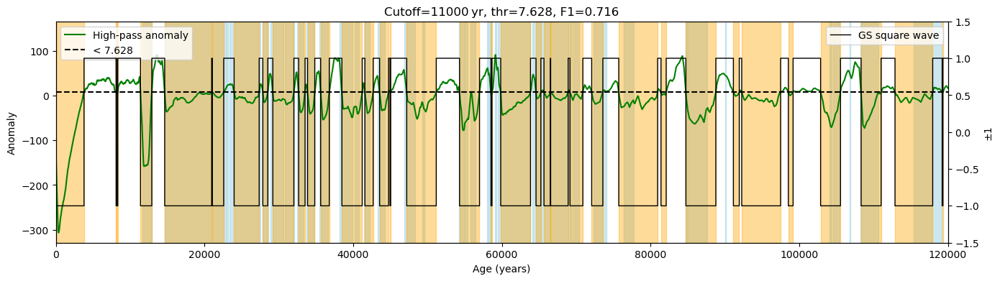

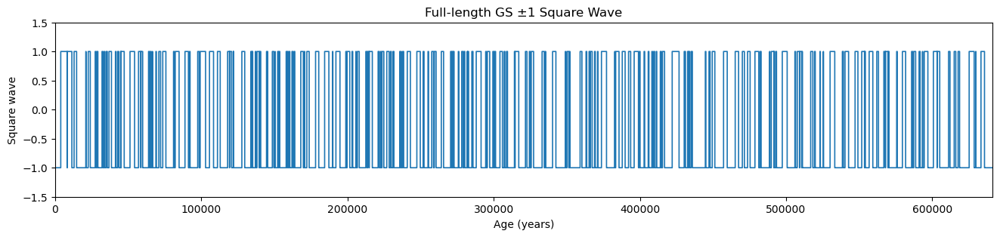

In [53]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.signal import butter, filtfilt
from scipy.interpolate import interp1d
from itertools import groupby


df_raw = pd.read_excel('other_data/CH4_AICC2023.xlsx', sheet_name='Sheet1')
# rename the second column to 'd18O'
df_raw.rename(columns={df_raw.columns[1]: 'd18O'}, inplace=True)

# # --- 0) Load & resample your data (modify path as needed) ---
# file_path = r"D:\VScode\bipolar_seesaw_CCM\other_data\monsoon.xlsx"
# df_raw = pd.read_excel(file_path)
# df_raw['age'] = df_raw['age'] * 1000  # convert to years BP


new_age = np.arange(0, 641260, 10)
f_interp = interp1d(df_raw['age'], df_raw['d18O'], kind='nearest',
                    bounds_error=False, fill_value=df_raw['d18O'].mean())
new_df = pd.DataFrame({'age': new_age, 'd18O': f_interp(new_age)})

ages  = new_df['age'].values
values = new_df['d18O'].values

# --- 1) GS ground-truth mask for ages <120kyr ---
gs_data = {
    "start": [11703, 14692, 23020, 23340, 27780, 28900, 30840, 32500, 33740, 35480,
              38220, 40160, 41460, 43340, 46860, 49280, 54220, 55000, 55800, 58040,
              58280, 59080, 59440, 64100, 69620, 72340, 76440, 84760, 85060, 90040,
              104040,104520,106750,108280,115370],
    "end":   [12896, 22900, 23220, 27540, 28600, 30600, 32040, 33360, 34740, 36580,
              39900, 40800, 42240, 44280, 48340, 49600, 54900, 55400, 56500, 58160,
              58560, 59300, 63840, 69400, 70380, 74100, 77760, 84960, 87600, 90140,
              104380,105440,106900,110640,119140]
}
mask_true = np.zeros_like(ages, dtype=bool)
for s, e in zip(gs_data["start"], gs_data["end"]):
    mask_true |= (ages >= s) & (ages <= e)
mask_true_crop = mask_true & (ages < 120_000)

# --- F1 helper ---
def f1_score(pred, true):
    tp = np.sum(pred & true)
    fp = np.sum(pred & ~true)
    fn = np.sum(~pred & true)
    return 2*tp/(2*tp + fp + fn) if (2*tp + fp + fn) > 0 else 0

# --- 2) Grid-search over cutoff, threshold, and direction ---
cutoff_range = np.arange(8000, 130001, 1000)
best = {'cutoff': None, 'thr': None, 'dir': None, 'f1': -1}

fs  = 1/10.0    # sampling rate = 1 sample per 10 yrs
nyq = fs/2.0

window_size = 50
window = np.ones(window_size) / window_size

for cutoff in cutoff_range:
    # design and apply high-pass filter
    fc = 1.0 / cutoff
    Wn = fc / nyq
    b, a = butter(4, Wn, btype='high')
    filtered = filtfilt(b, a, values)

    # smooth the filtered data with a moving average with window size of 50

    filtered = np.convolve(filtered, window, mode='same')
    
    # crop for scoring
    filt_crop = filtered[ages < 120_000]
    true_crop = mask_true_crop[ages < 120_000]
    
    # threshold candidates
    thr_cands = np.linspace(filt_crop.min(), filt_crop.max(), 101)
    
    for direction in ('gt', 'lt'):
        for thr in thr_cands:
            pred = filt_crop > thr if direction=='gt' else filt_crop < thr
            score = f1_score(pred, true_crop)
            if score > best['f1']:
                best.update(cutoff=cutoff, thr=thr, dir=direction, f1=score)

print(f"▶ Best cutoff={best['cutoff']} yr, "
      f"threshold {best['dir']} {best['thr']:.3f}, "
      f"max F1={best['f1']:.3f}")

# --- 3) Final classification over full record ---
fc = 1.0 / best['cutoff']
Wn = fc / nyq
b, a = butter(4, Wn, btype='high')
filtered_full = filtfilt(b, a, values)
filtered_full = np.convolve(filtered_full, window, mode='same')

is_gs = filtered_full > best['thr'] if best['dir']=='gt' else filtered_full < best['thr']
square_wave = np.where(is_gs, -1, 1)

# extract predicted GS spans
segments = []
for val, grp in groupby(enumerate(is_gs), key=lambda x: x[1]):
    if val:
        idxs = [i for i, _ in grp]
        segments.append((ages[idxs[0]], ages[idxs[-1]]))

# --- 4) Visualization of anomaly + spans + square-wave inset ---
fig, ax = plt.subplots(figsize=(16, 4))
# official GS spans
for s, e in zip(gs_data["start"], gs_data["end"]):
    ax.axvspan(s, e, color='lightblue', alpha=0.6, zorder=0)
# predicted GS spans
for s, e in segments:
    ax.axvspan(s, e, color='orange', alpha=0.4, zorder=1)
# anomaly curve
ax.plot(ages, filtered_full, color='green', label='High-pass anomaly')
# threshold line
ax.axhline(best['thr'], linestyle='--', color='black',
           label=f"{'>' if best['dir']=='gt' else '<'} {best['thr']:.3f}")
# inset square wave
ax2 = ax.twinx()
ax2.plot(ages, square_wave, drawstyle='steps-post',
         color='black', linewidth=1, label='GS square wave')
ax2.set_ylim(-1.5, 1.5)
ax2.set_ylabel('±1')

ax.invert_xaxis()
ax.set_xlim(0, 120_000)
ax.set_xlabel('Age (years)')
ax.set_ylabel('Anomaly')
ax.set_title(f"Cutoff={best['cutoff']} yr, thr={best['thr']:.3f}, F1={best['f1']:.3f}")
ax.legend(loc='upper left')
ax2.legend(loc='upper right')
plt.show()

# --- 5) Full-length square wave (±1) plot ---
fig, ax = plt.subplots(figsize=(16, 3))
ax.plot(ages, square_wave, drawstyle='steps-post', linewidth=1.2)
ax.set_xlim(ages.min(), ages.max())
ax.set_ylim(-1.5, 1.5)
ax.set_xlabel('Age (years)')
ax.set_ylabel('Square wave')
ax.set_title('Full-length GS ±1 Square Wave')
plt.show()

Window 500 → min=-1.444, max=1.736
Window 600 → min=-1.396, max=1.739
Window 700 → min=-1.329, max=1.660
Window 800 → min=-1.355, max=1.630
Window 900 → min=-1.374, max=1.617
Window 1000 → min=-1.393, max=1.712
Window 1100 → min=-1.425, max=1.789
Window 1200 → min=-1.502, max=1.882
Window 1300 → min=-1.592, max=1.949
Window 1400 → min=-1.661, max=1.984
Window 1500 → min=-1.730, max=1.978
Window 1600 → min=-1.773, max=1.965
Window 1700 → min=-1.811, max=1.943
Window 1800 → min=-1.861, max=1.925
Window 1900 → min=-1.910, max=1.962
Window 2000 → min=-1.993, max=2.029
Window 2100 → min=-2.062, max=2.077
Window 2200 → min=-2.088, max=2.151
Window 2300 → min=-2.112, max=2.218
Window 2400 → min=-2.125, max=2.277
Window 2500 → min=-2.138, max=2.340
Window 2600 → min=-2.159, max=2.391
Window 2700 → min=-2.189, max=2.408
Window 2800 → min=-2.205, max=2.404
Window 2900 → min=-2.225, max=2.400
Window 3000 → min=-2.251, max=2.393
Window 3100 → min=-2.262, max=2.373
Window 3200 → min=-2.267, max=2.3

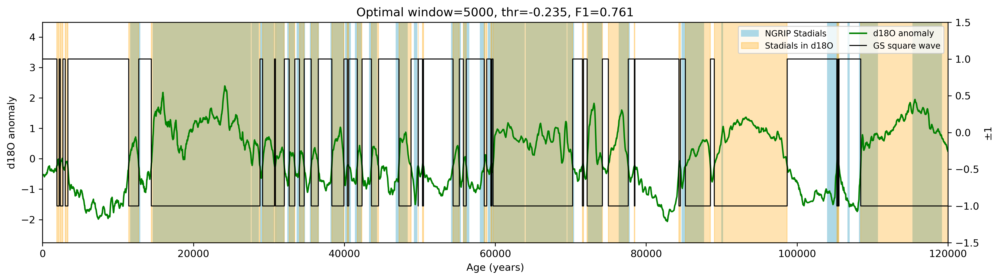

Window 500 → min=-145.234, max=149.089
Window 600 → min=-141.462, max=159.995
Window 700 → min=-133.873, max=169.001
Window 800 → min=-126.565, max=175.671
Window 900 → min=-119.683, max=181.899
Window 1000 → min=-113.346, max=187.454
Window 1100 → min=-106.975, max=192.397
Window 1200 → min=-100.344, max=195.386
Window 1300 → min=-94.176, max=196.880
Window 1400 → min=-88.539, max=197.034
Window 1500 → min=-83.262, max=196.477
Window 1600 → min=-78.743, max=195.823
Window 1700 → min=-80.477, max=194.586
Window 1800 → min=-83.901, max=191.825
Window 1900 → min=-87.044, max=188.863
Window 2000 → min=-89.649, max=185.861
Window 2100 → min=-91.861, max=182.937
Window 2200 → min=-94.506, max=180.730
Window 2300 → min=-95.927, max=179.591
Window 2400 → min=-96.960, max=185.967
Window 2500 → min=-97.782, max=192.384
Window 2600 → min=-98.290, max=193.428
Window 2700 → min=-98.822, max=192.166
Window 2800 → min=-100.034, max=191.706
Window 2900 → min=-101.687, max=192.454
Window 3000 → min=-1

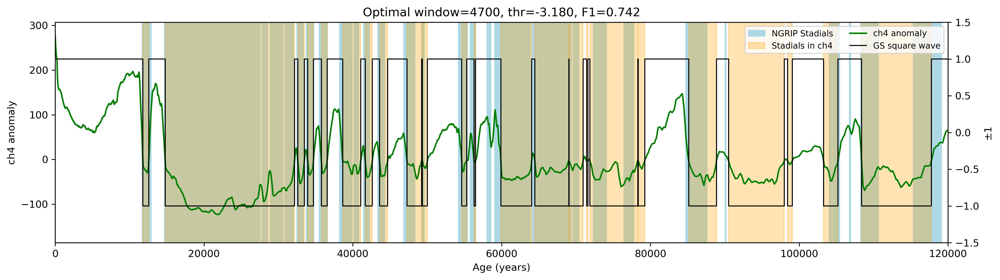

In [54]:
from toolbox import sq_ana as sa 
import importlib
importlib.reload(sa)
import pandas as pd

df_ch4 = pd.read_excel('other_data/CH4_AICC2023.xlsx', sheet_name='Sheet1')

file_path = r"D:\VScode\bipolar_seesaw_CCM\other_data\monsoon.xlsx"
df_d18O = pd.read_excel(file_path)
df_d18O['age'] = df_d18O['age'] * 1000

new_df_d18O, df_sq_d18O, best_d18O = sa.build_DO_sq(df_d18O,  extra_sm=30, if_plot=True, dir='gt',metrics='F1')


new_df_ch4, df_sq_ch4, best_ch4 = sa.build_DO_sq(df_ch4, if_plot=True, age_start=0, age_end=799630, extra_sm=50, dir='lt')



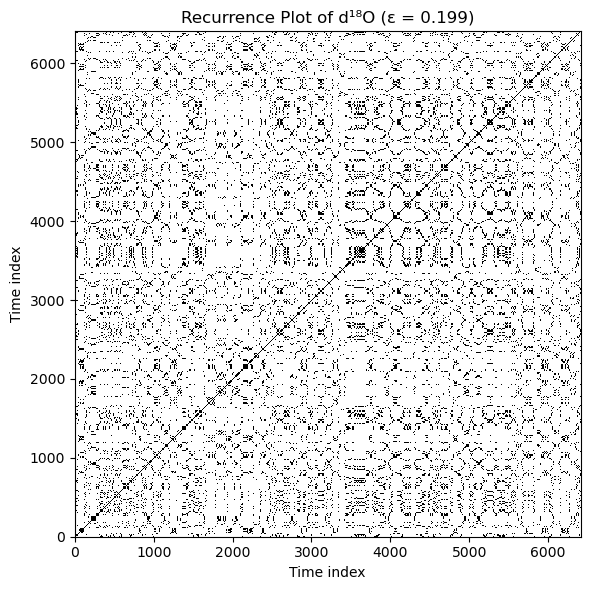

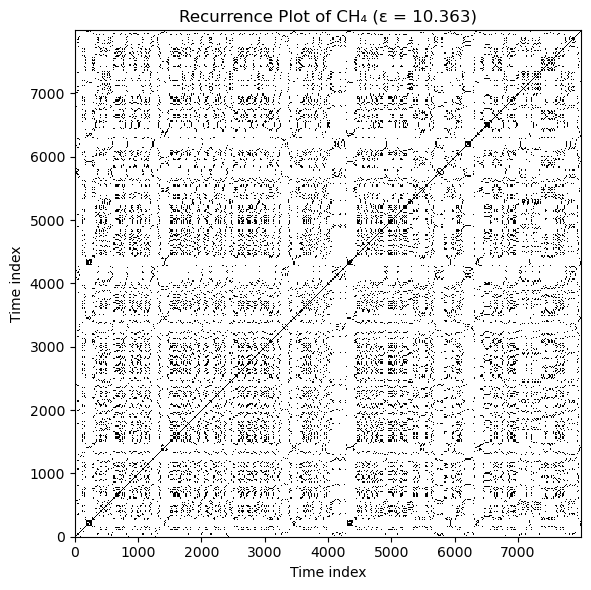

In [31]:
import numpy as np
import matplotlib.pyplot as plt

# for the two dfs, only keep one data point for each 10 data points
new_df_d18O = new_df_d18O.iloc[::10, :]
new_df_ch4 = new_df_ch4.iloc[::10, :]

def recurrence_plot(ts, eps):
    """
    Compute the recurrence matrix for time series ts:
      R[i,j] = 1 if |ts[i] - ts[j]| < eps, else 0
    """
    # pairwise absolute differences
    D = np.abs(ts[:, None] - ts[None, :])
    return (D < eps).astype(int)

# --- d18O series ---
y = new_df_d18O['d18O'].values
# choose epsilon as, say, the 10th percentile of distances
eps = np.percentile(np.abs(y[:,None] - y[None,:]), 10)

R = recurrence_plot(y, eps)
plt.figure(figsize=(6,6))
plt.imshow(R, origin='lower', cmap='binary', interpolation='nearest')
plt.title('Recurrence Plot of d¹⁸O (ε = {:.3f})'.format(eps))
plt.xlabel('Time index')
plt.ylabel('Time index')
plt.tight_layout()
plt.show()

# --- CH₄ series ---
y2 = new_df_ch4['ch4'].values
eps2 = np.percentile(np.abs(y2[:,None] - y2[None,:]), 10)

R2 = recurrence_plot(y2, eps2)
plt.figure(figsize=(6,6))
plt.imshow(R2, origin='lower', cmap='binary', interpolation='nearest')
plt.title('Recurrence Plot of CH₄ (ε = {:.3f})'.format(eps2))
plt.xlabel('Time index')
plt.ylabel('Time index')
plt.tight_layout()
plt.show()


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


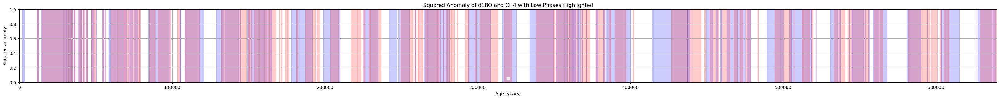

In [ ]:
import matplotlib.pyplot as plt

def get_low_phases(df):
    """
    Return a list of (start_age, end_age) for each contiguous region
    where df['sq'] == -1.
    """
    mask = df['sq'] == -1
    # where a low-phase starts
    starts = df['age'][(~mask.shift(1, fill_value=False)) & mask].values
    # where a low-phase ends
    ends   = df['age'][(mask) & (~mask.shift(-1, fill_value=False))].values
    return list(zip(starts, ends))

plt.figure(figsize=(40, 3))
# plot the two square‐wave series
# plt.plot(df_sq_d18O['age'], df_sq_d18O['sq'], label='d18O', color='blue')
# plt.plot(df_sq_ch4 ['age'], df_sq_ch4 ['sq'], label='CH4', color='red')

# shade low phases for d18O in light blue
for start, end in get_low_phases(df_sq_d18O): 
    plt.axvspan(start, end, color='blue', alpha=0.2)

# shade low phases for CH4 in light red
for start, end in get_low_phases(df_sq_ch4):
    plt.axvspan(start, end, color='red', alpha=0.2)

plt.xlim(0, 640000)
plt.xlabel('Age (years)')
plt.ylabel('Squared anomaly')
plt.title('Squared Anomaly of d18O and CH4 with Low Phases Highlighted')
plt.legend()
plt.grid()
plt.show()


In [ ]:
from toolbox import sq_ana as sa 
import importlib
importlib.reload(sa)

sa.plot_transition_distribution(df_pre, df_sq)

sa.plot_phase_durations(df_pre, df_sq)

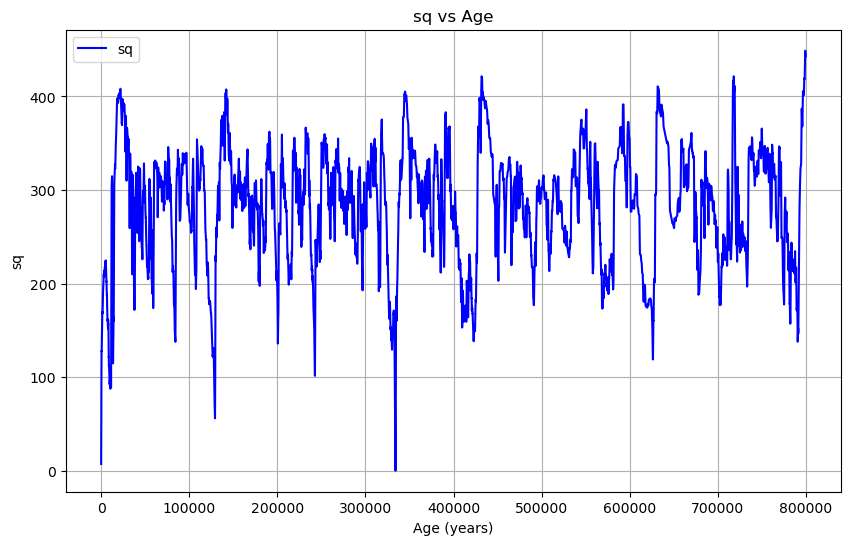

→ optimal window=15000, threshold gt 5.626, max F1=0.743


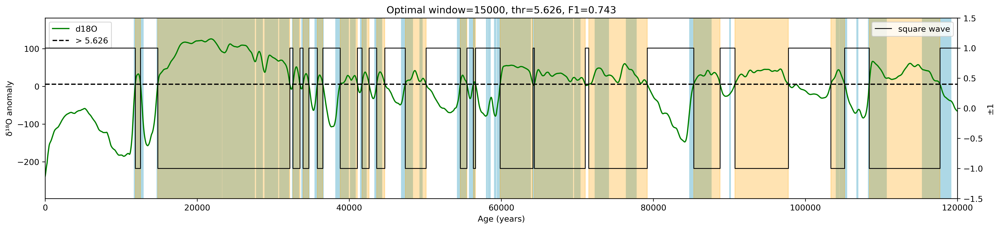

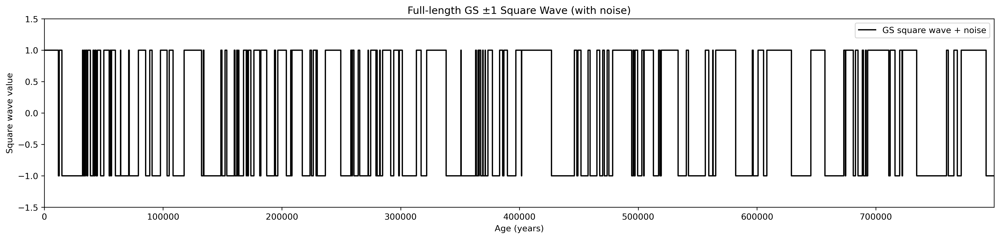

In [27]:
import numpy as np

test_df=new_df_ch4.copy()
test_df['ch4'] = np.max(test_df['ch4'].values) - test_df['ch4'].values

# plot the test_df
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))
plt.plot(test_df['age'], test_df['ch4'], label='sq', color='blue')
plt.xlabel('Age (years)')
plt.ylabel('sq')
plt.title('sq vs Age')
plt.legend()
plt.grid()
plt.show()

# rename column ch4 to d18O
test_df.rename(columns={'ch4': 'd18O'}, inplace=True)

# new_df_test, df_sq_test, best_test = sa.build_DO_sq(test_df, if_plot=True, age_start=0, age_end=799630, extra_sm=5, dir='lt')


import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from itertools import groupby
from scipy.interpolate import interp1d



# --- 1) GS ground-truth table ---
gs_data = {
    "start": [11703, 14692, 23020, 23340, 27780, 28900, 30840, 32500, 33740, 35480,
              38220, 40160, 41460, 43340, 46860, 49280, 54220, 55000, 55800, 58040,
              58280, 59080, 59440, 64100, 69620, 72340, 76440, 84760, 85060, 90040,
              104040,104520,106750,108280,115370],
    "end":   [12896, 22900, 23220, 27540, 28600, 30600, 32040, 33360, 34740, 36580,
              39900, 40800, 42240, 44280, 48340, 49600, 54900, 55400, 56500, 58160,
              58560, 59300, 63840, 69400, 70380, 74100, 77760, 84960, 87600, 90140,
              104380,105440,106900,110640,119140]
}

new_df=test_df.copy()

# make ground truth mask on cropped (<120k yr)
mask_true_full = np.zeros_like(new_df['age'].values, dtype=bool)
for s, e in zip(gs_data["start"], gs_data["end"]):
    mask_true_full |= (new_df['age'] >= s) & (new_df['age'] <= e)

mask_true_crop = mask_true_full & (new_df['age'] < 120_000)

# F1 helper
def f1_score(pred, true):
    tp = np.sum(pred & true)
    fp = np.sum(pred & ~true)
    fn = np.sum(~pred & true)
    return 2*tp/(2*tp + fp + fn) if (2*tp + fp + fn)>0 else 0

# --- 2) grid‐search over window & threshold ---
window_range = np.arange(3_000, 20_001, 1_00)
# thr_cands = np.linspace(-1, 1, 201)  # adjust range if needed


best = {'window':None, 'thr':None, 'dir':None, 'f1':-1}

for w in window_range:
    # low‐freq smoothing & anomaly
    smooth_lo = new_df['d18O'].rolling(window=w, center=True, min_periods=1).mean()
    anomaly = new_df['d18O']  - smooth_lo
    # optional 50-pt smoothing of anomaly
    anomaly_sm = anomaly.rolling(window=50, center=True, min_periods=1).mean()
    
    # crop to <120k for scoring
    vals = anomaly_sm.values[ new_df['age'] < 120_000 ]
    true = mask_true_crop[ new_df['age'] < 120_000 ]


    thr_min = vals.min()
    thr_max = vals.max()
    step    = (thr_max - thr_min) / 100.0
    thr_cands = np.linspace(thr_min, thr_max, 101)
    
    # scan threshold & direction
    for direction in ('gt','lt'):
        for thr in thr_cands:
            pred = (vals > thr) if direction=='gt' else (vals < thr)
            score = f1_score(pred, true)
            if score > best['f1']:
                best.update(window=w, thr=thr, dir=direction, f1=score)

print(f"→ optimal window={best['window']}, "
      f"threshold {best['dir']} {best['thr']:.3f}, "
      f"max F1={best['f1']:.3f}")

# --- 3) build final square wave over full record ---
lo = new_df['d18O'].rolling(window=best['window'],
                            center=True, min_periods=1).mean()
anom = new_df['d18O'] - lo
anom_sm = anom.rolling(window=50, center=True, min_periods=1).mean().values

if best['dir']=='gt':
    is_gs_pred = anom_sm > best['thr']
else:
    is_gs_pred = anom_sm < best['thr']

square_wave = np.where(is_gs_pred, -1, 1)

# --- fix here: build segments safely ---
ages_all = new_df['age'].values
segments = []
for val, grp in groupby(enumerate(is_gs_pred), key=lambda x: x[1]):
    if val:
        grp_list = list(grp)
        start_idx = grp_list[0][0]
        end_idx   = grp_list[-1][0]
        segments.append((ages_all[start_idx], ages_all[end_idx]))


# --- 4) plot final result ---
fig, ax = plt.subplots(figsize=(20,4), dpi=300)

# official GS spans
for s,e in zip(gs_data["start"], gs_data["end"]):
    ax.axvspan(s, e, color='lightblue', alpha=1, zorder=0)
# predicted spans
for s,e in segments:
    ax.axvspan(s, e, color='orange', alpha=0.3, zorder=1)

# δ18O anomaly curve
ax.plot(new_df['age'], anom_sm, color='green', label='d18O')

# threshold line
thr_line = best['thr']
ax.axhline(thr_line, linestyle='--', color='black',
           label=f"{'>' if best['dir']=='gt' else '<'} {thr_line:.3f}")

# square wave inset
ax2 = ax.twinx()
ax2.plot(ages_all, square_wave, drawstyle='steps-post',
         color='black', linewidth=1, label='square wave')
ax2.set_ylim(-1.5,1.5)
ax2.set_ylabel('±1')

ax.invert_xaxis()  # if you want age decreasing left→right
ax.set_xlim(0,120000)
ax.set_xlabel('Age (years)')
ax.set_ylabel('δ¹⁸O anomaly')
ax.set_title(f"Optimal window={best['window']}, thr={best['thr']:.3f}, F1={best['f1']:.3f}")
ax.legend(loc='upper left')
ax2.legend(loc='upper right')

plt.show()



# 2) Recreate df_sq exactly as in your original code
df_sq = pd.DataFrame({'age': ages_all, 'sq': square_wave})
white_noise = np.random.normal(0, 0.1, len(square_wave))
df_sq['sq'] = df_sq['sq'] #+ white_noise

# 3) Plot full‐length noisy square wave
fig, ax = plt.subplots(figsize=(20, 4), dpi=300)
ax.plot(df_sq['age'],
        df_sq['sq'],
        drawstyle='steps-post',
        color='black',
        linewidth=1.5,
        label='GS square wave + noise')
ax.set_ylim(min(square_wave) - 0.5, max(square_wave) + 0.5)
ax.set_xlim(df_sq['age'].min(), df_sq['age'].max())  # 0 → 641260
ax.set_xlabel('Age (years)')
ax.set_ylabel('Square wave value')
ax.set_title('Full‐length GS ±1 Square Wave (with noise)')
ax.legend(loc='upper right')
plt.show()


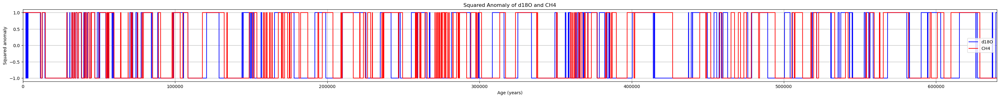

In [10]:
# plot the df_sq_d18O and df_sq_ch4
import matplotlib.pyplot as plt

plt.figure(figsize=(40, 3))
plt.plot(df_sq_d18O['age'], df_sq_d18O['sq'], label='d18O', color='blue')
plt.plot(df_sq_ch4['age'], df_sq_ch4['sq'], label='CH4', color='red')
# set the x-axis limits
plt.xlim(0, 640000)
plt.xlabel('Age (years)')
plt.ylabel('Squared anomaly')
plt.title('Squared Anomaly of d18O and CH4')
plt.legend()
plt.grid()
plt.show()

In [13]:
import numpy as np

x = df_sq_d18O['sq'].values
y = df_sq_ch4['sq'].values

r = np.corrcoef(x, y)[0,1]
print(f"Pearson r = {r:.3f}")


Pearson r = 0.295


In [14]:
# fraction of samples exactly equal
agree_frac = np.mean(x == y)
print(f"Fraction of points equal = {agree_frac:.3f}")

# Jaccard index of the “1”‐regions
jaccard = np.logical_and(x==1, y==1).sum() / np.logical_or(x==1, y==1).sum()
print(f"Jaccard (overlap of highs) = {jaccard:.3f}")


Fraction of points equal = 0.652
Jaccard (overlap of highs) = 0.437


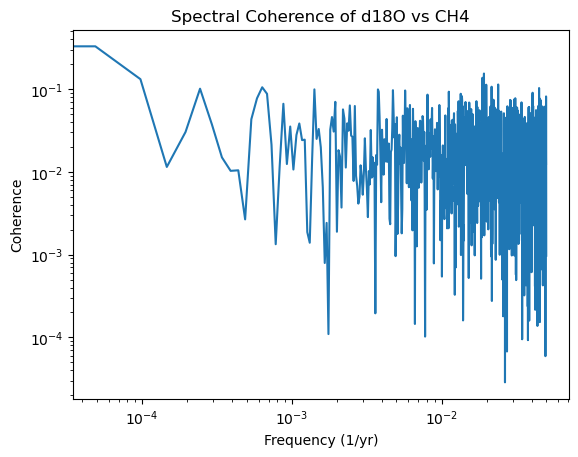

In [15]:
from scipy.signal import coherence

# sampling frequency = 1 sample per 10 yr
fs = 1/(10.0)  
f, Cxy = coherence(x, y, fs=fs, nperseg=2048)

import matplotlib.pyplot as plt
plt.loglog(f, Cxy)
plt.xlabel('Frequency (1/yr)')
plt.ylabel('Coherence')
plt.title('Spectral Coherence of d18O vs CH4')
plt.show()


Text(0.5, 0, 'd18O squared anomaly')

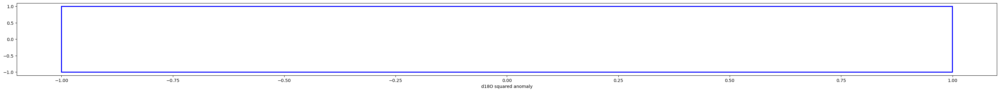

In [12]:
# crop the two df between 0 and 640000
df_sq_d18O = df_sq_d18O[(df_sq_d18O['age'] >= 0) & (df_sq_d18O['age'] <= 640000)]
df_sq_ch4 = df_sq_ch4[(df_sq_ch4['age'] >= 0) & (df_sq_ch4['age'] <= 640000)]

# plot the df_sq_d18O and df_sq_ch4 agast each other
plt.figure(figsize=(40, 3))
plt.plot(df_sq_d18O['sq'], df_sq_ch4['sq'], label='d18O vs CH4', color='blue')
plt.xlabel('d18O squared anomaly')

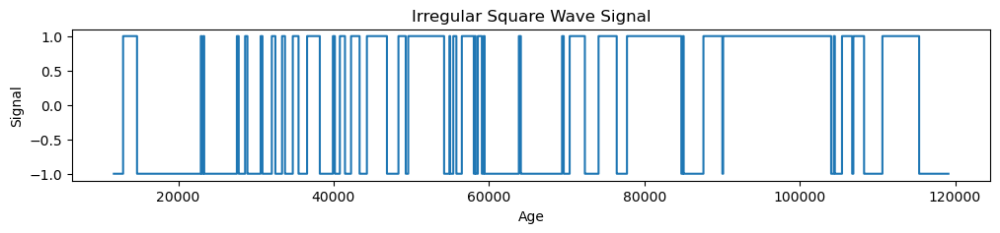

In [13]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# Given ground truth intervals for the low phase (-1)
gs_data = {
    "start": [11703, 14692, 23020, 23340, 27780, 28900, 30840, 32500, 33740, 35480,
              38220, 40160, 41460, 43340, 46860, 49280, 54220, 55000, 55800, 58040,
              58280, 59080, 59440, 64100, 69620, 72340, 76440, 84760, 85060, 90040,
              104040,104520,106750,108280,115370],
    "end":   [12896, 22900, 23220, 27540, 28600, 30600, 32040, 33360, 34740, 36580,
              39900, 40800, 42240, 44280, 48340, 49600, 54900, 55400, 56500, 58160,
              58560, 59300, 63840, 69400, 70380, 74100, 77760, 84960, 87600, 90140,
              104380,105440,106900,110640,119140]
}

# Create an age vector (baseline resolution e.g. every 10 years)
ages = np.arange(11703, 119140, 1)

# Initialize signal at +1
signal = np.ones_like(ages)

# Flip to -1 during the specified low-phase intervals
for start, end in zip(gs_data["start"], gs_data["end"]):
    mask = (ages >= start) & (ages <= end)
    signal[mask] = -1

# Build a DataFrame for clarity
df_sq = pd.DataFrame({"age": ages, "sq": signal})

# Plot the irregular square wave
plt.figure(figsize=(12, 2))
plt.step(df_sq["age"], df_sq["sq"], where="post")
plt.xlabel("Age")
plt.ylabel("Signal")
plt.title("Irregular Square Wave Signal")
plt.show()


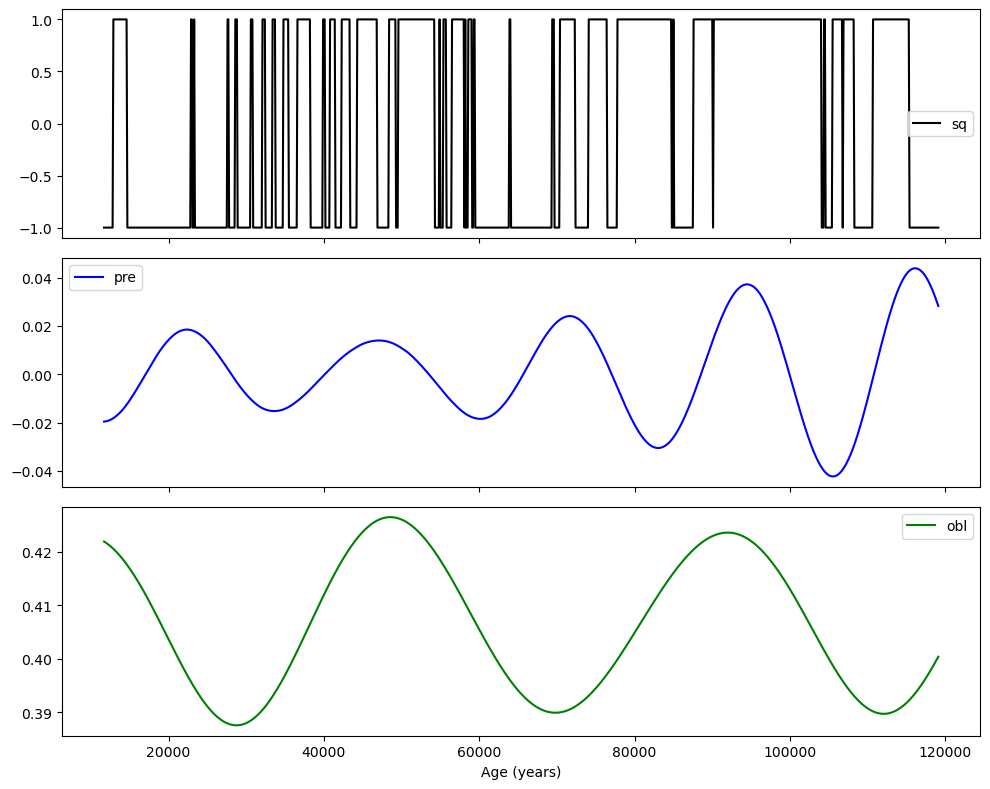

         age   sq
0      11703 -1.0
1      11803 -1.0
2      11903 -1.0
3      12003 -1.0
4      12103 -1.0
...      ...  ...
1070  118703 -1.0
1071  118803 -1.0
1072  118903 -1.0
1073  119003 -1.0
1074  119103 -1.0

[1075 rows x 2 columns]
         age       pre
0      11703 -0.019594
1      11803 -0.019558
2      11903 -0.019507
3      12003 -0.019440
4      12103 -0.019359
...      ...       ...
1070  118703  0.031952
1071  118803  0.031067
1072  118903  0.030157
1073  119003  0.029223
1074  119103  0.028265

[1075 rows x 2 columns]
Length of df_sq_rs: 1075


In [14]:
from toolbox import sq_ana as sa 
import importlib
importlib.reload(sa)

df_sq, df_pre, df_obl = sa.interpolate_data_forcing(df_sq, 100, if_plot=True)
print(df_sq)
print(df_pre)
# print the length of df_sq_rs and df_pre_rs
print('Length of df_sq_rs:', len(df_sq))

# Pre to sq

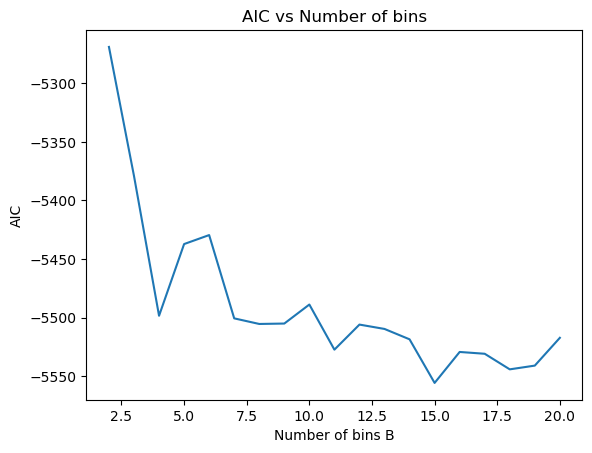

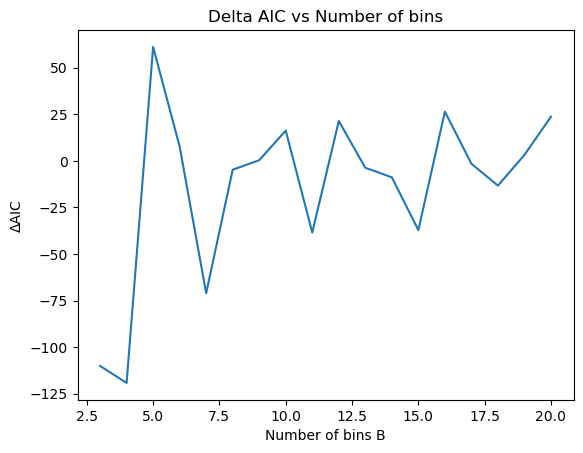

In [4]:
plot_aic_delta(df_pre['pre'].values)

In [17]:
import numpy as np
import matplotlib.pyplot as plt

def plot_joint_prob_colormap(x, y, xbins, ybins):
    # 1) Joint counts
    counts, x_edges, y_edges = np.histogram2d(x, y, bins=[xbins, ybins])

    # 2) Convert to probabilities
    P = counts / counts.sum()  # shape (Bx, By)
    
    # 3) Plot
    fig, ax = plt.subplots()
    # use pcolormesh so axes correspond to the real bin‐edges
    X, Y = np.meshgrid(x_edges, y_edges)
    pcm = ax.pcolormesh(X, Y, P.T, shading='auto')
    fig.colorbar(pcm, ax=ax, label='P(X,Y)')
    
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_title('Joint Probability Distribution')
    plt.show()


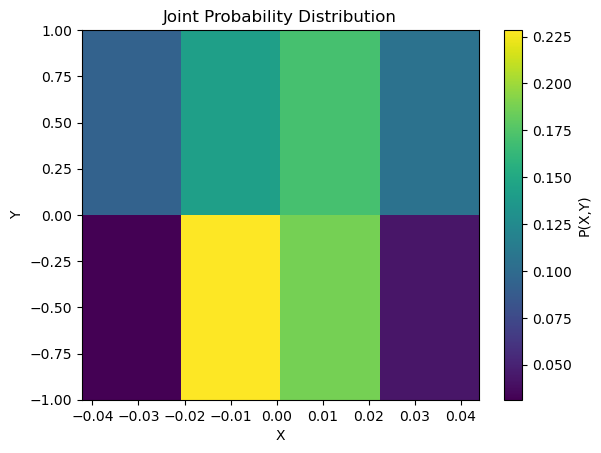

In [18]:
# assuming you've already done:
x = df_pre['pre'].values[::-1]
y = df_sq['sq'].values[::-1]
xbins = np.histogram_bin_edges(x, bins=nbins_x)
ybins = np.histogram_bin_edges(y, bins=nbins_y)

plot_joint_prob_colormap(x, y, xbins, ybins)


Observed TE (X->Y): 0.0010 nats
P-value from surrogate test: 0.0040


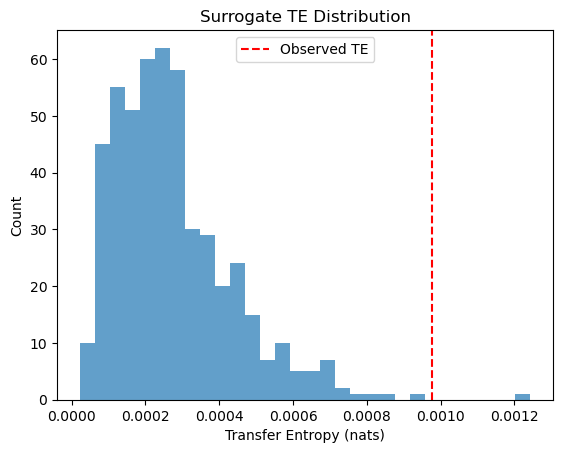

In [63]:
import numpy as np
import matplotlib.pyplot as plt

def compute_transfer_entropy(x, y, xbins, ybins):
    """
    Estimate transfer entropy TE_{X->Y} with 1-lag embedding,
    using binned histograms (edges xbins, ybins).
    Returns TE in nats.
    """
    # Prepare triplets: (X_t, Y_t, Y_{t+1})
    data = np.vstack([x[:-1], y[:-1], y[1:]]).T  # shape (N-1,3)
    
    # Joint histogram counts: shape (Bx, By, By)
    counts = np.histogramdd(data, bins=[xbins, ybins, ybins])[0]
    total = counts.sum()
    p_xyz = counts / total
    
    # Joint distributions:
    # p(x_t, y_t):
    p_xy = counts.sum(axis=2) / total  # shape (Bx, By)
    # p(y_t, y_{t+1}):
    p_yy = counts.sum(axis=0) / total  # shape (By, By)
    # Marginal p(y_t):
    p_y = p_yy.sum(axis=1)             # shape (By,)
    
    # Compute TE = sum p(x,y,y') * log( (p(x,y,y') * p(y)) / (p(x,y)*p(y,y')) )
    TE = 0.0
    Bx, By, _ = counts.shape
    for i in range(Bx):
        for j in range(By):
            for k in range(By):
                pij_k = p_xyz[i, j, k]
                if pij_k > 0 and p_xy[i, j] > 0 and p_yy[j, k] > 0:
                    TE += pij_k * np.log((pij_k * p_y[j]) / (p_xy[i, j] * p_yy[j, k]))
    return TE

def surrogate_significance(x, y, xbins, ybins, n_surrogates=500):
    """
    Permutation test: shuffle X to get surrogate TE distribution.
    Returns observed TE, surrogate TE array, and p-value.
    """
    TE_obs = compute_transfer_entropy(x, y, xbins, ybins)
    TE_surr = np.zeros(n_surrogates)
    for s in range(n_surrogates):
        x_perm = np.random.permutation(x)
        TE_surr[s] = compute_transfer_entropy(x_perm, y, xbins, ybins)
    p_val = (np.sum(TE_surr >= TE_obs) + 1) / (n_surrogates + 1)
    return TE_obs, TE_surr, p_val




x = df_pre['pre'].values      # source (precession)
y = df_sq['sq'].values    # target (residual)

# # flip x and y upside down
x = x[::-1]
y = y[::-1]

nbins_x = 4
nbins_y = 2



xbins = np.histogram_bin_edges(x, bins=nbins_x)
ybins = np.histogram_bin_edges(y, bins=nbins_y)

TE_obs, TE_surr, p_val = surrogate_significance(x, y, xbins, ybins)
print(f"Observed TE (X->Y): {TE_obs:.4f} nats")
print(f"P-value from surrogate test: {p_val:.4f}")

# Plot surrogate distribution
plt.figure()
plt.hist(TE_surr, bins=30, alpha=0.7)
plt.axvline(TE_obs, color='red', linestyle='--', label='Observed TE')
plt.xlabel('Transfer Entropy (nats)')
plt.ylabel('Count')
plt.title('Surrogate TE Distribution')
plt.legend()
plt.show()




TE(pre→residual) = 0.0307 bits


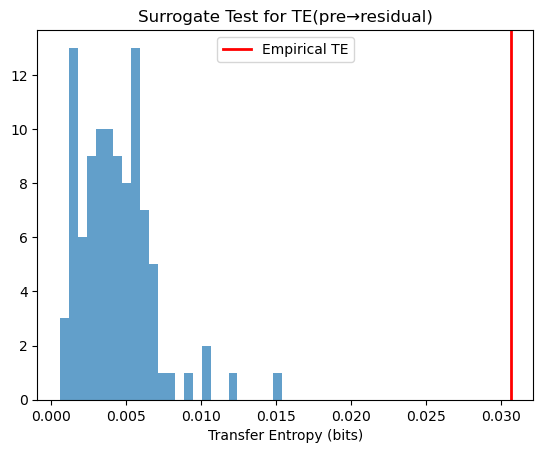

p-value = 0.000


In [12]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from pyinform import transfer_entropy  # correct import! :contentReference[oaicite:0]{index=0}

# — assume df_pre_aligned['pre'] and df_residual['residual'] exist and are same length
x = df_pre['pre'].values      # source (precession)
y = df_sq['sq'].values    # target (residual)

# flip x and y upside down
x = x[::-1]
y = y[::-1]





# choose one bin‐count for your sine‐like “pre” and another for your square wave
nbins_x = 4
nbins_y = 2

# equiprobable bin edges for x
xbins = np.histogram_bin_edges(x, bins=nbins_x)

# for y, two equiprobable bins will naturally split at zero (–1 vs. +1)
ybins = np.histogram_bin_edges(y, bins=nbins_y)


x_disc = np.digitize(x, xbins) - 1
y_disc = np.digitize(y, ybins) - 1


# 2) Compute TE from pre→residual with history length k=1
#    note: drop last/first sample to align t→t+1
te_xy = transfer_entropy(x_disc[:-1], y_disc[1:], k=5)
print(f"TE(pre→residual) = {te_xy:.4f} bits")

# 3) Permutation‐based surrogate test
n_surr = 100
te_null = np.zeros(n_surr)
for i in range(n_surr):
    xs = np.random.permutation(x_disc)
    te_null[i] = transfer_entropy(xs[:-1], y_disc[1:], k=1)

# 4) Plot null distribution
plt.hist(te_null, bins=25, alpha=0.7)
plt.axvline(te_xy, color='r', lw=2, label='Empirical TE')
plt.xlabel('Transfer Entropy (bits)')
plt.legend()
plt.title('Surrogate Test for TE(pre→residual)')
plt.show()

# 5) Compute p-value
p_value = np.mean(te_null >= te_xy)
print(f"p-value = {p_value:.3f}")

Empirical TE(pre→sq) = 0.0014 bits



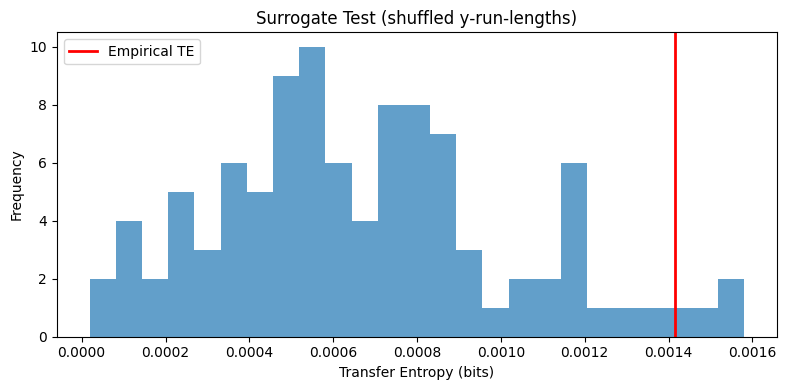

p‐value = 0.030


In [59]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from pyinform import transfer_entropy

# — assume df_pre_aligned['pre'] and df_residual['residual'] exist and are same length
x = df_pre['pre'].values      # source (precession)
y = df_sq['sq'].values        # target (residual)

# flip x and y if you still want to reverse time
x = x[::-1]
y = y[::-1]

# 1) Discretize into nbins_x for x, and 2 bins for y
nbins_x = 4
nbins_y = 2

xbins = np.histogram_bin_edges(x, bins=nbins_x)
ybins = np.histogram_bin_edges(y, bins=nbins_y)

x_disc = np.digitize(x, xbins) - 1
x_disc = np.clip(x_disc, 0, nbins_x-1)

# since y is already a {-1,+1} square wave, threshold at 0
y_disc = (y > 0).astype(int)   # 0/1

# 2) Compute empirical TE(pre→sq)
te_xy = transfer_entropy(x_disc[:-1], y_disc[1:], k=1)
print(f"Empirical TE(pre→sq) = {te_xy:.4f} bits\n")

# 3) Extract the original run‐lengths of the square wave
durations = []
state = y_disc[0]
count = 1
for v in y_disc[1:]:
    if v == state:
        count += 1
    else:
        durations.append(count)
        state = v
        count = 1
durations.append(count)

start_state = y_disc[0]
n = len(y_disc)

# 4) Build null distribution by shuffling those durations
n_surr = 100
te_null = np.zeros(n_surr)
rng = np.random.RandomState(0)

for i in range(n_surr):
    # shuffle run‐lengths
    perm_dur = rng.permutation(durations)
    # rebuild a surrogate y that alternates but uses permuted durations
    y_surr = []
    st = start_state
    for d in perm_dur:
        y_surr.extend([st] * d)
        st = 1 - st
        if len(y_surr) >= n:
            break
    y_surr = np.array(y_surr[:n], dtype=int)

    # TE between original x and this surrogate y
    te_null[i] = transfer_entropy(x_disc[:-1], y_surr[1:], k=1)

# 5) Plot null histogram and empirical value
plt.figure(figsize=(8,4))
plt.hist(te_null, bins=25, alpha=0.7)
plt.axvline(te_xy, color='r', lw=2, label='Empirical TE')
plt.xlabel('Transfer Entropy (bits)')
plt.ylabel('Frequency')
plt.legend()
plt.title('Surrogate Test (shuffled y‐run‐lengths)')
plt.tight_layout()
plt.show()

# 6) p‐value
p_value = np.mean(te_null >= te_xy)
print(f"p‐value = {p_value:.3f}")


TE(pre→residual) = 0.0015 bits


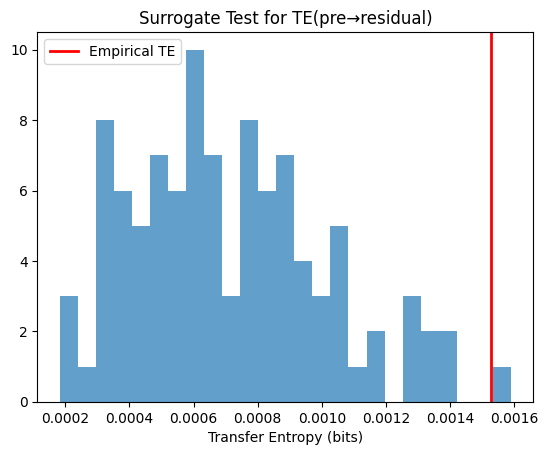

p-value = 0.010


In [50]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from pyinform import transfer_entropy  # correct import! :contentReference[oaicite:0]{index=0}

# — assume df_pre_aligned['pre'] and df_residual['residual'] exist and are same length
x = df_pre['pre'].values      # source (precession)
y = df_sq['sq'].values    # target (residual)

# flip x and y upside down
x = x[::-1]
y = y[::-1]

# 1) Discretize into nbins equiprobable bins
# nbins = 8
# xbins = np.histogram_bin_edges(x, bins=nbins)
# ybins = np.histogram_bin_edges(y, bins=nbins)





# choose one bin‐count for your sine‐like “pre” and another for your square wave
nbins_x = 6
nbins_y = 2

# equiprobable bin edges for x
xbins = np.histogram_bin_edges(x, bins=nbins_x)

# for y, two equiprobable bins will naturally split at zero (–1 vs. +1)
ybins = np.histogram_bin_edges(y, bins=nbins_y)










x_disc = np.digitize(x, xbins) - 1
y_disc = np.digitize(y, ybins) - 1
# # print the shape of x_disc and y_disc
# print('Shape of x_disc:', x_disc.shape)
# print('Shape of y_disc:', y_disc.shape)
# # plot x_disc and y_disc
# plt.figure(figsize=(12, 2))
# plt.subplot(1, 2, 1)
# plt.hist(x_disc, bins=nbins, alpha=0.7)
# plt.title('Discretized x (precession)')
# plt.subplot(1, 2, 2)

# plt.hist(y_disc, bins=nbins, alpha=0.7)
# plt.title('Discretized y (residual)')
# plt.show()


# 2) Compute TE from pre→residual with history length k=1
#    note: drop last/first sample to align t→t+1
te_xy = transfer_entropy(x_disc[:-1], y_disc[1:], k=1)
print(f"TE(pre→residual) = {te_xy:.4f} bits")

# 3) Permutation‐based surrogate test
n_surr = 100
te_null = np.zeros(n_surr)
for i in range(n_surr):
    xs = np.random.permutation(x_disc)
    te_null[i] = transfer_entropy(xs[:-1], y_disc[1:], k=1)

# 4) Plot null distribution
plt.hist(te_null, bins=25, alpha=0.7)
plt.axvline(te_xy, color='r', lw=2, label='Empirical TE')
plt.xlabel('Transfer Entropy (bits)')
plt.legend()
plt.title('Surrogate Test for TE(pre→residual)')
plt.show()

# 5) Compute p-value
p_value = np.mean(te_null >= te_xy)
print(f"p-value = {p_value:.3f}")

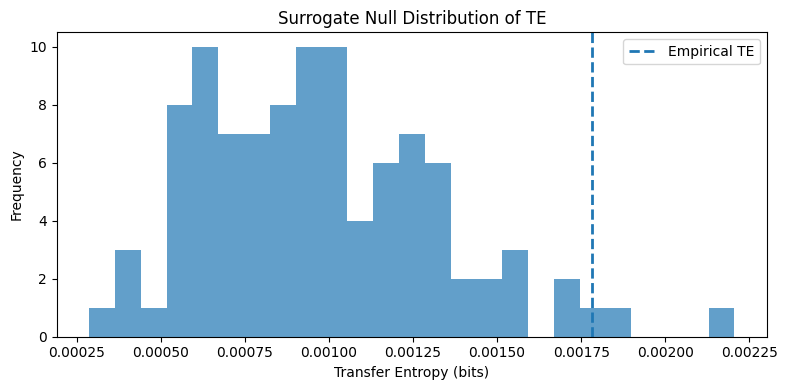

(0.0017808015970102596,
 0.02,
 array([0.00135582, 0.00056193, 0.00085434, 0.00105363, 0.0004356 ,
        0.00139283, 0.00090972, 0.00128045, 0.00104514, 0.00068146,
        0.00074229, 0.00121682, 0.00186691, 0.00113282, 0.00065076,
        0.00053876, 0.0009021 , 0.00127271, 0.00119171, 0.00054053,
        0.00125846, 0.00134176, 0.00154642, 0.00099155, 0.00131831,
        0.00108387, 0.00091576, 0.00220565, 0.00176286, 0.00056408,
        0.0017221 , 0.00094635, 0.00044294, 0.00101613, 0.00127736,
        0.00108366, 0.000618  , 0.00098793, 0.00173813, 0.00052537,
        0.0006007 , 0.00099946, 0.00094057, 0.00052314, 0.00078695,
        0.00043957, 0.00089698, 0.00073434, 0.00079881, 0.00114067,
        0.00072583, 0.00093175, 0.00080174, 0.00066972, 0.00063842,
        0.00090315, 0.00113738, 0.00150815, 0.00122283, 0.00064101,
        0.00153189, 0.00100227, 0.00088192, 0.00083264, 0.00105091,
        0.00083495, 0.00126589, 0.00115582, 0.00039768, 0.00075704,
        0.0005372

In [53]:
x = df_pre['pre'].values      # source (precession)
y = df_sq['sq'].values    # target (residual)

# flip x and y upside down
x = x[::-1]
y = y[::-1]


transfer_entropy_with_significance(x, y)

In [51]:
import numpy as np
import matplotlib.pyplot as plt

def transfer_entropy_with_significance(x, y, nbins_x=8, nbins_y=2, k=1, n_surr=100, random_state=None):
    """
    Compute transfer entropy TE_{X->Y} and assess its significance, 
    then plot the null distribution of surrogate TE values with the empirical TE marked.

    Returns:
        te_emp: empirical TE (bits)
        p_value: fraction of surrogate TE >= te_emp
        te_surr: array of surrogate TE values
    """
    x = np.asarray(x)
    y = np.asarray(y)
    n = len(x)
    if len(y) != n:
        raise ValueError("Source and target must have same length")
    
    # Discretize x
    if not np.issubdtype(x.dtype, np.integer):
        xbins = np.histogram_bin_edges(x, bins=nbins_x)
        x_disc = np.digitize(x, xbins) - 1
        x_disc = np.clip(x_disc, 0, nbins_x-1)
        Nx = nbins_x
    else:
        x_disc = x
        Nx = int(x.max() - x.min() + 1)
    # Discretize y
    if not np.issubdtype(y.dtype, np.integer):
        ybins = np.histogram_bin_edges(y, bins=nbins_y)
        y_disc = np.digitize(y, ybins) - 1
        y_disc = np.clip(y_disc, 0, nbins_y-1)
        Ny = nbins_y
    else:
        y_disc = y
        Ny = int(y.max() - y.min() + 1)

    # TE computation helper
    def compute_te(xd, yd):
        counts = np.zeros((Ny, Ny, Nx), dtype=int)
        for i in range(n - k):
            counts[yd[i+k], yd[i], xd[i]] += 1
        total = counts.sum()
        N_yx = counts.sum(axis=0)
        counts_yy = counts.sum(axis=2)
        N_ycur = counts_yy.sum(axis=0)
        te_val = 0.0
        for y_next in range(Ny):
            for y_cur in range(Ny):
                for x_cur in range(Nx):
                    c = counts[y_next, y_cur, x_cur]
                    if c > 0:
                        p_xyz = c / total
                        p_y1_yx = c / N_yx[y_cur, x_cur]
                        p_y1_y = counts_yy[y_next, y_cur] / N_ycur[y_cur]
                        te_val += p_xyz * np.log2(p_y1_yx / p_y1_y)
        return te_val

    # Empirical TE
    te_emp = compute_te(x_disc, y_disc)

    # Surrogate tests
    rng = np.random.RandomState(random_state)
    te_surr = np.zeros(n_surr)
    for i in range(n_surr):
        xs = rng.permutation(x_disc)
        te_surr[i] = compute_te(xs, y_disc)

    # p-value
    p_value = np.mean(te_surr >= te_emp)

    # Plot null distribution
    plt.figure(figsize=(8, 4))
    plt.hist(te_surr, bins=25, alpha=0.7)
    plt.axvline(te_emp, linestyle='--', linewidth=2, label='Empirical TE')
    plt.xlabel('Transfer Entropy (bits)')
    plt.ylabel('Frequency')
    plt.legend()
    plt.title('Surrogate Null Distribution of TE')
    plt.tight_layout()
    plt.show()

    return te_emp, p_value, te_surr




# Sq to pre

TE(pre→residual) = 0.0008 bits


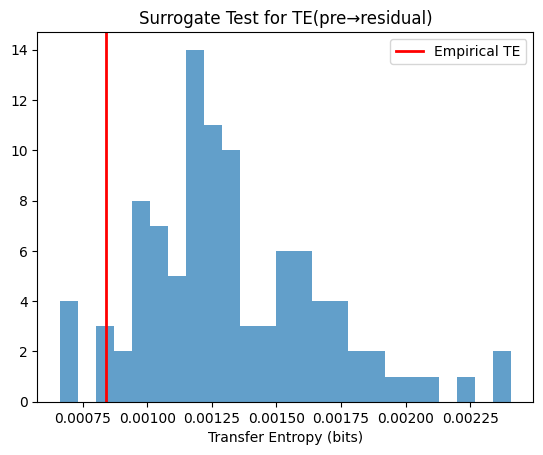

p-value = 0.950


In [16]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from pyinform import transfer_entropy  # correct import! :contentReference[oaicite:0]{index=0}

# — assume df_pre_aligned['pre'] and df_residual['residual'] exist and are same length
y = df_pre['pre'].values      # source (precession)
x = df_sq['sq'].values    # target (residual)

# flip x and y upside down
x = x[::-1]
y = y[::-1]

# 1) Discretize into nbins equiprobable bins
nbins = 8
xbins = np.histogram_bin_edges(x, bins=nbins)
ybins = np.histogram_bin_edges(y, bins=nbins)
x_disc = np.digitize(x, xbins) - 1
y_disc = np.digitize(y, ybins) - 1

# 2) Compute TE from pre→residual with history length k=1
#    note: drop last/first sample to align t→t+1
te_xy = transfer_entropy(x_disc[:-1], y_disc[1:], k=1)
print(f"TE(pre→residual) = {te_xy:.4f} bits")

# 3) Permutation‐based surrogate test
n_surr = 100
te_null = np.zeros(n_surr)
for i in range(n_surr):
    xs = np.random.permutation(x_disc)
    te_null[i] = transfer_entropy(xs[:-1], y_disc[1:], k=1)

# 4) Plot null distribution
plt.hist(te_null, bins=25, alpha=0.7)
plt.axvline(te_xy, color='r', lw=2, label='Empirical TE')
plt.xlabel('Transfer Entropy (bits)')
plt.legend()
plt.title('Surrogate Test for TE(pre→residual)')
plt.show()

# 5) Compute p-value
p_value = np.mean(te_null >= te_xy)
print(f"p-value = {p_value:.3f}")

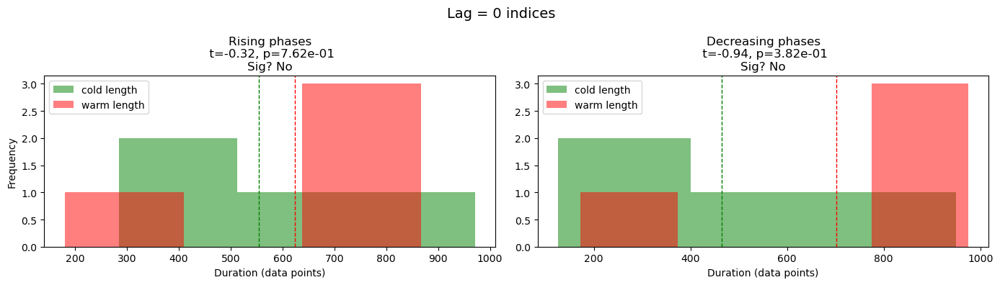

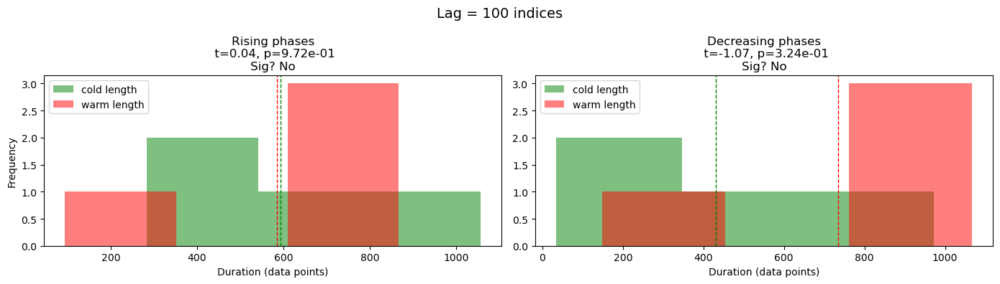

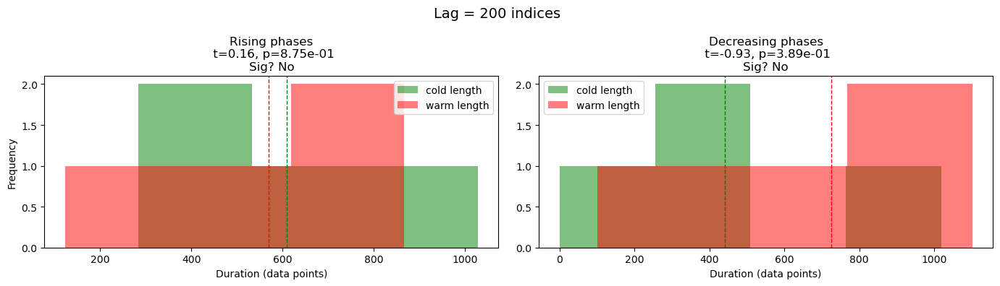

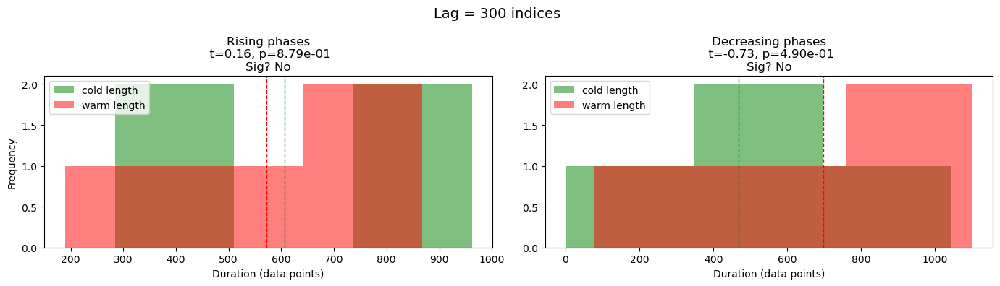

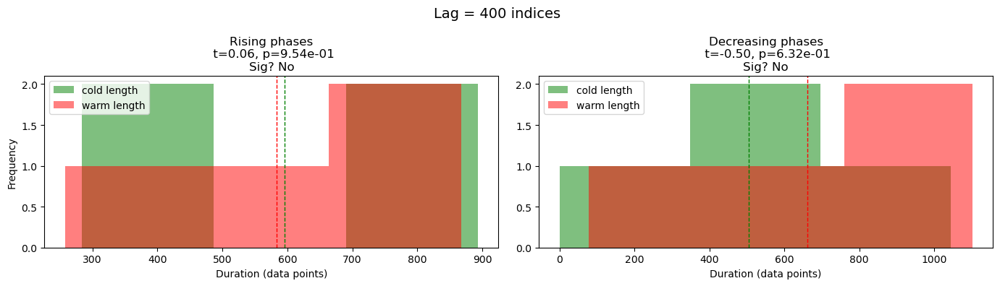

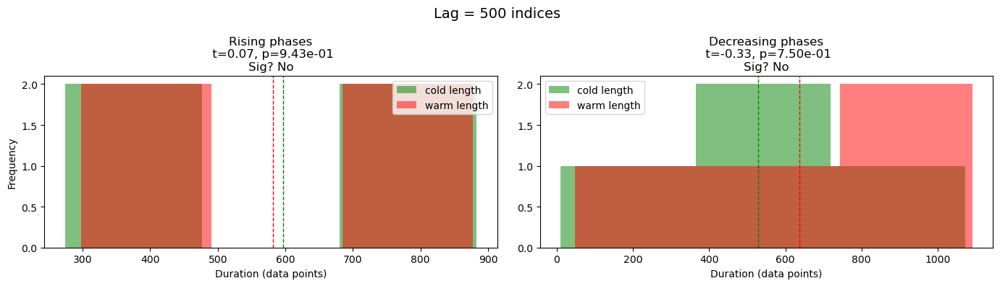

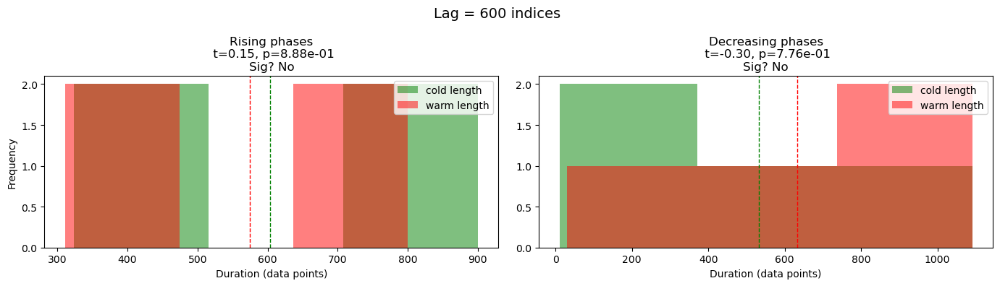

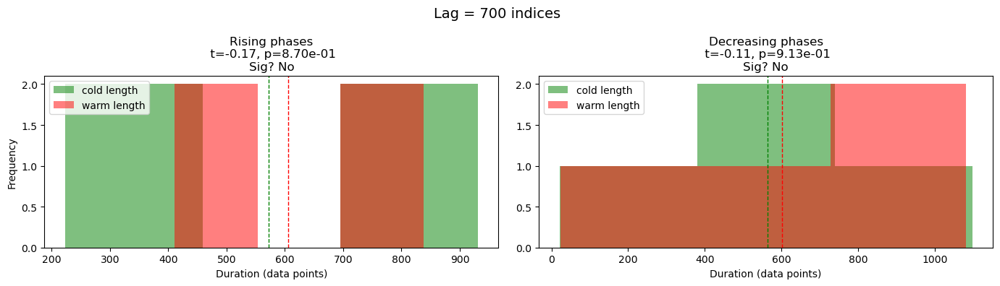

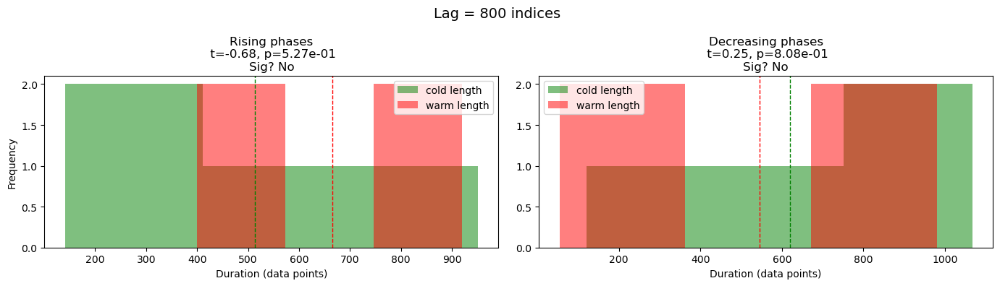

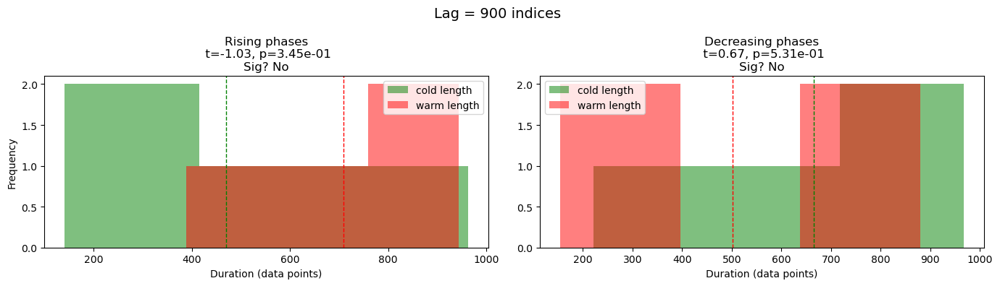

In [13]:
from toolbox import sq_ana as sa 
import importlib
importlib.reload(sa)

sa.plot_phase_durations(df_pre, df_sq)

TE(pre→residual) = 0.0015 bits


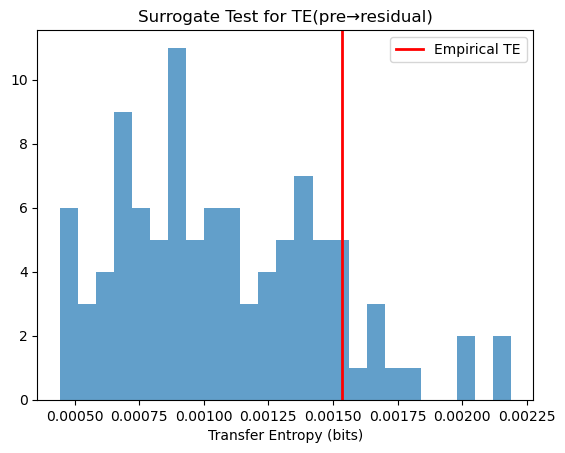

p-value = 0.130


In [11]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from pyinform import transfer_entropy  # correct import! :contentReference[oaicite:0]{index=0}

# — assume df_pre_aligned['pre'] and df_residual['residual'] exist and are same length
x = df_obl['obl'].values      # source (precession)
y = df_sq['sq'].values    # target (residual)

# flip x and y upside down
x = x[::-1]
y = y[::-1]

# 1) Discretize into nbins equiprobable bins
nbins = 8
xbins = np.histogram_bin_edges(x, bins=nbins)
ybins = np.histogram_bin_edges(y, bins=nbins)
x_disc = np.digitize(x, xbins) - 1
y_disc = np.digitize(y, ybins) - 1

# 2) Compute TE from pre→residual with history length k=1
#    note: drop last/first sample to align t→t+1
te_xy = transfer_entropy(x_disc[:-1], y_disc[1:], k=1)
print(f"TE(pre→residual) = {te_xy:.4f} bits")

# 3) Permutation‐based surrogate test
n_surr = 100
te_null = np.zeros(n_surr)
for i in range(n_surr):
    xs = np.random.permutation(x_disc)
    te_null[i] = transfer_entropy(xs[:-1], y_disc[1:], k=1)

# 4) Plot null distribution
plt.hist(te_null, bins=25, alpha=0.7)
plt.axvline(te_xy, color='r', lw=2, label='Empirical TE')
plt.xlabel('Transfer Entropy (bits)')
plt.legend()
plt.title('Surrogate Test for TE(pre→residual)')
plt.show()

# 5) Compute p-value
p_value = np.mean(te_null >= te_xy)
print(f"p-value = {p_value:.3f}")

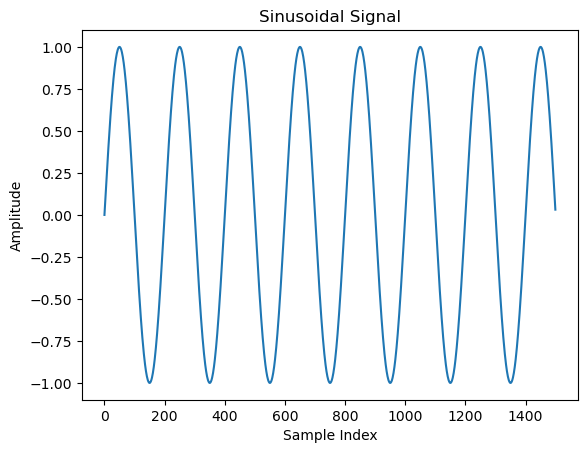

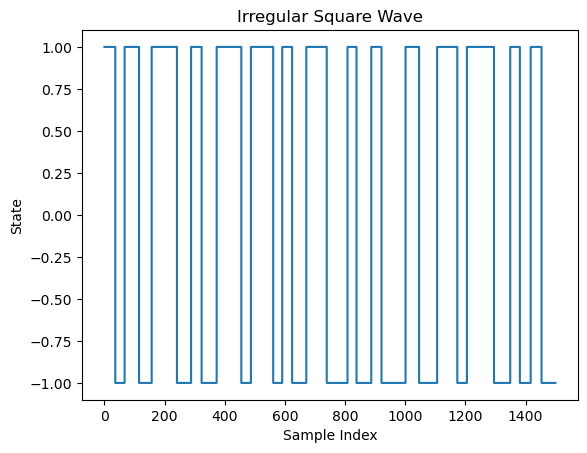

In [12]:
import numpy as np
import matplotlib.pyplot as plt

# 1. Generate sinusoidal signal
N = 1500
t = np.arange(N)
sin_signal = np.sin(2 * np.pi * t / 200)

# 2. Identify rising-phase segments of the sine wave
diff = np.diff(sin_signal)
rising_mask = diff > 0
segments = []
in_segment = False
for i, is_rising in enumerate(rising_mask):
    if is_rising and not in_segment:
        in_segment = True
        start_diff = i
    if in_segment and (not is_rising or i == len(rising_mask) - 1):
        end_diff = i
        # Map diff-index segment to sample indices
        start_idx = start_diff
        end_idx = end_diff + 1
        segments.append((start_idx, end_idx))
        in_segment = False

# 3. Generate irregular square wave tied to rising-phase sine values
wave = np.empty(N)
current_idx = 0
state = 1
rng = np.random.default_rng()

while current_idx < N:
    # If this segment is a low-phase (-1) starting within a rising-phase
    if state == -1 and any(start <= current_idx <= end for start, end in segments):
        # Find the containing rising segment
        for start, end in segments:
            if start <= current_idx <= end:
                seg_len = end - start + 1
                break
        # Duration bounds
        dur_min = 30
        dur_max = min(90, int(np.floor(seg_len * 0.6)))
        # Sinusoidal value at segment start
        sin_val = sin_signal[current_idx]
        # Factor ties duration to sin value (higher sin → longer low-phase)
        factor = ((sin_val + 1) / 2) * rng.uniform(0.5, 1.0)
        duration = int(np.round(dur_min + (dur_max - dur_min) * factor))
        duration = np.clip(duration, dur_min, dur_max)
    else:
        # Otherwise random duration between 30 and 90
        duration = int(rng.integers(30, 91))
    
    end_idx = min(N, current_idx + duration)
    wave[current_idx:end_idx] = state
    current_idx = end_idx
    state = -state  # flip state

# 4. Plotting
plt.figure()
plt.plot(t, sin_signal)
plt.title('Sinusoidal Signal')
plt.xlabel('Sample Index')
plt.ylabel('Amplitude')

plt.figure()
plt.step(t, wave, where='post')
plt.title('Irregular Square Wave')
plt.xlabel('Sample Index')
plt.ylabel('State')

plt.show()


TE(pre→residual) = 0.0074 bits


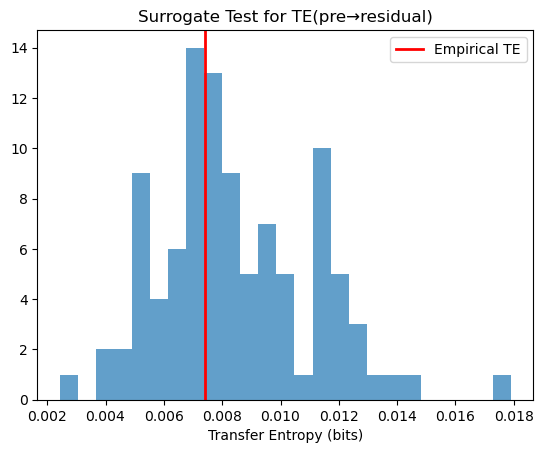

p-value = 0.610


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from pyinform import transfer_entropy  


x = sin_signal
y = wave

# flip x and y upside down
x = x[::-1]
y = y[::-1]

# 1) Discretize into nbins equiprobable bins
nbins = 8
xbins = np.histogram_bin_edges(x, bins=nbins)
ybins = np.histogram_bin_edges(y, bins=nbins)
x_disc = np.digitize(x, xbins) - 1
y_disc = np.digitize(y, ybins) - 1

# 2) Compute TE from pre→residual with history length k=1
#    note: drop last/first sample to align t→t+1
te_xy = transfer_entropy(x_disc[:-1], y_disc[1:], k=1)
print(f"TE(pre→residual) = {te_xy:.4f} bits")

# 3) Permutation‐based surrogate test
n_surr = 100
te_null = np.zeros(n_surr)
for i in range(n_surr):
    xs = np.random.permutation(x_disc)
    te_null[i] = transfer_entropy(xs[:-1], y_disc[1:], k=1)

# 4) Plot null distribution
plt.hist(te_null, bins=25, alpha=0.7)
plt.axvline(te_xy, color='r', lw=2, label='Empirical TE')
plt.xlabel('Transfer Entropy (bits)')
plt.legend()
plt.title('Surrogate Test for TE(pre→residual)')
plt.show()

# 5) Compute p-value
p_value = np.mean(te_null >= te_xy)
print(f"p-value = {p_value:.3f}")

→ optimal window=4900, threshold gt -0.263, max F1=0.764


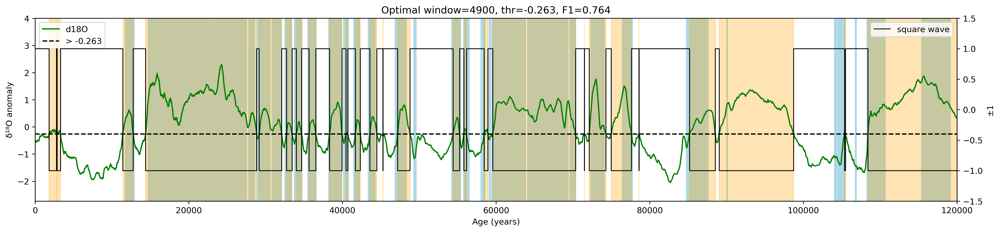

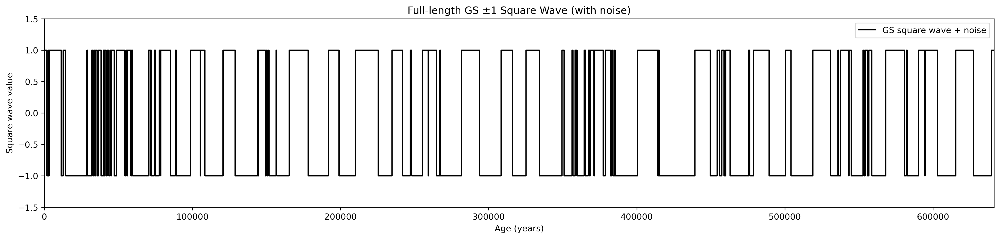

In [8]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from itertools import groupby
from scipy.interpolate import interp1d

# --- 0) load & interpolate as before ---
file_path = r"D:\VScode\bipolar_seesaw_CCM\other_data\monsoon.xlsx"
df = pd.read_excel(file_path)
df['age'] = df['age'] * 1000

# resample to 10-yr steps
new_age = np.arange(0, 641260, 10)
f = interp1d(df['age'], df['d18O'], kind='nearest',
             bounds_error=False, fill_value=1)
new_df = pd.DataFrame({
    'age': new_age,
    'd18O': f(new_age)
})

# --- 1) GS ground-truth table ---
gs_data = {
    "start": [11703, 14692, 23020, 23340, 27780, 28900, 30840, 32500, 33740, 35480,
              38220, 40160, 41460, 43340, 46860, 49280, 54220, 55000, 55800, 58040,
              58280, 59080, 59440, 64100, 69620, 72340, 76440, 84760, 85060, 90040,
              104040,104520,106750,108280,115370],
    "end":   [12896, 22900, 23220, 27540, 28600, 30600, 32040, 33360, 34740, 36580,
              39900, 40800, 42240, 44280, 48340, 49600, 54900, 55400, 56500, 58160,
              58560, 59300, 63840, 69400, 70380, 74100, 77760, 84960, 87600, 90140,
              104380,105440,106900,110640,119140]
}
# make ground truth mask on cropped (<120k yr)
mask_true_full = np.zeros_like(new_df['age'].values, dtype=bool)
for s, e in zip(gs_data["start"], gs_data["end"]):
    mask_true_full |= (new_df['age'] >= s) & (new_df['age'] <= e)

mask_true_crop = mask_true_full & (new_df['age'] < 120_000)

# F1 helper
def f1_score(pred, true):
    tp = np.sum(pred & true)
    fp = np.sum(pred & ~true)
    fn = np.sum(~pred & true)
    return 2*tp/(2*tp + fp + fn) if (2*tp + fp + fn)>0 else 0

# --- 2) grid‐search over window & threshold ---
window_range = np.arange(3_000, 20_001, 1_00)
# thr_cands = np.linspace(-1, 1, 201)  # adjust range if needed



from scipy.signal import butter, filtfilt

def butter_highpass(cutoff, fs, order=4):
    nyq = 0.5 * fs
    normal_cutoff = cutoff / nyq
    b, a = butter(order, normal_cutoff, btype='high', analog=False)
    return b, a
# 2) Parameters
dt = 1000.0              # years between samples
fs = 1.0 / dt          # sampling frequency [per year]
cutoff = 1.0 / 100000.0 # desired cutoff [per year]
order = 4

# 3) Design filter
b, a = butter_highpass(cutoff, fs, order=order)
# 4) Apply filter (zero-phase) to the d18O column
# df_sd['d18O'] = filtfilt(b, a, df_sd['d18O'].values)





best = {'window':None, 'thr':None, 'dir':None, 'f1':-1}

for w in window_range:
    # low‐freq smoothing & anomaly
    smooth_lo = new_df['d18O'].rolling(window=w, center=True, min_periods=1).mean()
    anomaly = new_df['d18O'] - smooth_lo


    # anomaly = filtfilt(b, a, new_df['d18O'].values)

    # anomaly = pd.Series(
    # filtfilt(b, a, new_df['d18O'].values),
    # index=new_df.index,
    # name='d18O')

    # anomaly = new_df['d18O'] 





    # optional 50-pt smoothing of anomaly
    anomaly_sm = anomaly.rolling(window=50, center=True, min_periods=1).mean()
    
    # crop to <120k for scoring
    vals = anomaly_sm.values[ new_df['age'] < 120_000 ]
    true = mask_true_crop[ new_df['age'] < 120_000 ]


    thr_min = vals.min()
    thr_max = vals.max()
    step    = (thr_max - thr_min) / 100.0
    thr_cands = np.linspace(thr_min, thr_max, 101)
    
    # scan threshold & direction
    for direction in ('gt','lt'):
        for thr in thr_cands:
            pred = (vals > thr) if direction=='gt' else (vals < thr)
            score = f1_score(pred, true)
            if score > best['f1']:
                best.update(window=w, thr=thr, dir=direction, f1=score)

print(f"→ optimal window={best['window']}, "
      f"threshold {best['dir']} {best['thr']:.3f}, "
      f"max F1={best['f1']:.3f}")

# --- 3) build final square wave over full record ---
lo = new_df['d18O'].rolling(window=best['window'],
                            center=True, min_periods=1).mean()
anom = new_df['d18O'] - lo
anom_sm = anom.rolling(window=50, center=True, min_periods=1).mean().values

if best['dir']=='gt':
    is_gs_pred = anom_sm > best['thr']
else:
    is_gs_pred = anom_sm < best['thr']

square_wave = np.where(is_gs_pred, -1, 1)

# --- fix here: build segments safely ---
ages_all = new_df['age'].values
segments = []
for val, grp in groupby(enumerate(is_gs_pred), key=lambda x: x[1]):
    if val:
        grp_list = list(grp)
        start_idx = grp_list[0][0]
        end_idx   = grp_list[-1][0]
        segments.append((ages_all[start_idx], ages_all[end_idx]))


# --- 4) plot final result ---
fig, ax = plt.subplots(figsize=(20,4), dpi=300)

# official GS spans
for s,e in zip(gs_data["start"], gs_data["end"]):
    ax.axvspan(s, e, color='lightblue', alpha=1, zorder=0)
# predicted spans
for s,e in segments:
    ax.axvspan(s, e, color='orange', alpha=0.3, zorder=1)

# δ18O anomaly curve
ax.plot(new_df['age'], anom_sm, color='green', label='d18O')

# threshold line
thr_line = best['thr']
ax.axhline(thr_line, linestyle='--', color='black',
           label=f"{'>' if best['dir']=='gt' else '<'} {thr_line:.3f}")

# square wave inset
ax2 = ax.twinx()
ax2.plot(ages_all, square_wave, drawstyle='steps-post',
         color='black', linewidth=1, label='square wave')
ax2.set_ylim(-1.5,1.5)
ax2.set_ylabel('±1')

ax.invert_xaxis()  # if you want age decreasing left→right
ax.set_xlim(0,120000)
ax.set_xlabel('Age (years)')
ax.set_ylabel('δ¹⁸O anomaly')
ax.set_title(f"Optimal window={best['window']}, thr={best['thr']:.3f}, F1={best['f1']:.3f}")
ax.legend(loc='upper left')
ax2.legend(loc='upper right')

plt.show()



# 2) Recreate df_sq exactly as in your original code
df_sq = pd.DataFrame({'age': ages_all, 'sq': square_wave})
white_noise = np.random.normal(0, 0.1, len(square_wave))
df_sq['sq'] = df_sq['sq'] #+ white_noise

# 3) Plot full‐length noisy square wave
fig, ax = plt.subplots(figsize=(20, 4), dpi=300)
ax.plot(df_sq['age'],
        df_sq['sq'],
        drawstyle='steps-post',
        color='black',
        linewidth=1.5,
        label='GS square wave + noise')
ax.set_ylim(min(square_wave) - 0.5, max(square_wave) + 0.5)
ax.set_xlim(df_sq['age'].min(), df_sq['age'].max())  # 0 → 641260
ax.set_xlabel('Age (years)')
ax.set_ylabel('Square wave value')
ax.set_title('Full‐length GS ±1 Square Wave (with noise)')
ax.legend(loc='upper right')
plt.show()



# Data processing

→ optimal window=4890, threshold gt -0.264, max F1=0.764


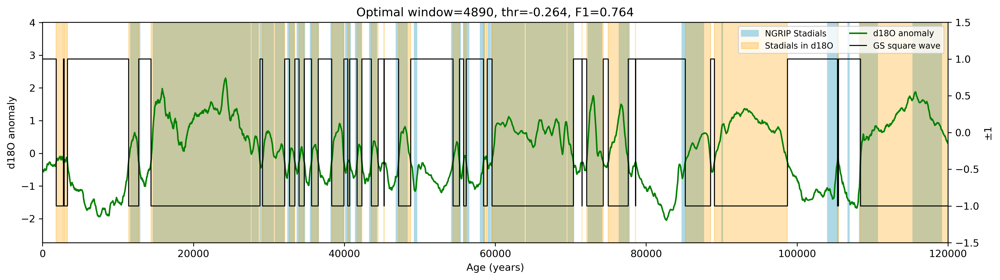

→ optimal window=4320, threshold lt -2.152, max F1=0.746


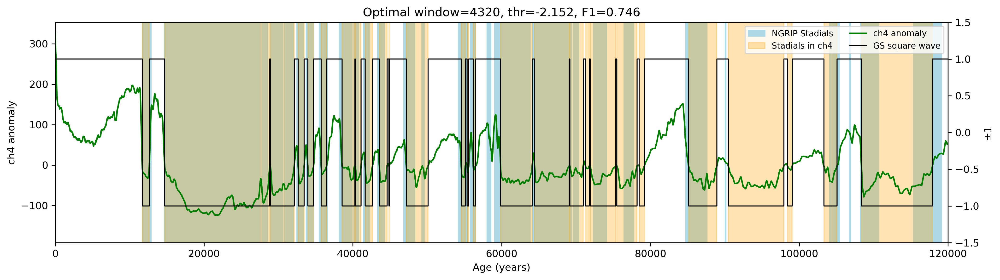

In [32]:
from toolbox import sq_ana as sa 
import importlib
importlib.reload(sa)
import pandas as pd

file_path = r"D:\VScode\bipolar_seesaw_CCM\other_data\monsoon.xlsx"
df_d18O = pd.read_excel(file_path)
df_d18O['age'] = df_d18O['age'] * 1000

new_df, df_d18O_sq, best = sa.build_DO_sq(df_d18O,  extra_sm=50, if_plot=True, dir='gt',metrics='F1')





import pandas as pd

df_ch4 = pd.read_excel('other_data/CH4_AICC2023.xlsx', sheet_name='Sheet1')


# plot the data
import matplotlib.pyplot as plt



from toolbox import sq_ana as sa 
import importlib
importlib.reload(sa)
import pandas as pd

new_df, df_ch4_sq, best = sa.build_DO_sq(df_ch4, if_plot=True, age_start=0, age_end=799630, extra_sm=30, dir='lt', metrics='F1')

In [26]:
import pandas as pd
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import numpy as np
from scipy.interpolate import interp1d
import matplotlib.pyplot as plt

# === your GS reference data ===
gs_data = {
    "start": [11703,14692,23020,23340,27780,28900,30840,32500,
              33740,35480,38220,40160,41460,43340,46860,49280,
              54220,55000,55800,58040,58280,59080,59440,64100,
              69620,72340,76440,84760,85060,90040,
              104040,104520,106750,108280,115370],
    "end":   [12896,22900,23220,27540,28600,30600,32040,33360,
              34740,36580,39900,40800,42240,44280,48340,49600,
              54900,55400,56500,58160,58560,59300,63840,69400,
              70380,74100,77760,84960,87600,90140,
              104380,105440,106900,110640,119140]
}

# === load & preprocess ===
file_path = r"D:\VScode\bipolar_seesaw_CCM\other_data\monsoon.xlsx"
df = pd.read_excel(file_path)
df['age'] = df['age'] * 1000

# interpolate to 10-yr grid
new_age = np.arange(0, int(df['age'].max())+10, 10)
f = interp1d(df['age'], df['d18O'], kind='nearest',
             bounds_error=False, fill_value=1)
interpolated = f(new_age)
new_df = pd.DataFrame({'age': new_age, 'd18O': interpolated})

# low-frequency smooth
new_df['smoothed'] = new_df['d18O'].rolling(1000, center=True, min_periods=1).mean()
# millennial signal
new_df['d18O_ms'] = new_df['d18O'] - new_df['smoothed']
# extra smooth + first difference
new_df['d18O_ms']   = new_df['d18O_ms'].rolling(50, center=True, min_periods=1).mean()
new_df['d18O_diff'] = new_df['d18O_ms'].diff().fillna(0).rolling(15, center=True, min_periods=1).mean()

# === build figure with 2 rows ===
fig = make_subplots(
    rows=2, cols=1,
    shared_xaxes=True,
    vertical_spacing=0.05,
    subplot_titles=("d18O vs Age", "d18O_diff vs Age")
)

# top panel: d18O
fig.add_trace(
    go.Scatter(x=new_df['age'], y=new_df['d18O_ms'], mode='lines', name='d18O'),
    row=1, col=1
)

# bottom panel: diff
fig.add_trace(
    go.Scatter(x=new_df['age'], y=new_df['d18O_diff'],
               mode='lines', name='d18O_diff', line=dict(color='red')),
    row=2, col=1
)

# === add GS vertical strips to the diff panel ===
for s, e in zip(gs_data['start'], gs_data['end']):
    fig.add_vrect(
        x0=s, x1=e,
        fillcolor='LightSalmon', opacity=0.3,
        line_width=0,
        row=2, col=1
    )

# === layout tweaks ===
fig.update_layout(
    height=900, width=1800,
    showlegend=False,
    title_text="Monsoon δ¹⁸O and Its First Difference (with GS periods)"
)

# axes labels
fig.update_xaxes(title_text="Age (years)", row=2, col=1)
fig.update_yaxes(title_text="d18O",      row=1, col=1)
fig.update_yaxes(title_text="d18O_diff", row=2, col=1)

# add range-slider on the diff panel
fig.update_xaxes(rangeslider=dict(visible=True), row=2, col=1)

fig.show()


<bound method NDFrame.head of               age   d18O
0        -16.5010 -9.500
1          0.0000 -9.660
2         19.9980 -9.580
3         38.2475 -9.500
4         56.4970 -9.330
...           ...    ...
8348  640277.6000 -8.855
8349  640520.9000 -9.140
8350  640766.5000 -9.059
8351  641014.4000 -9.343
8352  641264.4000 -9.338

[8353 rows x 2 columns]>
641264.4
-16.501


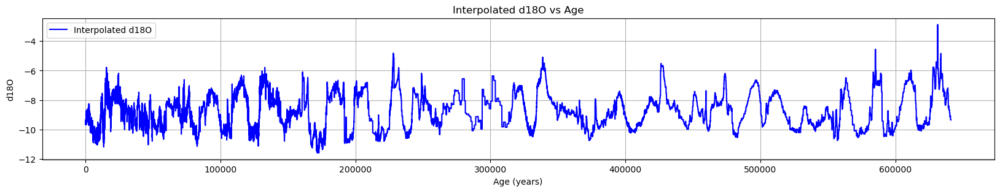

In [2]:
import pandas as pd
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import numpy as np
from scipy.interpolate import interp1d
import matplotlib.pyplot as plt

# === load & preprocess ===
file_path = r"D:\VScode\bipolar_seesaw_CCM\other_data\monsoon.xlsx"
df = pd.read_excel(file_path)
df['age']       = df['age'] * 1000
# df['d18O_diff'] = df['d18O'].diff().fillna(0)


print(df.head)
# print the age max and min
print(df['age'].max())
print(df['age'].min())
# resample the data from age 0 to 641260 with a step of 10
new_age = np.arange(0, 641260, 10)
# create a new DataFrame with the new age values
f = interp1d(df['age'], df['d18O'], kind='nearest',
             bounds_error=False,
             fill_value=1)            

interpolated_sq = f(new_age)

# create a new DataFrame with the new age values
new_df = pd.DataFrame({'age': new_age, 'd18O': interpolated_sq})
# plot the data
plt.figure(figsize=(20, 3))
plt.plot(new_df['age'], new_df['d18O'], label='Interpolated d18O', color='blue')
plt.xlabel('Age (years)')
plt.ylabel('d18O')
plt.title('Interpolated d18O vs Age')
plt.legend()
plt.grid()
plt.show()


new_df["smoothed"] = new_df["d18O"].rolling(window=1000, center=True, min_periods=1).mean()

# 3) Millennial‐scale signal = original minus low‐frequency
new_df["d18O"] = new_df["d18O"] - new_df["smoothed"]



# smooth the millennial‐scale signal with a rolling mean 
new_df["d18O"] = new_df["d18O"].rolling(window=50, center=True, min_periods=1).mean()

# 4) First difference
new_df["d18O_diff"] = new_df["d18O"].diff().fillna(0)

# smooth the d18O_diff with a rolling mean
new_df["d18O_diff"] = new_df["d18O_diff"].rolling(window=15, center=True, min_periods=1).mean()




# === build figure with 2 rows ===
fig = make_subplots(
    rows=2, cols=1,
    shared_xaxes=True,
    vertical_spacing=0.05,
    subplot_titles=("d18O vs Age", "d18O_diff vs Age")
)

# top panel: d18O
fig.add_trace(
    go.Scatter(x=new_df['age'], y=new_df['d18O'],
               mode='lines',
               name='d18O'),
    row=1, col=1
)

# bottom panel: diff
fig.add_trace(
    go.Scatter(x=new_df['age'], y=new_df['d18O_diff'],
               mode='lines',
               name='d18O_diff',
               line=dict(color='red')),
    row=2, col=1
)

# === layout tweaks ===
fig.update_layout(
    height=1000, width=2000,
    showlegend=False,
    title_text="Monsoon δ18O and Its First Difference",
)

# shared x-axis labels
fig.update_xaxes(title_text="Age (ka)", row=2, col=1)

# y-axis labels
fig.update_yaxes(title_text="d18O",      row=1, col=1)
fig.update_yaxes(title_text="d18O_diff", row=2, col=1)

# add range-slider on the bottom x-axis
fig.update_xaxes(
    rangeslider=dict(visible=True),
    row=2, col=1
)

fig.show()


Best thresholds → upper=9.924e-03, lower=-9.597e-03, F1=0.645


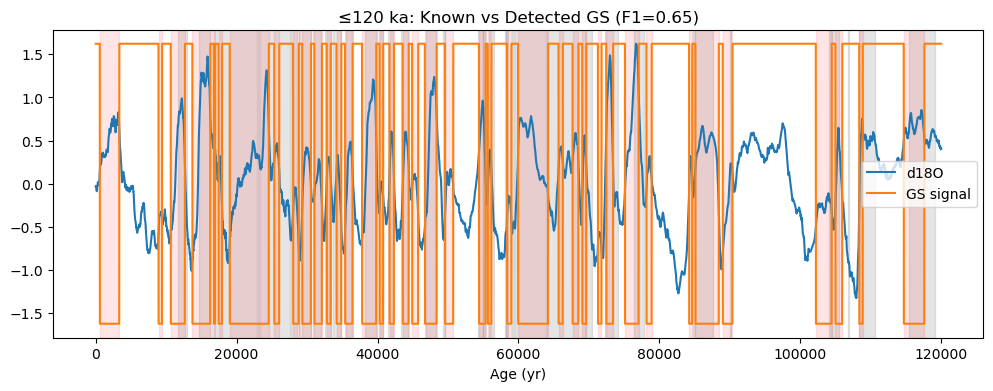

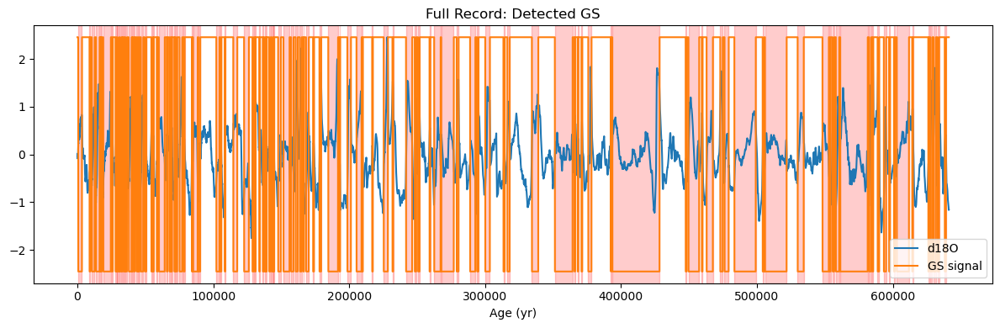

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import find_peaks

# --- assume new_df exists with 'age', 'd18O', 'd18O_diff' ---

# 1. reference GS data (yrs)
gs_data = {
    "start": [11703,14692,23020,23340,27780,28900,30840,32500,
              33740,35480,38220,40160,41460,43340,46860,49280,
              54220,55000,55800,58040,58280,59080,59440,64100,
              69620,72340,76440,84760,85060,90040,
              104040,104520,106750,108280,115370],
    "end":   [12896,22900,23220,27540,28600,30600,32040,33360,
              34740,36580,39900,40800,42240,44280,48340,49600,
              54900,55400,56500,58160,58560,59300,63840,69400,
              70380,74100,77760,84960,87600,90140,
              104380,105440,106900,110640,119140]
}
gs_intervals = np.column_stack((gs_data['start'], gs_data['end']))

# 2. enforce 1:1 alternation
def pair_peaks_valleys(peaks, valleys):
    peaks, valleys = np.sort(peaks), np.sort(valleys)
    i, j = 0, 0
    pairs = []
    # skip any valley before first peak
    while j < len(valleys) and valleys[j] < peaks[0]:
        j += 1
    while i < len(peaks) and j < len(valleys):
        s = peaks[i]
        # advance valley until > s
        while j < len(valleys) and valleys[j] < s:
            j += 1
        if j == len(valleys): break
        e = valleys[j]
        pairs.append((s, e))
        # skip peaks up to this valley
        i += 1
        while i < len(peaks) and peaks[i] <= e:
            i += 1
        j += 1
    return np.array(pairs)  # shape (N,2)

# 3. new F1 based on overlap
def compute_f1_from_intervals(ages, known_intervals, pred_intervals):
    # build binary masks
    known_mask = np.zeros_like(ages, dtype=bool)
    for s,e in known_intervals:
        known_mask[(ages >= s) & (ages <= e)] = True
    pred_mask = np.zeros_like(ages, dtype=bool)
    for s,e in pred_intervals:
        pred_mask[(ages >= s) & (ages <= e)] = True

    tp = np.sum(pred_mask & known_mask)
    fp = np.sum(pred_mask & ~known_mask)
    fn = np.sum(~pred_mask & known_mask)

    prec = tp/(tp+fp) if tp+fp>0 else 0
    rec  = tp/(tp+fn) if tp+fn>0 else 0
    return 2*prec*rec/(prec+rec) if (prec+rec)>0 else 0

# 4. crop ≤120 ka
df_crop   = new_df[new_df['age'] <= 120_000].copy()
ages_crop = df_crop['age'].values
diff_crop = df_crop['d18O_diff'].values

# 5. sweep thresholds to maximize new F1
upper_grid = np.linspace(np.quantile(diff_crop,0.50),
                         np.quantile(diff_crop,0.99), 100)
lower_grid = np.linspace(np.quantile(diff_crop,0.01),
                         np.quantile(diff_crop,0.50), 100)

best_f1 = -1
for ut in upper_grid:
    # candidate starts
    pk_idx, _ = find_peaks(diff_crop, height=ut, distance=50)
    pk_ages   = ages_crop[pk_idx]
    for lt in lower_grid:
        # candidate ends
        vl_idx, _ = find_peaks(-diff_crop, height=-lt, distance=50)
        vl_ages   = ages_crop[vl_idx]
        # enforce alternation
        pairs = pair_peaks_valleys(pk_ages, vl_ages)
        if pairs.size == 0:
            continue
        f1 = compute_f1_from_intervals(ages_crop, gs_intervals, pairs)
        if f1 > best_f1:
            best_f1 = f1
            best = {
                'upper': ut, 'lower': lt,
                'pairs_crop': pairs,
                'f1': f1
            }

print(f"Best thresholds → upper={best['upper']:.3e}, lower={best['lower']:.3e}, F1={best['f1']:.3f}")

# 6. apply to full record
ages_full = new_df['age'].values
diff_full = new_df['d18O_diff'].values
pkf, _ = find_peaks(diff_full,  height=best['upper'], distance=50)
vlf, _ = find_peaks(-diff_full, height=-best['lower'], distance=50)
pairs_full = pair_peaks_valleys(ages_full[pkf], ages_full[vlf])

# build square waves
sq_crop = np.ones_like(ages_crop)
for s,e in best['pairs_crop']:
    sq_crop[(ages_crop>=s)&(ages_crop<=e)] = -1

sq_full = np.ones_like(ages_full)
for s,e in pairs_full:
    sq_full[(ages_full>=s)&(ages_full<=e)] = -1

# 7a. plot ≤120 ka
fig, ax = plt.subplots(figsize=(20,4))
for s,e in gs_intervals:      ax.axvspan(s, e, alpha=0.2, color='grey')
for s,e in best['pairs_crop']:ax.axvspan(s, e, alpha=0.1, color='red')
ax.plot(ages_crop, df_crop['d18O'], label='d18O')
ax.plot(ages_crop, sq_crop*np.max(abs(df_crop['d18O'])), label='GS signal')
ax.set_title(f"≤120 ka: Known vs Detected GS (F1={best['f1']:.2f})")
ax.set_xlabel("Age (yr)")
ax.legend()

# 7b. plot full record
fig2, ax2 = plt.subplots(figsize=(20,4))
for s,e in pairs_full:        ax2.axvspan(s, e, alpha=0.2, color='red')
ax2.plot(ages_full, new_df['d18O'], label='d18O')
ax2.plot(ages_full, sq_full*np.max(abs(new_df['d18O'])), label='GS signal')
ax2.set_title("Full Record: Detected GS")
ax2.set_xlabel("Age (yr)")
ax2.legend()

plt.tight_layout()
plt.show()


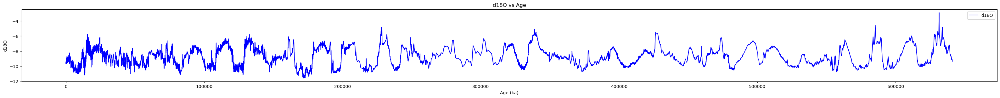

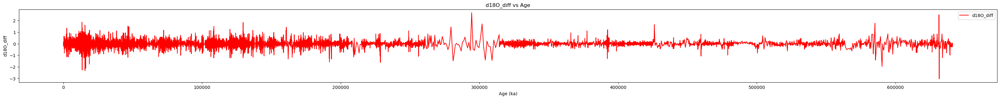

In [5]:
from toolbox import sq_ana as sa 
import importlib
importlib.reload(sa)
import pandas as pd

file_path = r"D:\VScode\bipolar_seesaw_CCM\other_data\monsoon.xlsx"
df = pd.read_excel(file_path)
df['age'] = df['age'] * 1000

# plot df, which has two columns: 'age' and 'd18O'
from matplotlib import pyplot as plt
plt.figure(figsize=(40, 3))
plt.plot(df['age'], df['d18O'], label='d18O', color='blue')
plt.xlabel('Age (ka)')
plt.ylabel('d18O')
plt.title('d18O vs Age')
plt.legend()

# plot the diff of d18O
df['d18O_diff'] = df['d18O'].diff().fillna(0)
plt.figure(figsize=(40, 3))
plt.plot(df['age'], df['d18O_diff'], label='d18O_diff', color='red')
plt.xlabel('Age (ka)')
plt.ylabel('d18O_diff')
plt.title('d18O_diff vs Age')
plt.legend()
plt.show()


Window 500 → min=-1.317, max=1.675
Window 600 → min=-1.280, max=1.670
Window 700 → min=-1.261, max=1.590
Window 800 → min=-1.286, max=1.507
Window 900 → min=-1.306, max=1.532
Window 1000 → min=-1.325, max=1.623
Window 1100 → min=-1.373, max=1.704
Window 1200 → min=-1.480, max=1.795
Window 1300 → min=-1.557, max=1.861
Window 1400 → min=-1.619, max=1.894
Window 1500 → min=-1.682, max=1.893
Window 1600 → min=-1.724, max=1.884
Window 1700 → min=-1.762, max=1.861
Window 1800 → min=-1.812, max=1.826
Window 1900 → min=-1.870, max=1.884
Window 2000 → min=-1.952, max=1.951
Window 2100 → min=-2.013, max=2.001
Window 2200 → min=-2.039, max=2.072
Window 2300 → min=-2.063, max=2.139
Window 2400 → min=-2.076, max=2.199
Window 2500 → min=-2.091, max=2.262
Window 2600 → min=-2.114, max=2.309
Window 2700 → min=-2.146, max=2.321
Window 2800 → min=-2.161, max=2.317
Window 2900 → min=-2.183, max=2.313
Window 3000 → min=-2.208, max=2.305
Window 3100 → min=-2.221, max=2.287
Window 3200 → min=-2.227, max=2.2

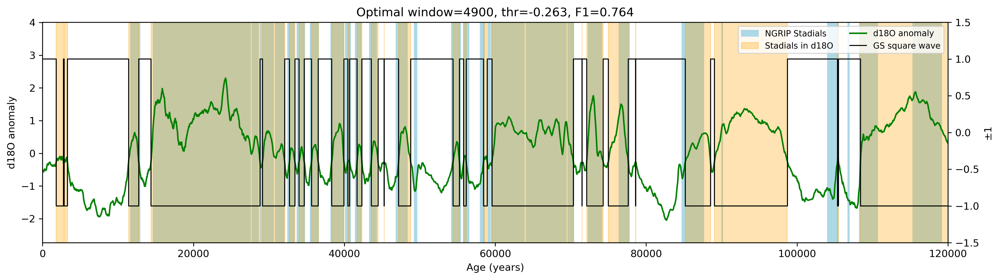

In [1]:
from toolbox import sq_ana as sa 
import importlib
importlib.reload(sa)
import pandas as pd

file_path = r"D:\VScode\bipolar_seesaw_CCM\other_data\monsoon.xlsx"
df = pd.read_excel(file_path)
df['age'] = df['age'] * 1000

new_df, df_sq, best = sa.build_DO_sq(df,  extra_sm=50, if_plot=True, dir='gt',metrics='F1')

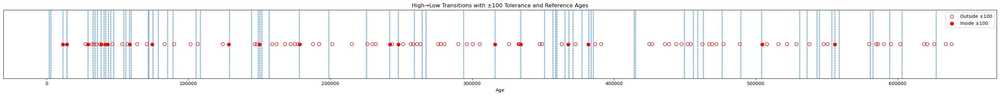

In [25]:
import numpy as np
import matplotlib.pyplot as plt

# 1. Identify high→low transitions
#    (shift the series by one, look for +1 → -1)
transitions = df_sq.loc[
    (df_sq['sq'].shift(1) ==  1) &
    (df_sq['sq']          == -1),
    'age'
].values

# 2. Your reference ages
ref_ages = np.array([
    11.5, 14.3, 27.38, 29.26, 32.02, 33.34, 35.02, 37.78, 38.68,
    41.3, 43.1, 46.42, 53.3, 57.08, 58.58, 63.84, 70.68, 74.5,
    83.18, 89.92, 101.52, 106.54, 124.22, 128.44, 146.7, 148.3,
    150.06, 159.12, 162.16, 168.16, 172, 174.98, 177.14, 178.3,
    187.84, 192.16, 201.42, 215.22, 226.2, 229.76, 232.12, 242.18,
    243.62, 248.02, 251.3, 256.72, 258.48, 261.16, 263.68, 276.04,
    277.9, 280.52, 290.28, 296.26, 300.48, 305.44, 316.12, 325.98,
    332.76, 333.1, 333.62, 334.16, 347.62, 349.22, 363.24, 367.84,
    372.94, 382, 386.8, 390.96, 424.9, 426.96, 435.92, 438.82,
    443.88, 447.54, 451.94, 454.12, 462.46, 467.14, 469.28, 472.24,
    477.28, 488.7, 504.62, 507.9, 515.92, 522.08, 528.66, 537.84,
    547.84, 550.64, 555.64, 579.92, 584.92, 586.24, 590.38, 595.26,
    601.92, 618.6, 621.02, 625.78, 634, 637.98, 643.28, 644.52,
    650, 652.1, 656.84, 660.42, 663.88, 670.34, 676.4, 679.06,
    682.88, 693.5, 701.8, 714.94, 724.8, 725.94, 736.18, 757.46,
    764.24, 770.24, 787.44, 799
])

ref_ages = ref_ages * 1000  # convert to years
# remove data larger than 641260
ref_ages = ref_ages[ref_ages < 641260]

# 3. Compute which refs lie within ±100 of any transition
tol = 500
inside = []
for age in ref_ages:
    # check all transitions
    if np.any(np.abs(age - transitions) <= tol):
        inside.append(True)
    else:
        inside.append(False)
inside = np.array(inside)

# 4. Plot
fig, ax = plt.subplots(figsize=(30, 3))

# vertical dashed lines + shaded tolerance bands
for t in transitions:
    ax.axvline(t, linestyle='--', linewidth=1, alpha=0.7)
    ax.axvspan(t - tol, t + tol, alpha=0.2)

# scatter your reference ages at y=0
y = np.zeros_like(ref_ages)
ax.scatter(ref_ages[~inside], y[~inside], label='Outside ±100', 
           edgecolor='red', facecolor='none', s=50)
ax.scatter(ref_ages[inside],  y[inside],  label='Inside ±100',
           color='red', s=50)

ax.set_xlabel('Age')
ax.set_yticks([])      # hide y-axis
ax.legend(loc='upper right')
ax.set_title('High→Low Transitions with ±100 Tolerance and Reference Ages')
plt.tight_layout()
plt.show()


In [19]:
df_sq.info

<bound method DataFrame.info of           age   sq
0           0  1.0
1          10  1.0
2          20  1.0
3          30  1.0
4          40  1.0
...       ...  ...
64121  641210  1.0
64122  641220  1.0
64123  641230  1.0
64124  641240  1.0
64125  641250  1.0

[64126 rows x 2 columns]>

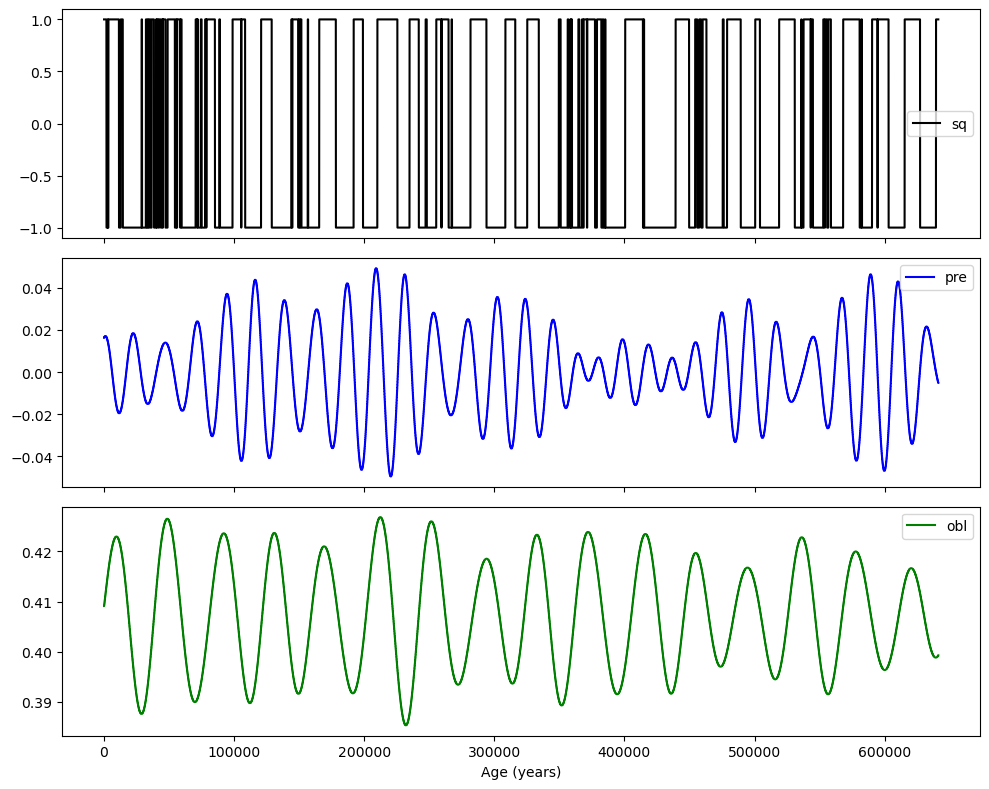

          age   sq
0           0  1.0
1          10  1.0
2          20  1.0
3          30  1.0
4          40  1.0
...       ...  ...
64121  641210  1.0
64122  641220  1.0
64123  641230  1.0
64124  641240  1.0
64125  641250  1.0

[64126 rows x 2 columns]
          age       pre
0           0  0.016280
1          10  0.016280
2          20  0.016280
3          30  0.016280
4          40  0.016280
...       ...       ...
64121  641210 -0.005173
64122  641220 -0.005173
64123  641230 -0.005173
64124  641240 -0.005173
64125  641250 -0.005173

[64126 rows x 2 columns]
Length of df_sq_rs: 64126


In [34]:
from toolbox import sq_ana as sa 
import importlib
importlib.reload(sa)

df_sq, df_pre, df_obl = sa.interpolate_data_forcing(df_sq, 10, if_plot=True)
print(df_sq)
print(df_pre)
# print the length of df_sq_rs and df_pre_rs
print('Length of df_sq_rs:', len(df_sq))

TE(pre→residual) = 0.0010 bits


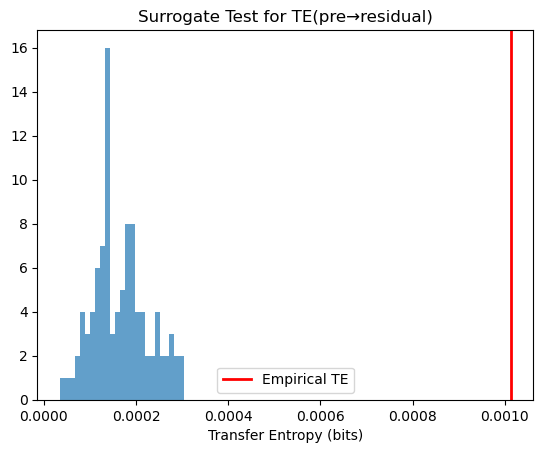

p-value = 0.000


In [35]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from pyinform import transfer_entropy  # correct import! :contentReference[oaicite:0]{index=0}

# — assume df_pre_aligned['pre'] and df_residual['residual'] exist and are same length
x = df_pre['pre'].values      # source (precession)
y = df_sq['sq'].values    # target (residual)

# flip x and y upside down
x = x[::-1]
y = y[::-1]

# 1) Discretize into nbins equiprobable bins
nbins = 8
xbins = np.histogram_bin_edges(x, bins=nbins)
ybins = np.histogram_bin_edges(y, bins=nbins)
x_disc = np.digitize(x, xbins) - 1
y_disc = np.digitize(y, ybins) - 1

# 2) Compute TE from pre→residual with history length k=1
#    note: drop last/first sample to align t→t+1
te_xy = transfer_entropy(x_disc[:-1], y_disc[1:], k=1)
print(f"TE(pre→residual) = {te_xy:.4f} bits")

# 3) Permutation‐based surrogate test
n_surr = 100
te_null = np.zeros(n_surr)
for i in range(n_surr):
    xs = np.random.permutation(x_disc)
    te_null[i] = transfer_entropy(xs[:-1], y_disc[1:], k=1)

# 4) Plot null distribution
plt.hist(te_null, bins=25, alpha=0.7)
plt.axvline(te_xy, color='r', lw=2, label='Empirical TE')
plt.xlabel('Transfer Entropy (bits)')
plt.legend()
plt.title('Surrogate Test for TE(pre→residual)')
plt.show()

# 5) Compute p-value
p_value = np.mean(te_null >= te_xy)
print(f"p-value = {p_value:.3f}")

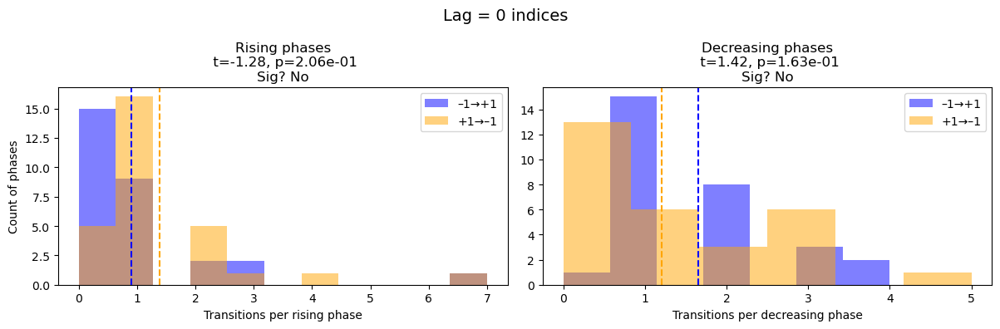

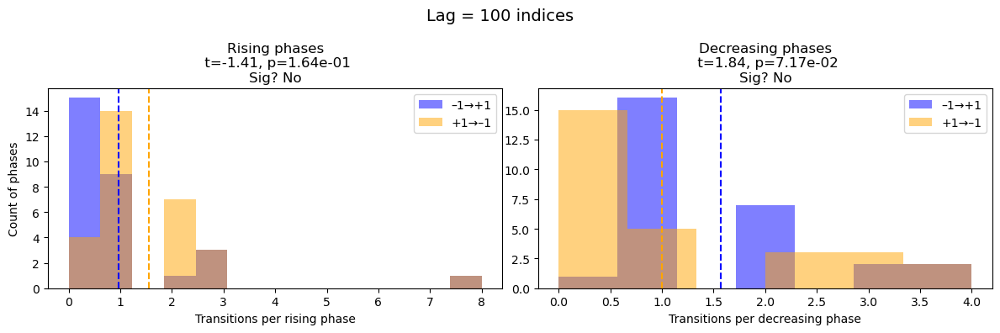

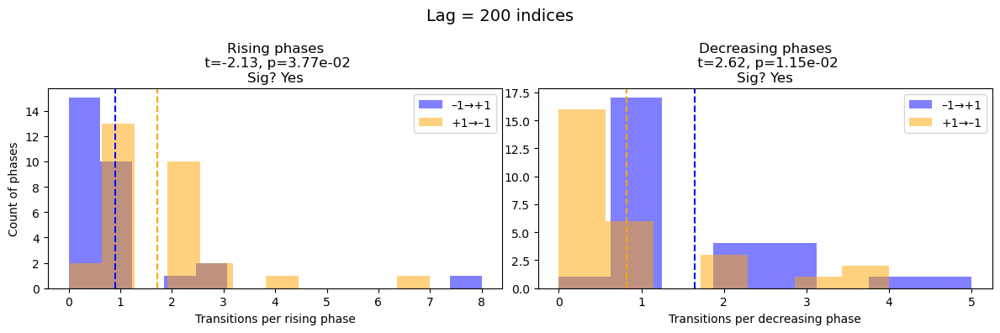

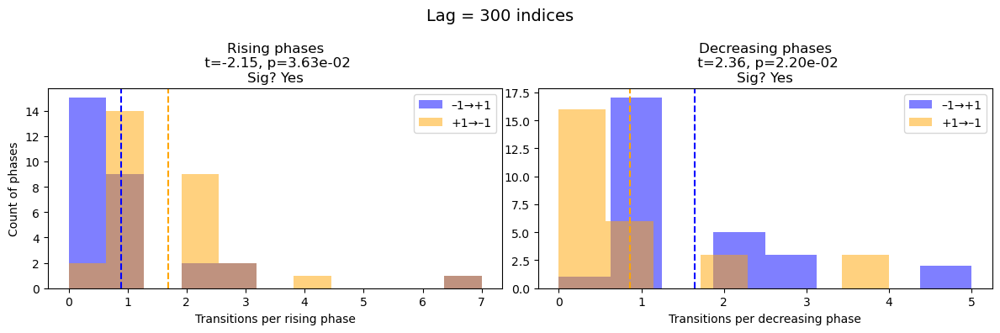

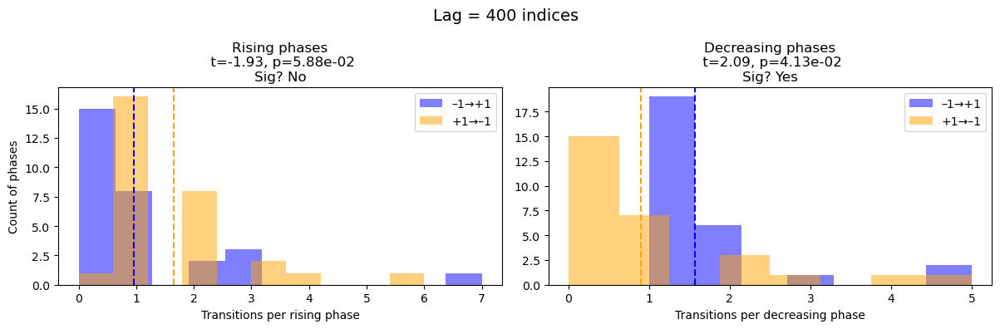

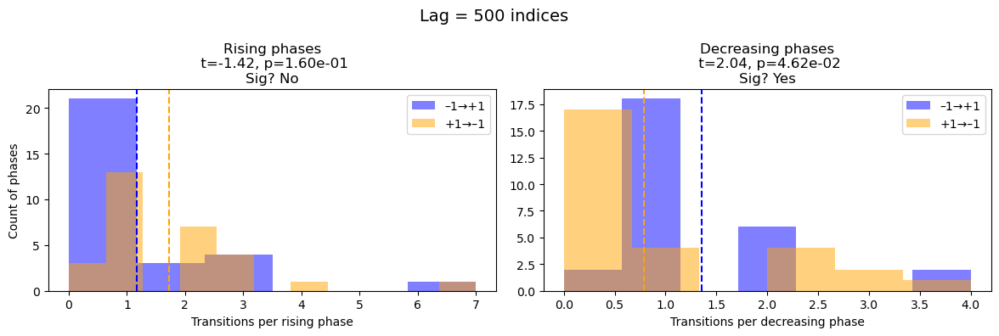

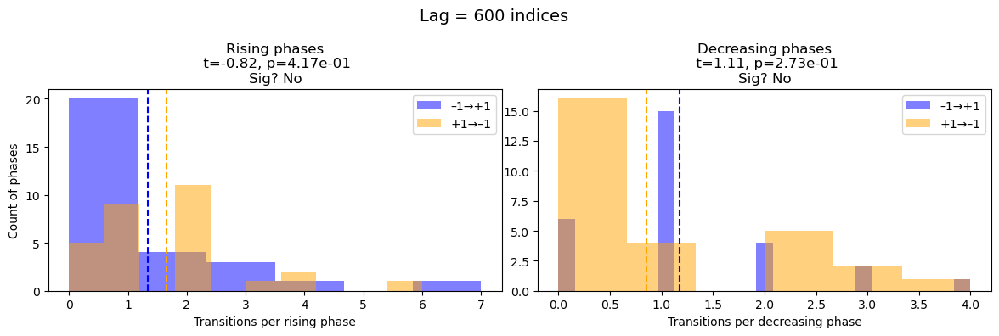

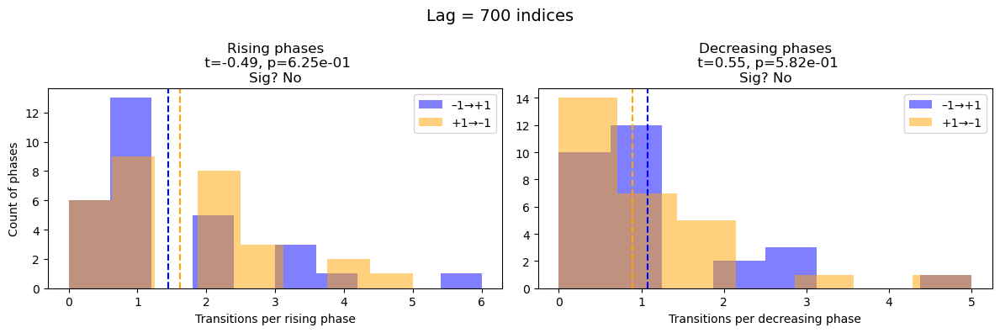

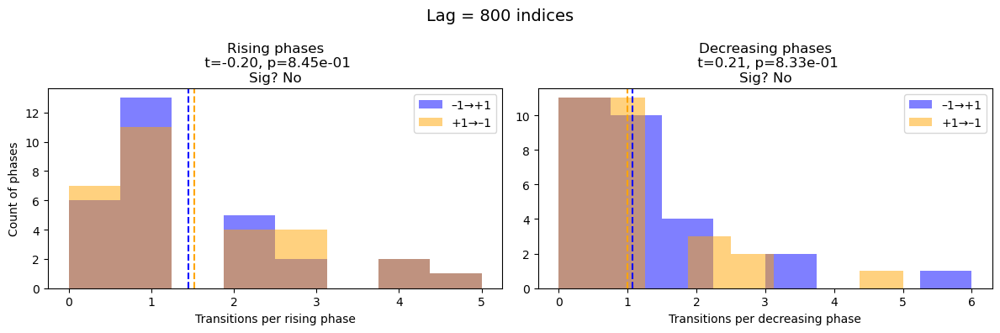

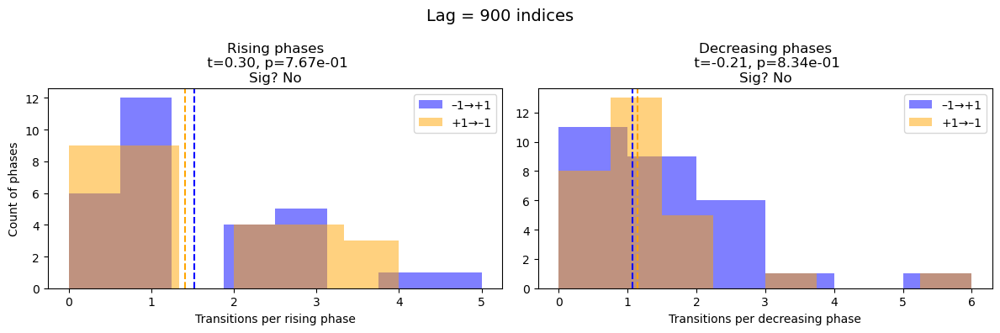

In [36]:
from toolbox import sq_ana as sa 
import importlib
importlib.reload(sa)

sa.plot_transition_distribution(df_pre, df_sq)

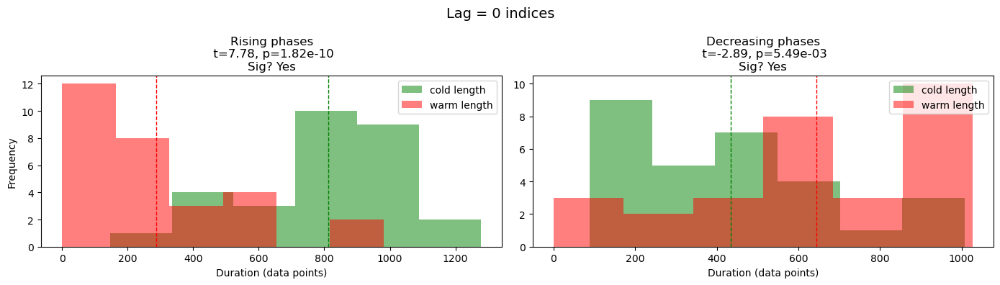

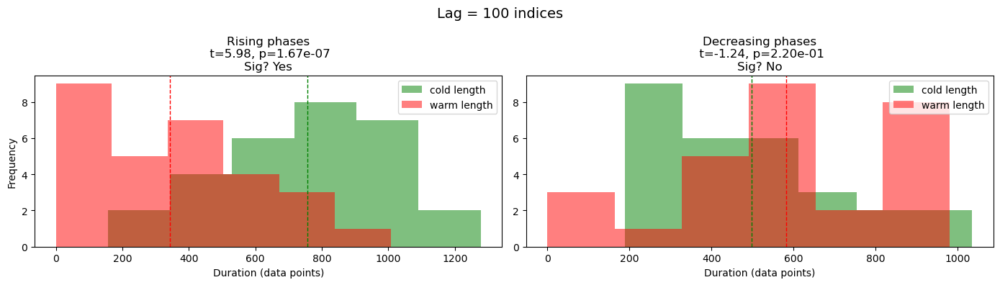

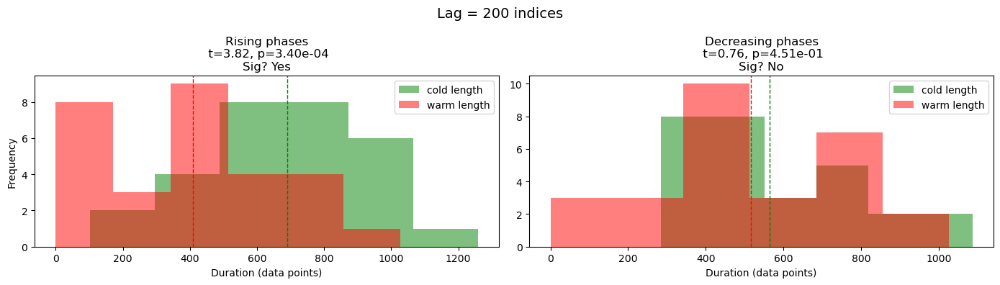

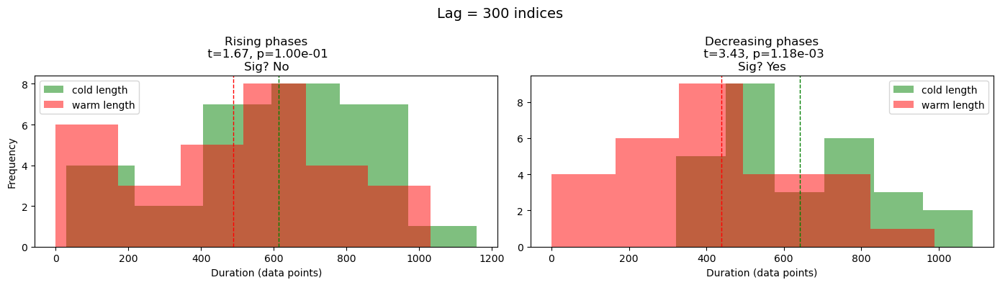

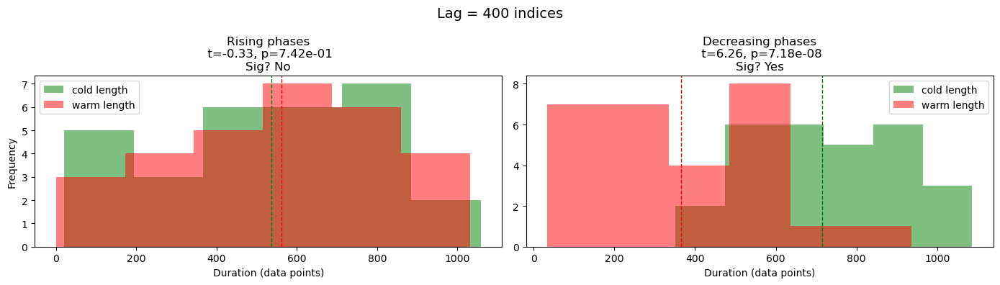

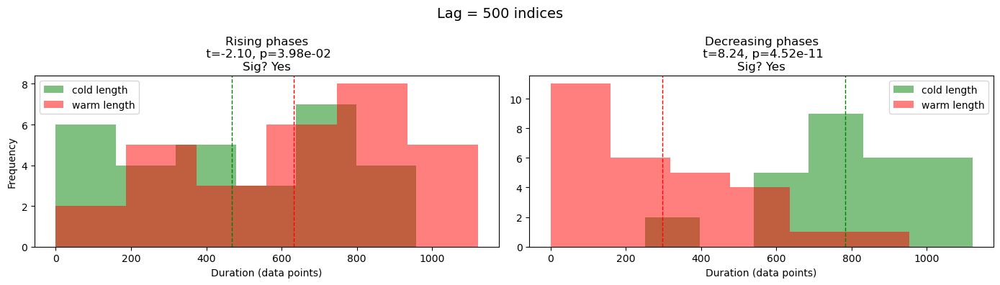

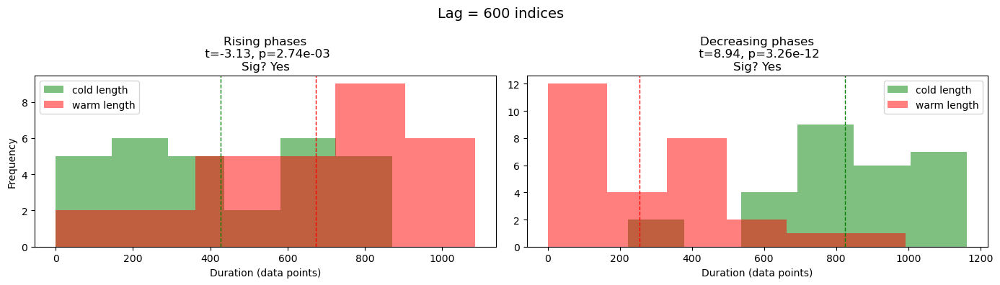

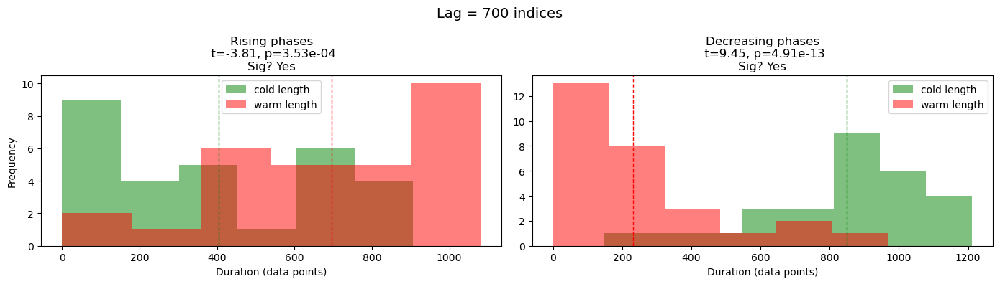

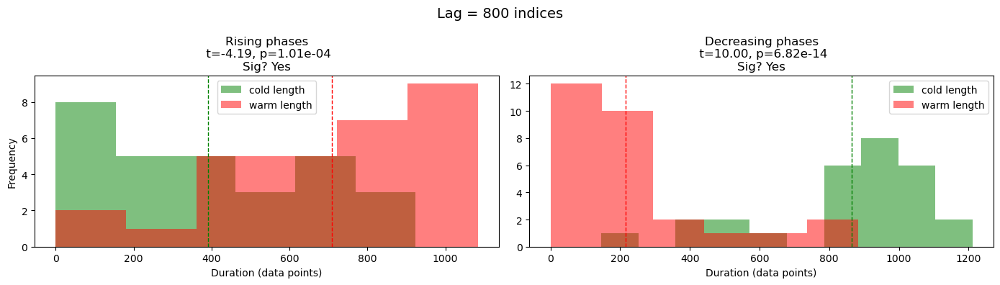

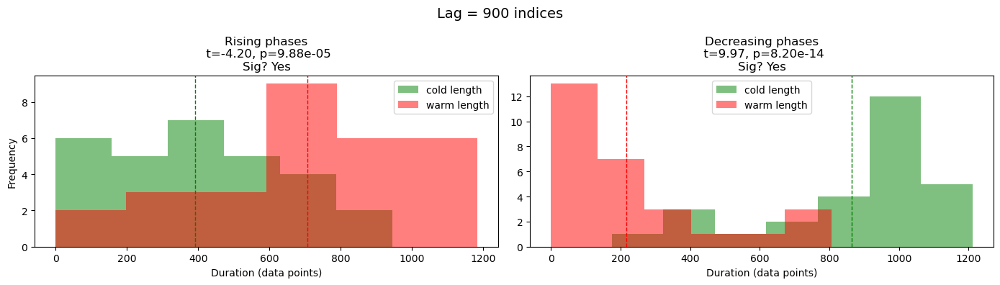

In [37]:
from toolbox import sq_ana as sa 
import importlib
importlib.reload(sa)

sa.plot_phase_durations(df_pre, df_sq)

In [37]:
import numpy as np
import matplotlib.pyplot as plt

def warm_sequence(sq, pre, age, shift=0, show_plot=True):
    """
    Identify warm periods in a square wave series with optional precession delay
    and sample precession data.

    Parameters:
        sq (np.ndarray): Square wave series of low/high values.
        pre (np.ndarray): Precession data, same length as sq.
        age (np.ndarray): Time axis corresponding to sq and pre.
        shift (int): Number of data points to shift pre rightward (>=0).
        show_plot (bool): Whether to plot the results.

    Returns:
        time_axis (np.ndarray): Sequence indices for each warm period.
        durations (np.ndarray): Duration of each warm period in same units as age.
        pre_samples (np.ndarray): Values of pre at the start of each warm period.
    """
    if not (sq.shape == pre.shape == age.shape):
        raise ValueError("sq, pre, and age must have the same shape.")
    if not isinstance(shift, int) or shift < 0:
        raise ValueError("shift must be a non-negative integer.")
    if shift > 0:
        if shift >= len(sq):
            raise ValueError("shift is too large for series length.")
        sq = sq[shift:]
        pre = pre[:-shift]
        age = age[shift:]

    dt = np.diff(age)
    if not np.allclose(dt, dt[0]):
        print("Warning: irregular spacing in age. Using median dt.")
    res = np.median(dt)

    uniq = np.unique(sq)
    if uniq.size != 2:
        raise ValueError("sq must be a binary series with two unique values.")
    low, high = uniq[0], uniq[-1]

    rising_edges = np.where((sq[:-1] == low) & (sq[1:] == high))[0] + 1

    durations = []
    pre_samples = []
    for start in rising_edges:
        drops = np.where(sq[start:] == low)[0]
        length = drops[0] if drops.size > 0 else (len(sq) - start)
        durations.append(length * res)
        pre_samples.append(pre[start])

    durations = np.array(durations)
    pre_samples = np.array(pre_samples)
    time_axis = np.arange(len(durations))

    if show_plot:
        fig, (ax1, ax2) = plt.subplots(2, 1, sharex=True)
        ax1.plot(time_axis, durations)
        ax1.set_ylabel("Warm period duration")
        ax2.plot(time_axis, pre_samples)
        ax2.set_ylabel("Precession at warm start")
        ax2.set_xlabel("Event index")
        plt.tight_layout()
        plt.show()

    return time_axis, durations, pre_samples


def cold_sequence(sq, pre, age, shift=0, show_plot=True):
    """
    Identify cold periods in a square wave series with optional precession delay
    and sample precession data.

    Parameters and returns mirror warm_sequence but for cold periods.
    """
    if not (sq.shape == pre.shape == age.shape):
        raise ValueError("sq, pre, and age must have the same shape.")
    if not isinstance(shift, int) or shift < 0:
        raise ValueError("shift must be a non-negative integer.")
    if shift > 0:
        if shift >= len(sq):
            raise ValueError("shift is too large for series length.")
        sq = sq[shift:]
        pre = pre[:-shift]
        age = age[shift:]

    dt = np.diff(age)
    if not np.allclose(dt, dt[0]):
        print("Warning: irregular spacing in age. Using median dt.")
    res = np.median(dt)

    uniq = np.unique(sq)
    if uniq.size != 2:
        raise ValueError("sq must be a binary series with two unique values.")
    low, high = uniq[0], uniq[-1]

    falling_edges = np.where((sq[:-1] == high) & (sq[1:] == low))[0] + 1

    durations = []
    pre_samples = []
    for start in falling_edges:
        rises = np.where(sq[start:] == high)[0]
        length = rises[0] if rises.size > 0 else (len(sq) - start)
        durations.append(length * res)
        pre_samples.append(pre[start])

    durations = np.array(durations)
    pre_samples = np.array(pre_samples)
    time_axis = np.arange(len(durations))

    if show_plot:
        fig, (ax1, ax2) = plt.subplots(2, 1, sharex=True)
        ax1.plot(time_axis, durations)
        ax1.set_ylabel("Cold period duration")
        ax2.plot(time_axis, pre_samples)
        ax2.set_ylabel("Precession at cold start")
        ax2.set_xlabel("Event index")
        plt.tight_layout()
        plt.show()

    return time_axis, durations, pre_samples


def combined_sequence(sq, pre, age, shift=0, show_plot=True):
    """
    Combine warm and cold sequence analysis into one series of events.

    Warm durations are positive; cold durations are negative.

    Parameters:
        sq (np.ndarray): Binary square wave series.
        pre (np.ndarray): Precession data.
        age (np.ndarray): Time axis.
        shift (int): Rightward shift on pre before analysis.
        show_plot (bool): Plot durations and sampled pre for both events.

    Returns:
        time_axis (np.ndarray): Event indices.
        durations (np.ndarray): Signed durations (+warm, -cold).
        pre_samples (np.ndarray): Precession at each event start.
    """
    # Validate and apply shift
    if not (sq.shape == pre.shape == age.shape):
        raise ValueError("sq, pre, and age must have the same shape.")
    if not isinstance(shift, int) or shift < 0:
        raise ValueError("shift must be a non-negative integer.")
    if shift > 0:
        if shift >= len(sq):
            raise ValueError("shift is too large for series length.")
        sq = sq[shift:]
        pre = pre[:-shift]
        age = age[shift:]

    # Compute resolution
    dt = np.diff(age)
    if not np.allclose(dt, dt[0]):
        print("Warning: irregular spacing in age. Using median dt.")
    res = np.median(dt)

    # Determine binary levels
    uniq = np.unique(sq)
    if uniq.size != 2:
        raise ValueError("sq must be a binary series with two unique values.")
    low, high = uniq[0], uniq[-1]

    # Find transitions
    rising_edges = np.where((sq[:-1] == low) & (sq[1:] == high))[0] + 1
    falling_edges = np.where((sq[:-1] == high) & (sq[1:] == low))[0] + 1

    # Collect events: (index, signed_duration, pre_value)
    events = []
    for start in rising_edges:
        drops = np.where(sq[start:] == low)[0]
        length = drops[0] if drops.size > 0 else (len(sq) - start)
        events.append((start, length * res, pre[start]))
    for start in falling_edges:
        rises = np.where(sq[start:] == high)[0]
        length = rises[0] if rises.size > 0 else (len(sq) - start)
        events.append((start, -length * res, pre[start]))

    # Sort and unpack
    events.sort(key=lambda x: x[0])
    durations = np.array([e[1] for e in events])
    pre_samples = np.array([e[2] for e in events])
    time_axis = np.arange(len(events))

    # Plot if requested
    if show_plot:
        fig, (ax1, ax2) = plt.subplots(2, 1, sharex=True)
        mask_warm = durations > 0
        mask_cold = durations < 0
        ax1.scatter(time_axis[mask_warm], durations[mask_warm], marker='o', label='warm')
        ax1.scatter(time_axis[mask_cold], durations[mask_cold], marker='x', label='cold')
        ax1.set_ylabel("Event duration")
        ax1.legend()

        ax2.scatter(time_axis[mask_warm], pre_samples[mask_warm], marker='o', label='warm')
        ax2.scatter(time_axis[mask_cold], pre_samples[mask_cold], marker='x', label='cold')
        ax2.set_ylabel("Precession at event start")
        ax2.set_xlabel("Event index")
        ax2.legend()

        plt.tight_layout()
        plt.show()

    return time_axis, durations, pre_samples

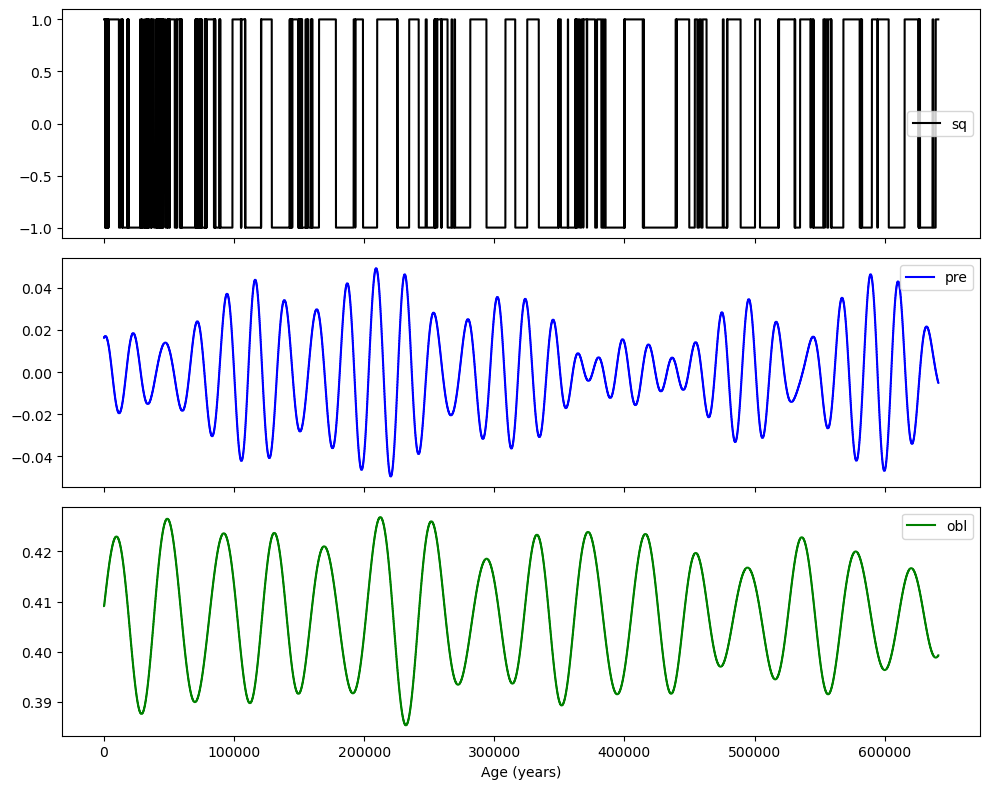

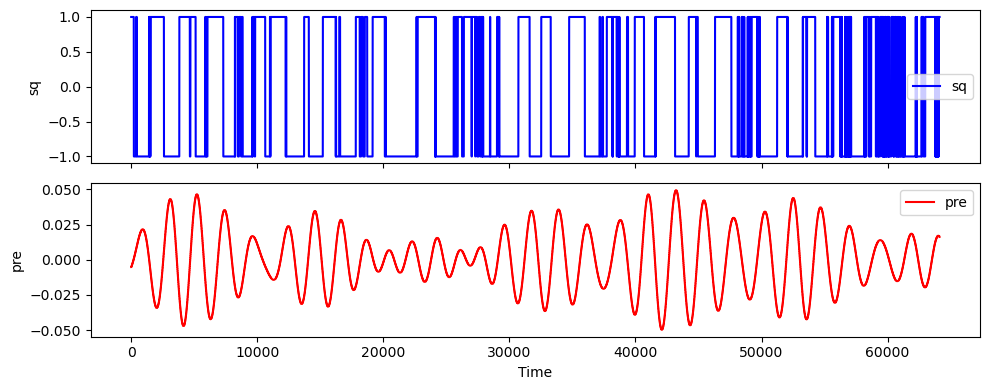

In [16]:
from toolbox import sq_ana as sa 
import importlib
importlib.reload(sa)

df_sq_rs, df_pre_rs, df_obl_rs = sa.interpolate_data_forcing(df_sq, 10, if_plot=True)
# print(df_sq_rs)
# print(df_pre_rs)



sq=df_sq['sq'].values
pre=df_pre['pre'].values

# flip sq and pre upside down
sq = sq[::-1]
pre = pre[::-1]

# plot the data in two by 1 subplot
fig, axs = plt.subplots(2, 1, figsize=(10, 4), sharex=True)
axs[0].plot(sq, color='blue', label='sq')
axs[0].set_ylabel('sq')
axs[0].legend()
axs[1].plot(pre, color='red', label='pre')
axs[1].set_ylabel('pre')
axs[1].legend()
axs[1].set_xlabel('Time')
plt.tight_layout()
plt.show()





In [20]:
print(len(new_time))

168


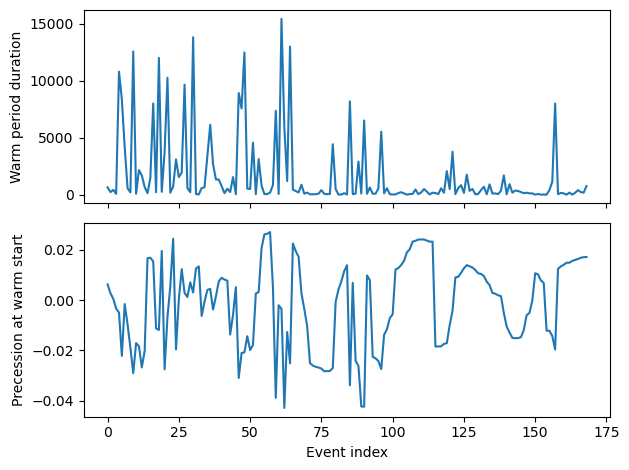

169


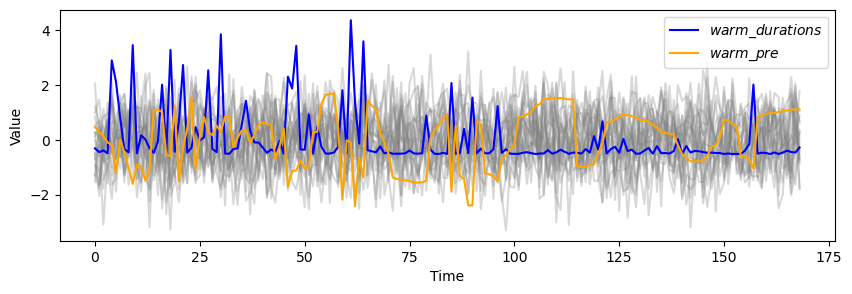

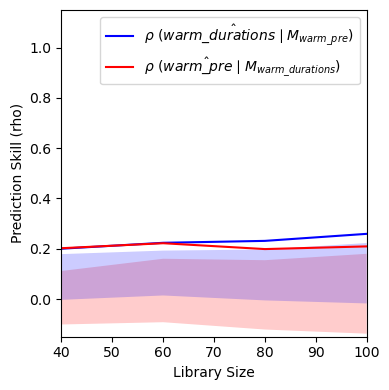

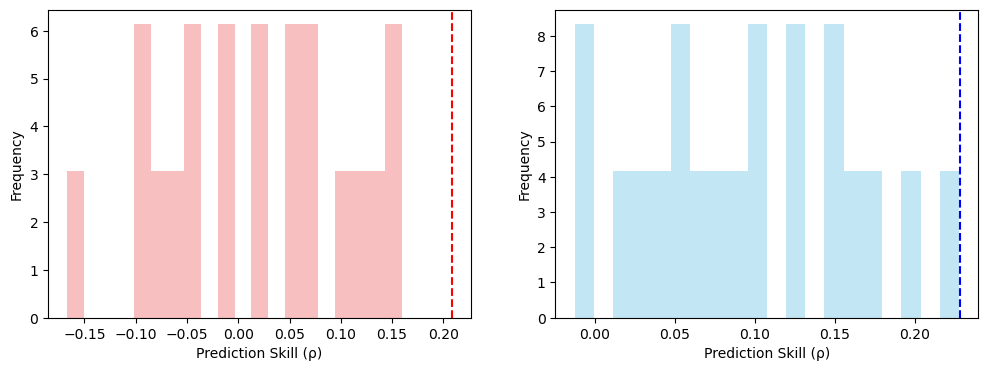

   LibSize       X:Y       Y:X
0     40.0  0.202124  0.200211
1     60.0  0.222038  0.223724
2     80.0  0.198735  0.231366
3    100.0  0.209414  0.259330
0.20941370026532416


In [31]:
from toolbox import significant_test as st
import importlib
importlib.reload(st)




new_time,warm_durations,warm_pre = warm_sequence(sq, pre, df_sq['age'].values, shift=30, show_plot=True)
print(len(new_time))

df_warm = pd.DataFrame({'age': new_time, 'warm_durations': warm_durations})
df_pre_warm = pd.DataFrame({'age': new_time, 'warm_pre': warm_pre})

ccm_out, ran_ccm_list_xy, test_result=st.ccm_significance_test_v3(
    df_warm, 
    df_pre_warm,
    E=6, 
    tau=-5, 
    n_ran=20, 
    libSizes="40 60 80 100",
    Tp=0,
    sample=20,
    random=True,
    uni_dir=False,
    showPlot=True)

print(ccm_out)
print(ccm_out[ 'X:Y' ][len(ccm_out[ 'X:Y' ])-1])

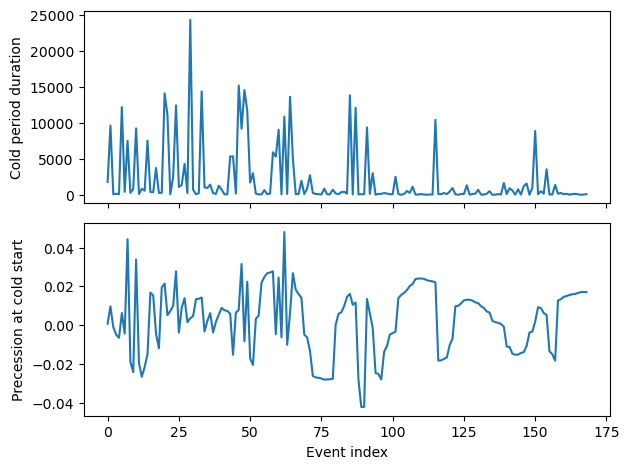

169


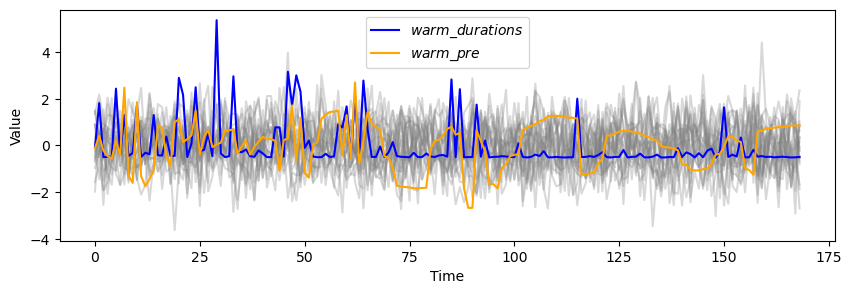

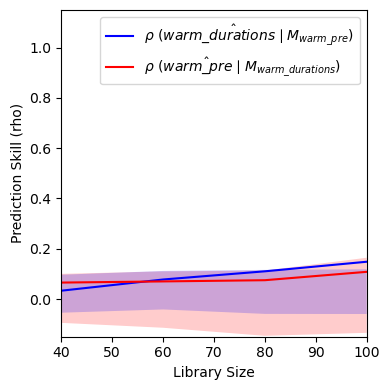

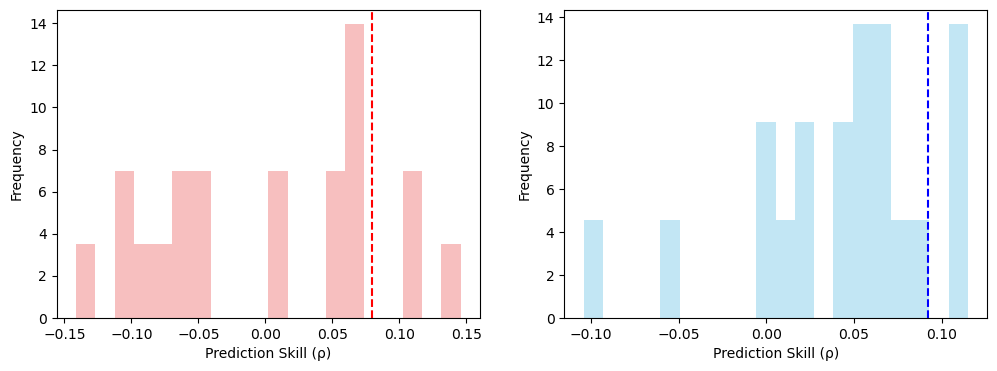

   LibSize       X:Y       Y:X
0     40.0  0.065427  0.033164
1     60.0  0.070070  0.077727
2     80.0  0.074874  0.110304
3    100.0  0.108227  0.148351
0.10822723781646


In [33]:
from toolbox import significant_test as st
import importlib
importlib.reload(st)




new_time,warm_durations,warm_pre = cold_sequence(sq, pre, df_sq['age'].values, shift=0, show_plot=True)
print(len(new_time))

df_warm = pd.DataFrame({'age': new_time, 'warm_durations': warm_durations})
df_pre_warm = pd.DataFrame({'age': new_time, 'warm_pre': warm_pre})

ccm_out, ran_ccm_list_xy, test_result=st.ccm_significance_test_v3(
    df_warm, 
    df_pre_warm,
    E=6, 
    tau=-5, 
    n_ran=20, 
    libSizes="40 60 80 100",
    Tp=0,
    sample=20,
    random=True,
    uni_dir=False,
    showPlot=True)

print(ccm_out)
print(ccm_out[ 'X:Y' ][len(ccm_out[ 'X:Y' ])-1])

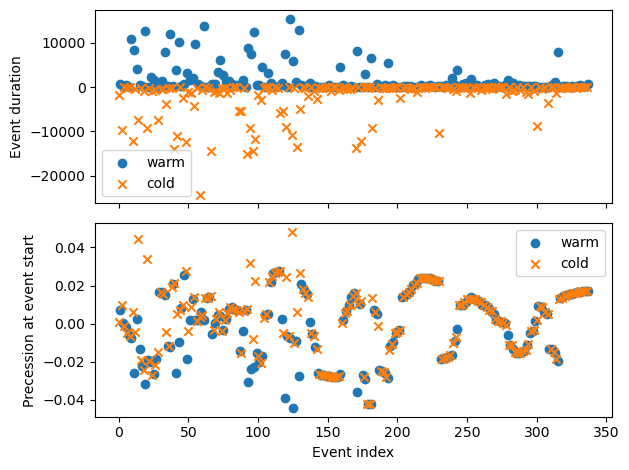

338


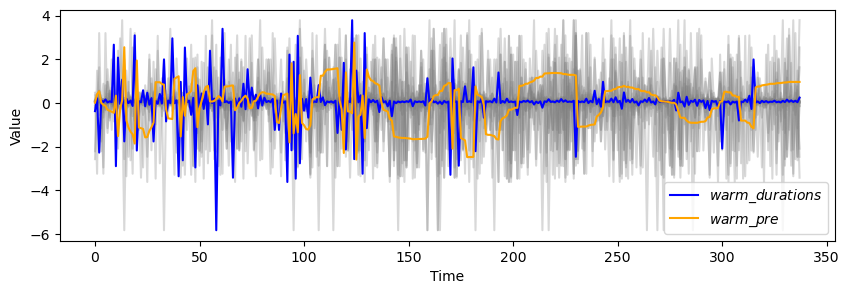

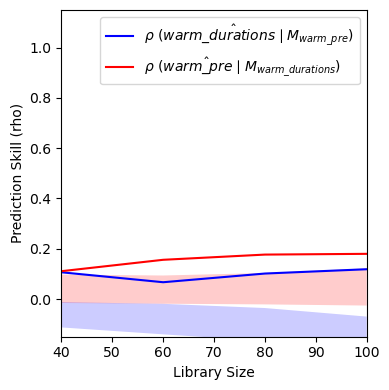

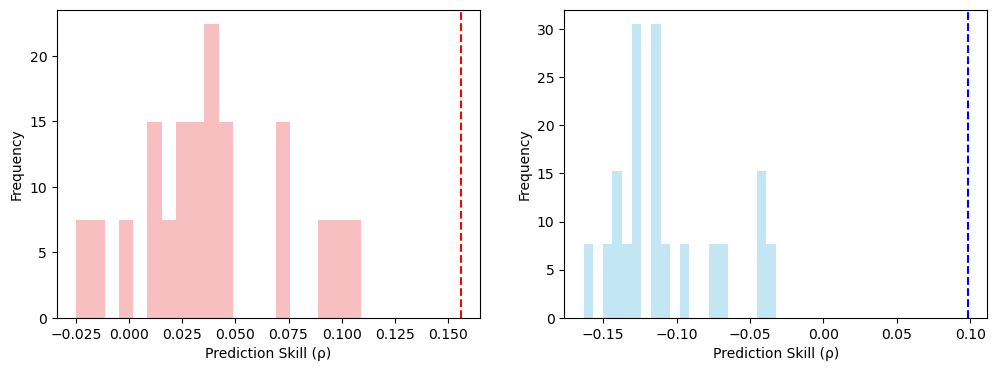

   LibSize       X:Y       Y:X
0     40.0  0.110732  0.106387
1     60.0  0.156079  0.066829
2     80.0  0.176803  0.101391
3    100.0  0.179787  0.118521
0.17978698532863058


In [40]:
from toolbox import significant_test as st
import importlib
importlib.reload(st)




new_time,warm_durations,warm_pre = combined_sequence(sq, pre, df_sq['age'].values, shift=0, show_plot=True)
print(len(new_time))

df_warm = pd.DataFrame({'age': new_time, 'warm_durations': warm_durations})
df_pre_warm = pd.DataFrame({'age': new_time, 'warm_pre': warm_pre})

ccm_out, ran_ccm_list_xy, test_result=st.ccm_significance_test_v2(
    df_warm, 
    df_pre_warm,
    E=6, 
    tau=-5, 
    n_ran=20, 
    libSizes="40 60 80 100",
    Tp=0,
    sample=20,
    random=True,
    uni_dir=False,
    showPlot=True)

print(ccm_out)
print(ccm_out[ 'X:Y' ][len(ccm_out[ 'X:Y' ])-1])

In [7]:
sq.shape

(64126,)

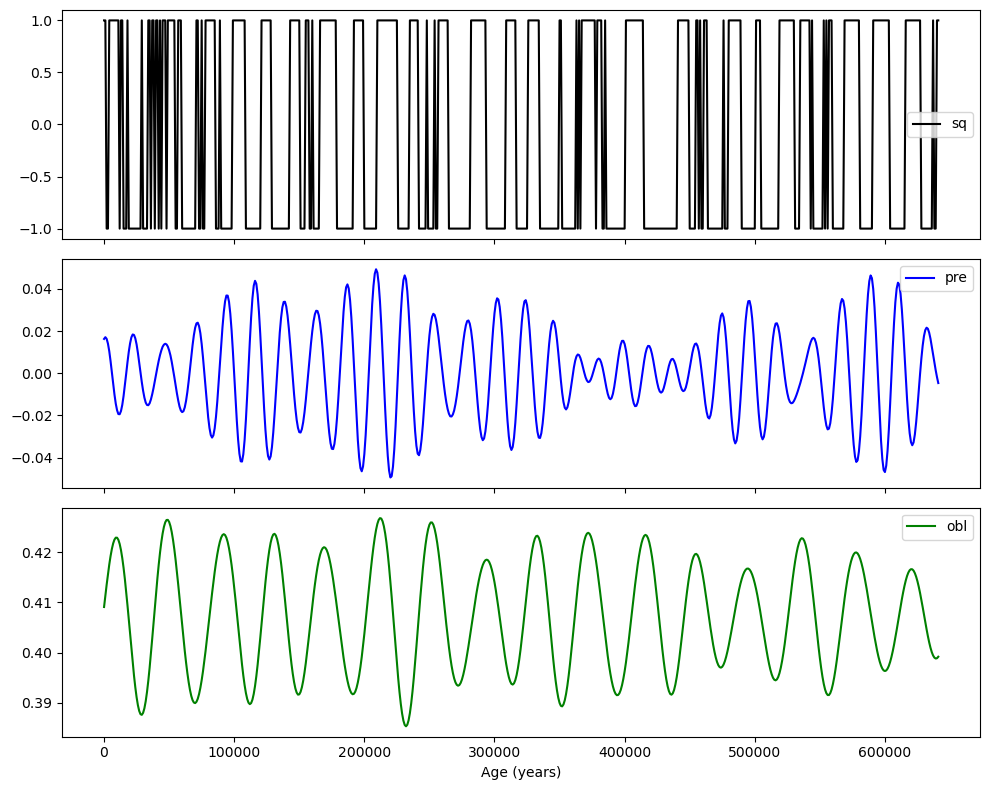

        age   sq
0         0  1.0
1      1000  1.0
2      2000 -1.0
3      3000 -1.0
4      4000  1.0
..      ...  ...
637  637000  1.0
638  638000 -1.0
639  639000 -1.0
640  640000  1.0
641  641000  1.0

[642 rows x 2 columns]
        age       pre
0         0  0.016280
1      1000  0.017116
2      2000  0.016308
3      3000  0.014018
4      4000  0.010453
..      ...       ...
637  637000  0.008929
638  638000  0.005100
639  639000  0.001432
640  640000 -0.001830
641  641000 -0.004658

[642 rows x 2 columns]


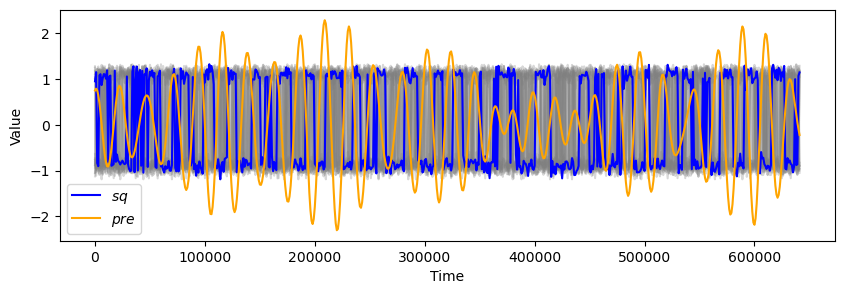

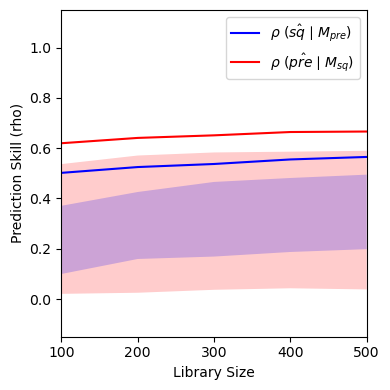

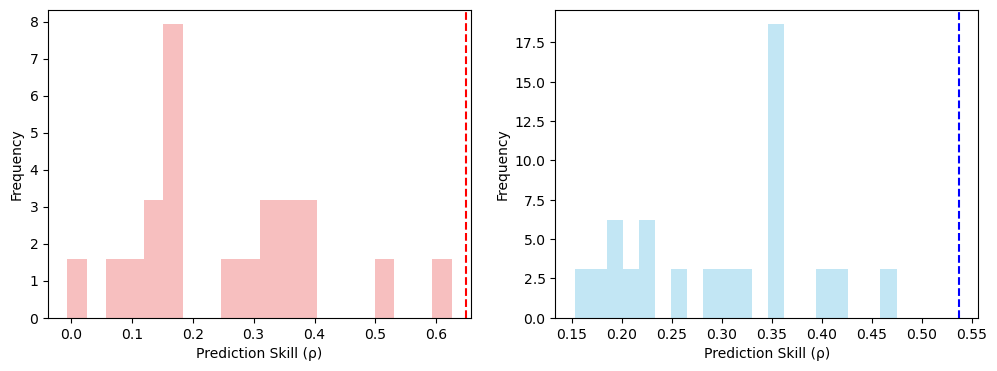

In [4]:
from toolbox import sq_ana as sa 
import importlib
importlib.reload(sa)

df_sq_rs, df_pre_rs, df_obl_rs = sa.interpolate_data_forcing(df_sq, 1000, if_plot=True)
print(df_sq_rs)
print(df_pre_rs)
from toolbox import significant_test as st
import importlib
importlib.reload(st)

# add white noise to df_sq_rs
import numpy as np
white_noise = np.random.normal(0, 0.1, len(df_sq_rs['sq'].values))
df_sq_rs_noise = df_sq_rs.copy()
df_sq_rs_noise['sq'] = df_sq_rs_noise['sq'] + white_noise


ccm_out, ran_ccm_list_xy, test_result=st.ccm_significance_test_v2(
    df_sq_rs_noise, 
    df_pre_rs,
    E=6, 
    tau=-5, 
    n_ran=20, 
    libSizes="100 200 300 400 500",
    Tp=0,
    sample=20,
    random=True,
    uni_dir=False,
    showPlot=True)

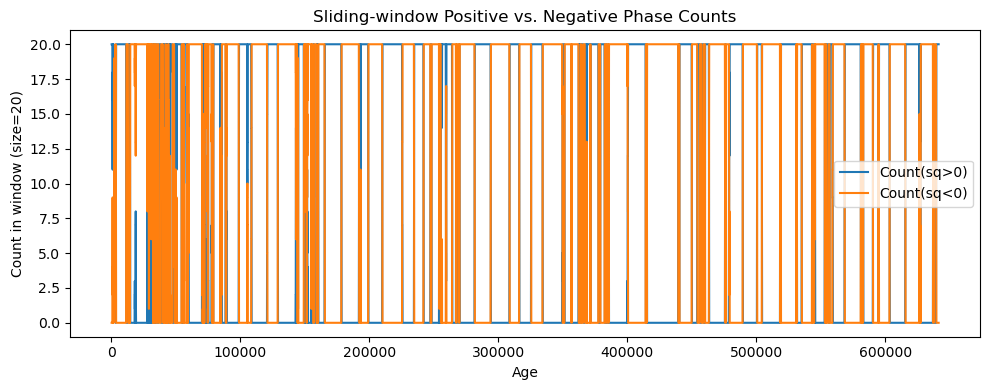

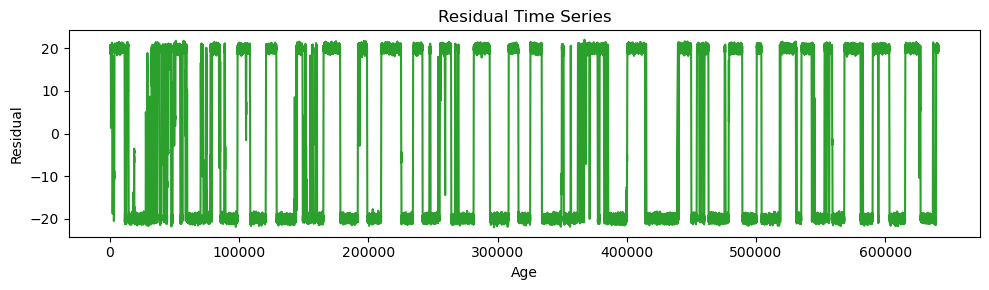

: 

In [5]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from toolbox import significant_test as st
import importlib
importlib.reload(st)

# --- Parameters ---
window_size = 20

# --- 1) Compute moving‐window phase counts ---
sq_vals = df_sq['sq'].values
N       = len(sq_vals)
n_win   = N - window_size + 1

pos_counts = np.empty(n_win, dtype=int)
neg_counts = np.empty(n_win, dtype=int)
# For plotting, we can assign each window an “age” at its right edge:
ages = df_sq['age'].values[window_size-1 : ]

for i in range(n_win):
    w = sq_vals[i : i + window_size]
    pos_counts[i] = np.sum(w >  0)
    neg_counts[i] = np.sum(w <  0)

# --- 2) Plot positive vs. negative counts ---
plt.figure(figsize=(10,4))
plt.plot(ages, pos_counts, label='Count(sq>0)', color='tab:blue')
plt.plot(ages, neg_counts, label='Count(sq<0)', color='tab:orange')
plt.xlabel('Age')
plt.ylabel('Count in window (size=20)')
plt.title('Sliding‐window Positive vs. Negative Phase Counts')
plt.legend()
plt.tight_layout()
plt.show()

# --- 3) Compute and plot the “residual” time series ---
residual = pos_counts - neg_counts

# adding some noise to the residual
white_noise = np.random.normal(0, 0.5, len(residual))
residual = residual + white_noise

plt.figure(figsize=(10,3))
plt.plot(ages, residual, label='Residual = pos_counts - neg_counts', color='tab:green')
plt.xlabel('Age')
plt.ylabel('Residual')
plt.title('Residual Time Series')
plt.tight_layout()
plt.show()

# --- 4) Prepare for CCM: align residual and precession ---
#   Residual has length n_win, so drop the first (window_size-1) rows of df_pre:
df_pre_aligned = df_pre.iloc[window_size-1 : ].reset_index(drop=True)

#   Make a small DataFrame for residual
df_residual = pd.DataFrame({
    'age':      ages,
    'residual': residual
})

# --- 5) Run your CCM significance test ---
ccm_out, ran_ccm_list_xy, test_result = st.ccm_significance_test_v2(
    df_residual,           # now our “driver” series
    df_pre_aligned,        # target (precession), same length as residual
    E=6,
    tau=-5,
    n_ran=20,
    libSizes="100 200 300 400 500",
    Tp=0,
    sample=20,
    random=True,
    uni_dir=False,
    showPlot=True
)

print(test_result)


→ optimal window=4900, threshold gt -0.263, max F1=0.764


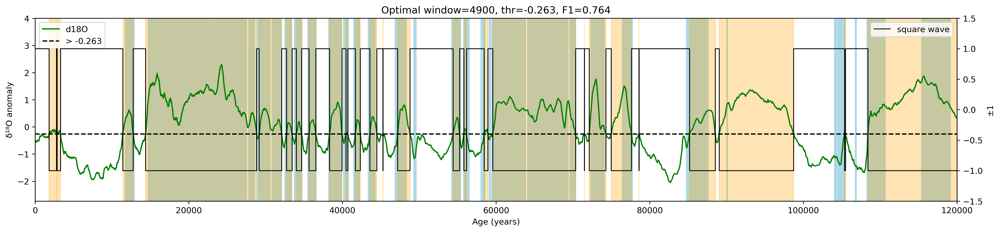

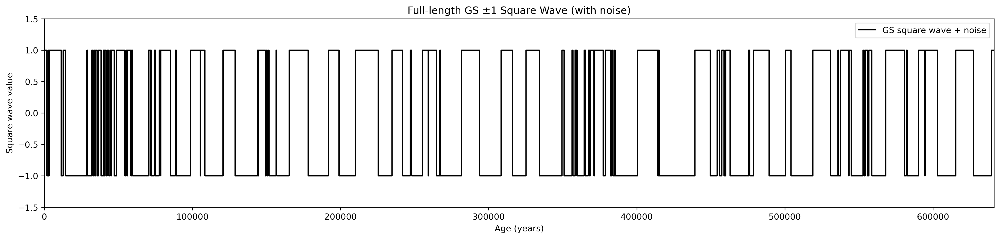

In [52]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from itertools import groupby
from scipy.interpolate import interp1d

# --- 0) load & interpolate as before ---
file_path = r"D:\VScode\bipolar_seesaw_CCM\other_data\monsoon.xlsx"
df = pd.read_excel(file_path)
df['age'] = df['age'] * 1000

# resample to 10-yr steps
new_age = np.arange(0, 641260, 10)
f = interp1d(df['age'], df['d18O'], kind='nearest',
             bounds_error=False, fill_value=1)
new_df = pd.DataFrame({
    'age': new_age,
    'd18O': f(new_age)
})

# --- 1) GS ground-truth table ---
gs_data = {
    "start": [11703, 14692, 23020, 23340, 27780, 28900, 30840, 32500, 33740, 35480,
              38220, 40160, 41460, 43340, 46860, 49280, 54220, 55000, 55800, 58040,
              58280, 59080, 59440, 64100, 69620, 72340, 76440, 84760, 85060, 90040,
              104040,104520,106750,108280,115370],
    "end":   [12896, 22900, 23220, 27540, 28600, 30600, 32040, 33360, 34740, 36580,
              39900, 40800, 42240, 44280, 48340, 49600, 54900, 55400, 56500, 58160,
              58560, 59300, 63840, 69400, 70380, 74100, 77760, 84960, 87600, 90140,
              104380,105440,106900,110640,119140]
}
# make ground truth mask on cropped (<120k yr)
mask_true_full = np.zeros_like(new_df['age'].values, dtype=bool)
for s, e in zip(gs_data["start"], gs_data["end"]):
    mask_true_full |= (new_df['age'] >= s) & (new_df['age'] <= e)

mask_true_crop = mask_true_full & (new_df['age'] < 120_000)

# F1 helper
def f1_score(pred, true):
    tp = np.sum(pred & true)
    fp = np.sum(pred & ~true)
    fn = np.sum(~pred & true)
    return 2*tp/(2*tp + fp + fn) if (2*tp + fp + fn)>0 else 0

# --- 2) grid‐search over window & threshold ---
window_range = np.arange(3_000, 20_001, 1_00)
# thr_cands = np.linspace(-1, 1, 201)  # adjust range if needed


best = {'window':None, 'thr':None, 'dir':None, 'f1':-1}

for w in window_range:
    # low‐freq smoothing & anomaly
    smooth_lo = new_df['d18O'].rolling(window=w, center=True, min_periods=1).mean()
    anomaly = new_df['d18O'] - smooth_lo
    # optional 50-pt smoothing of anomaly
    anomaly_sm = anomaly.rolling(window=50, center=True, min_periods=1).mean()
    
    # crop to <120k for scoring
    vals = anomaly_sm.values[ new_df['age'] < 120_000 ]
    true = mask_true_crop[ new_df['age'] < 120_000 ]


    thr_min = vals.min()
    thr_max = vals.max()
    step    = (thr_max - thr_min) / 100.0
    thr_cands = np.linspace(thr_min, thr_max, 101)
    
    # scan threshold & direction
    for direction in ('gt','lt'):
        for thr in thr_cands:
            pred = (vals > thr) if direction=='gt' else (vals < thr)
            score = f1_score(pred, true)
            if score > best['f1']:
                best.update(window=w, thr=thr, dir=direction, f1=score)

print(f"→ optimal window={best['window']}, "
      f"threshold {best['dir']} {best['thr']:.3f}, "
      f"max F1={best['f1']:.3f}")

# --- 3) build final square wave over full record ---
lo = new_df['d18O'].rolling(window=best['window'],
                            center=True, min_periods=1).mean()
anom = new_df['d18O'] - lo
anom_sm = anom.rolling(window=50, center=True, min_periods=1).mean().values

if best['dir']=='gt':
    is_gs_pred = anom_sm > best['thr']
else:
    is_gs_pred = anom_sm < best['thr']

square_wave = np.where(is_gs_pred, -1, 1)

# --- fix here: build segments safely ---
ages_all = new_df['age'].values
segments = []
for val, grp in groupby(enumerate(is_gs_pred), key=lambda x: x[1]):
    if val:
        grp_list = list(grp)
        start_idx = grp_list[0][0]
        end_idx   = grp_list[-1][0]
        segments.append((ages_all[start_idx], ages_all[end_idx]))


# --- 4) plot final result ---
fig, ax = plt.subplots(figsize=(20,4), dpi=300)

# official GS spans
for s,e in zip(gs_data["start"], gs_data["end"]):
    ax.axvspan(s, e, color='lightblue', alpha=1, zorder=0)
# predicted spans
for s,e in segments:
    ax.axvspan(s, e, color='orange', alpha=0.3, zorder=1)

# δ18O anomaly curve
ax.plot(new_df['age'], anom_sm, color='green', label='d18O')

# threshold line
thr_line = best['thr']
ax.axhline(thr_line, linestyle='--', color='black',
           label=f"{'>' if best['dir']=='gt' else '<'} {thr_line:.3f}")

# square wave inset
ax2 = ax.twinx()
ax2.plot(ages_all, square_wave, drawstyle='steps-post',
         color='black', linewidth=1, label='square wave')
ax2.set_ylim(-1.5,1.5)
ax2.set_ylabel('±1')

ax.invert_xaxis()  # if you want age decreasing left→right
ax.set_xlim(0,120000)
ax.set_xlabel('Age (years)')
ax.set_ylabel('δ¹⁸O anomaly')
ax.set_title(f"Optimal window={best['window']}, thr={best['thr']:.3f}, F1={best['f1']:.3f}")
ax.legend(loc='upper left')
ax2.legend(loc='upper right')

plt.show()



# 2) Recreate df_sq exactly as in your original code
df_sq = pd.DataFrame({'age': ages_all, 'sq': square_wave})
white_noise = np.random.normal(0, 0.1, len(square_wave))
df_sq['sq'] = df_sq['sq'] #+ white_noise

# 3) Plot full‐length noisy square wave
fig, ax = plt.subplots(figsize=(20, 4), dpi=300)
ax.plot(df_sq['age'],
        df_sq['sq'],
        drawstyle='steps-post',
        color='black',
        linewidth=1.5,
        label='GS square wave + noise')
ax.set_ylim(min(square_wave) - 0.5, max(square_wave) + 0.5)
ax.set_xlim(df_sq['age'].min(), df_sq['age'].max())  # 0 → 641260
ax.set_xlabel('Age (years)')
ax.set_ylabel('Square wave value')
ax.set_title('Full‐length GS ±1 Square Wave (with noise)')
ax.legend(loc='upper right')
plt.show()


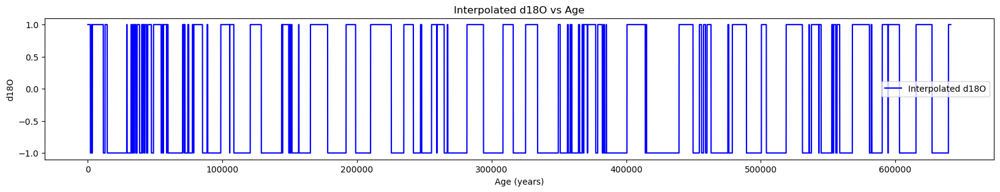

          age       pre
0           0  0.016280
1          10  0.016280
2          20  0.016280
3          30  0.016280
4          40  0.016280
...       ...       ...
64115  641150 -0.004917
64116  641160 -0.005173
64117  641170 -0.005173
64118  641180 -0.005173
64119  641190 -0.005173

[64120 rows x 2 columns]


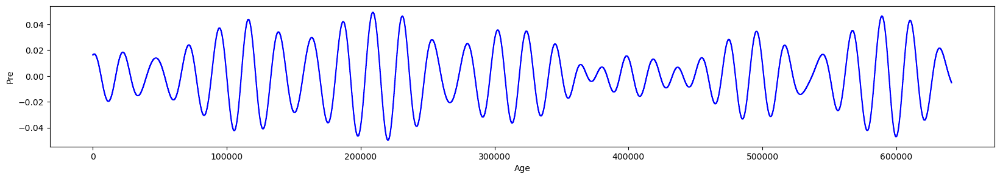

          age       obl
0           0  0.409093
1          10  0.409093
2          20  0.409093
3          30  0.409093
4          40  0.409093
...       ...       ...
64115  641150  0.399218
64116  641160  0.399263
64117  641170  0.399263
64118  641180  0.399263
64119  641190  0.399263

[64120 rows x 2 columns]


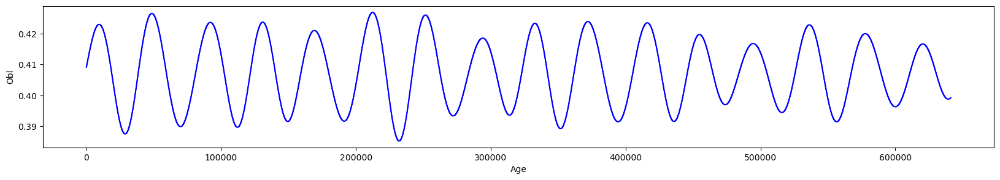

In [61]:
import pandas as pd
from scipy.interpolate import interp1d

# for df_sq, interpolated it to has 100 times lower resolution
new_age = np.arange(np.min(df_sq['age'].values), np.max(df_sq['age'].values), 10)
# create a new DataFrame with the new age values
f_sq = interp1d(df_sq['age'], df_sq['sq'], kind='nearest',
             bounds_error=False,
             fill_value=1)
interpolated_sq = f_sq(new_age)
# create a new DataFrame with the new age values
df_sq = pd.DataFrame({'age': new_age, 'sq': interpolated_sq})

# plot the data
plt.figure(figsize=(20, 3))
plt.plot(df_sq['age'], df_sq['sq'], label='Interpolated d18O', color='blue')
plt.xlabel('Age (years)')
plt.ylabel('d18O')
plt.title('Interpolated d18O vs Age')
plt.legend()
plt.show()

# # filp the second column upside down (last row to first row)
# df_sq['sq'] = df_sq['sq'].iloc[::-1].reset_index(drop=True)
# # plot the data
# plt.figure(figsize=(20, 3))
# plt.plot(df_sq['age'], df_sq['sq'], label='Interpolated d18O', color='blue')
# plt.xlabel('Age (years)')
# plt.ylabel('d18O')
# plt.title('Interpolated d18O vs Age')
# plt.legend()
# plt.show()




# Read the file into a DataFrame
df_pre = pd.read_csv(
    r"D:\VScode\bipolar_seesaw_CCM\inso_data\pre_800_inter100.txt", 
    sep='\s+',       # '\s+' means "split on any whitespace"
    header=None,     # or specify a row number if there's a header
    engine='python'
)

df_obl = pd.read_csv(
    r"D:\VScode\bipolar_seesaw_CCM\inso_data\obl_800_inter100.txt", 
    sep='\s+',       # '\s+' means "split on any whitespace"
    header=None,     # or specify a row number if there's a header
    engine='python'
)

df_pre.iloc[:, 0] = df_pre.iloc[:, 0].abs() * 1000
df_obl.iloc[:, 0] = df_obl.iloc[:, 0].abs() * 1000


# # plot df_pre
# plt.figure(figsize=(20, 3))
# plt.plot(df_pre.iloc[:, 0], df_pre.iloc[:, 1], label='pre', color='blue')
# plt.xlabel("Age")
# plt.ylabel("Pre")
# print(df_pre)
# plt.show()

# Reverse the DataFrame rows
df_pre = df_pre.iloc[::-1]
df_pre.columns = ['age', 'pre']

df_obl = df_obl.iloc[::-1]
df_obl.columns = ['age', 'obl']


# interpolate the data using new_age
f = interp1d(df_pre['age'], df_pre['pre'], kind='nearest',
             bounds_error=False,
             fill_value=1)

interpolated_pre = f(new_age)
df_pre = pd.DataFrame({'age': new_age, 'pre': interpolated_pre})

f = interp1d(df_obl['age'], df_obl['obl'], kind='nearest',
             bounds_error=False,
             fill_value=1)

interpolated_obl = f(new_age)
df_obl = pd.DataFrame({'age': new_age, 'obl': interpolated_obl})

# plot df_pre
plt.figure(figsize=(20, 3))
plt.plot(df_pre.iloc[:, 0], df_pre.iloc[:, 1], label='pre', color='blue')
plt.xlabel("Age")
plt.ylabel("Pre")
print(df_pre)
plt.show()

plt.figure(figsize=(20, 3))
plt.plot(df_obl.iloc[:, 0], df_obl.iloc[:, 1], label='obl', color='blue')
plt.xlabel("Age")
plt.ylabel("Obl")
print(df_obl)
plt.show()

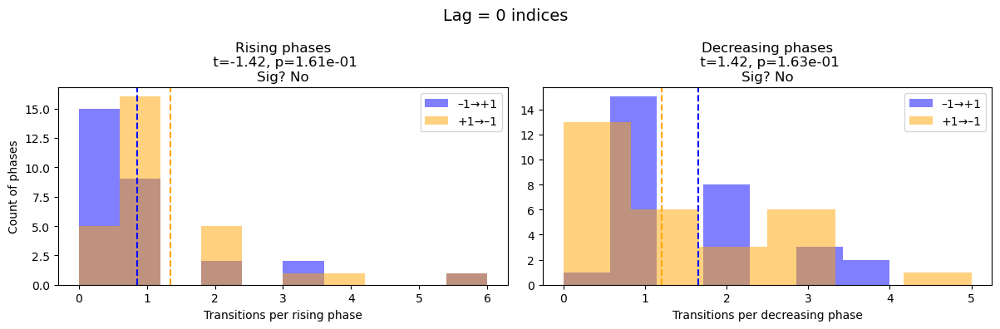

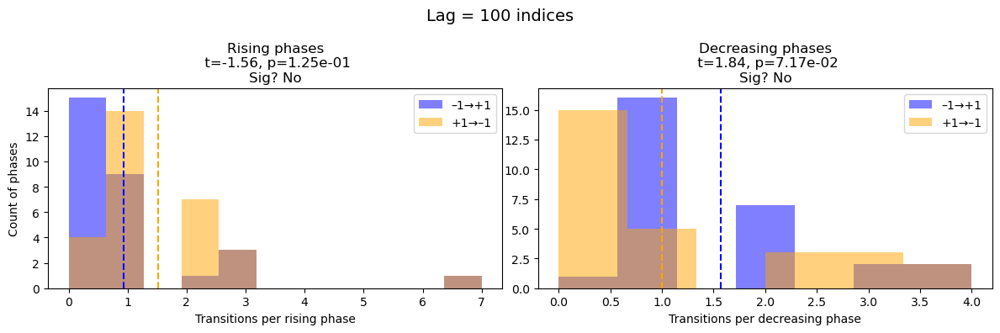

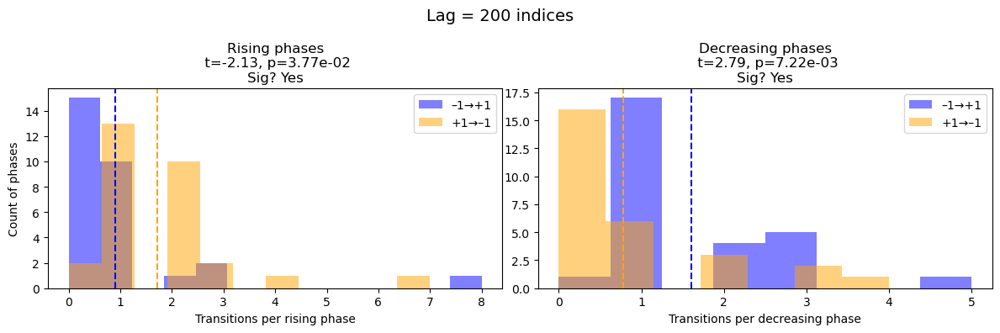

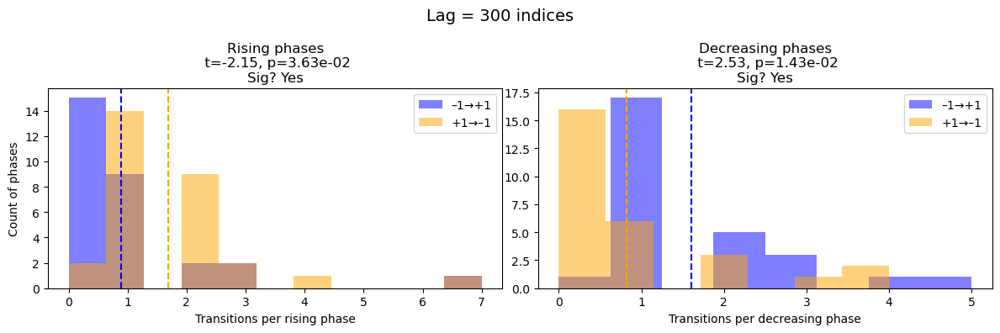

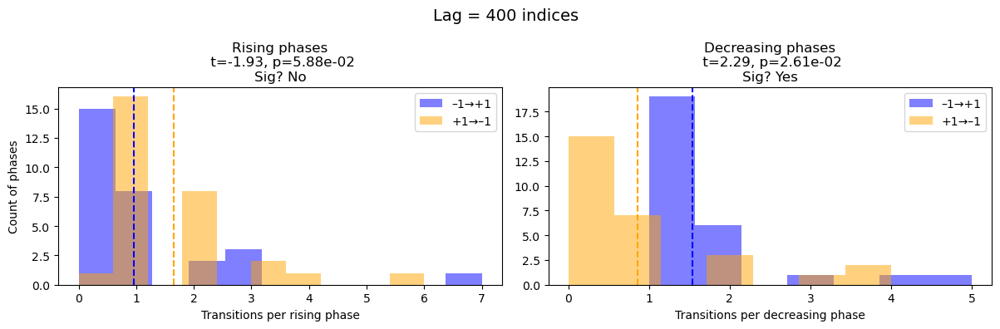

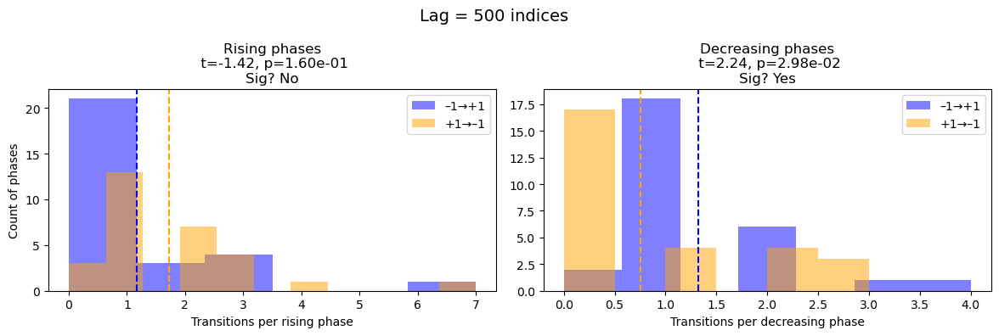

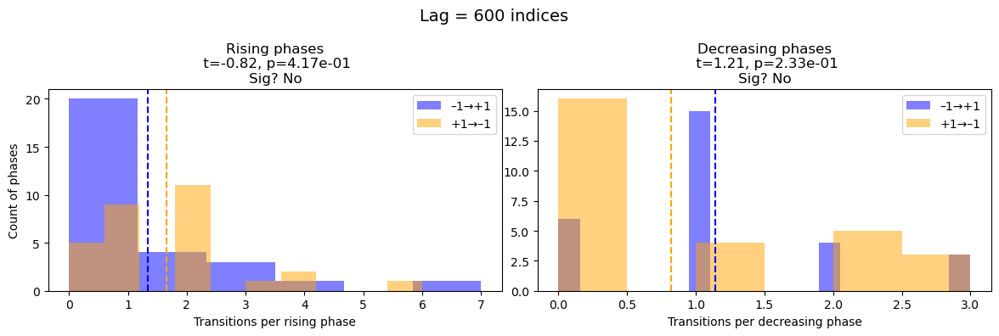

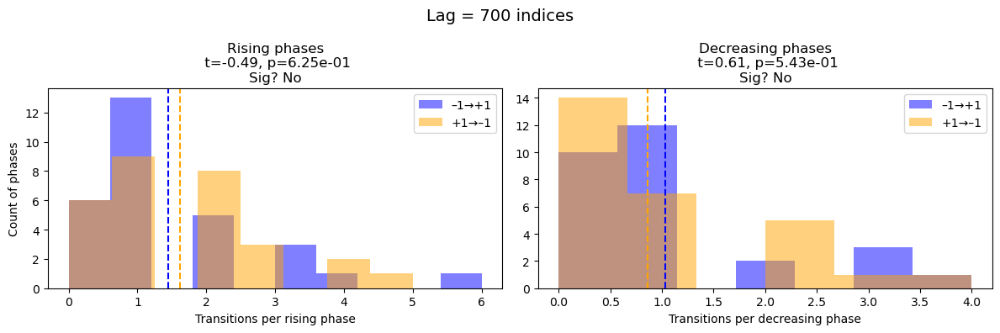

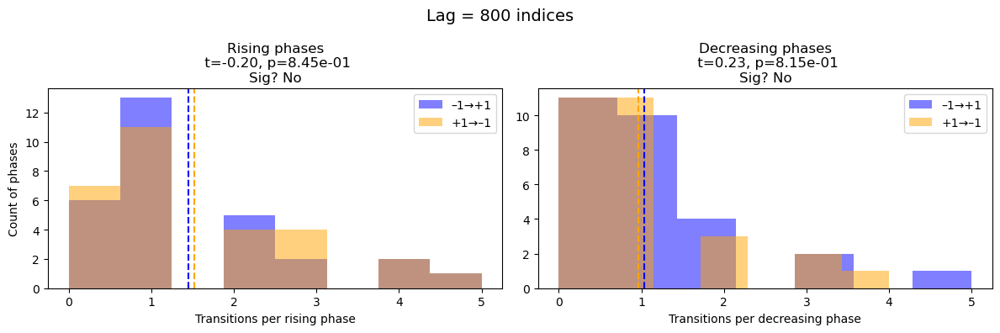

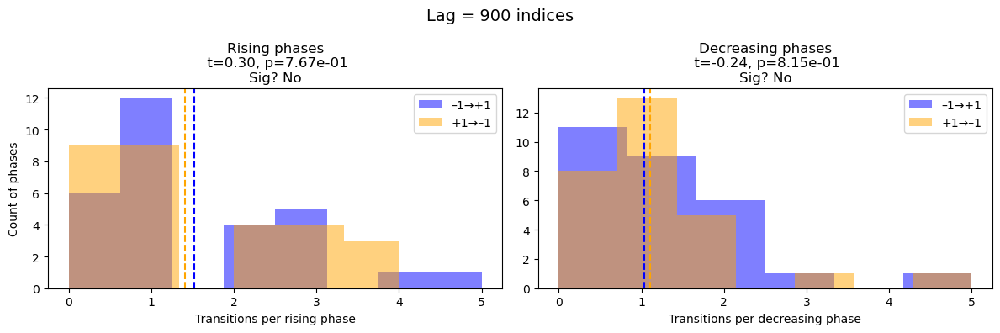

In [68]:
import numpy as np
from scipy.signal import find_peaks
from scipy.stats import ttest_ind
import matplotlib.pyplot as plt

pre_vals_orig = df_pre['pre'].values
sq_orig       = np.where(df_sq['sq'].values > 0, 1, -1)
N = len(pre_vals_orig)

def count_transitions(intervals, sq_sign):
    lt, hl = [], []
    for i0, i1 in intervals:
        seg = sq_sign[i0:i1+1]
        lt.append(np.sum((seg[:-1]==-1) & (seg[1:]==+1)))
        hl.append(np.sum((seg[:-1]==+1) & (seg[1:]==-1)))
    return lt, hl

for lag in range(0, 901, 100):
    # --- 1) manual shift with NaNs instead of roll() ----------------
    pre_shifted = np.full(N, np.nan)
    if lag > 0:
        # shift left by `lag`: indices [0..N-lag-1] ← orig[lag..]
        pre_shifted[0:N-lag] = pre_vals_orig[lag:N]
    elif lag < 0:
        k = -lag
        # shift right by `k`: indices [k..N-1] ← orig[0..N-k-1]
        pre_shifted[k:N] = pre_vals_orig[0:N-k]
    else:
        pre_shifted[:] = pre_vals_orig

    # --- 2) build a mask of valid (non-NaN) entries ---------------
    valid = ~np.isnan(pre_shifted)
    pre_vals = pre_shifted[valid]
    sq_sign  = sq_orig[valid]       # truncate sq_sign to match

    # --- 3) detect peaks/troughs on the valid portion -------------
    peaks,   _ = find_peaks(pre_vals)
    troughs, _ = find_peaks(-pre_vals)

    # --- 4) rising & falling intervals ----------------------------
    rising, falling = [], []
    for t in troughs:
        nxt = peaks[peaks > t]
        if nxt.size: rising.append((t, nxt[0]))
    for p in peaks:
        nxt = troughs[troughs > p]
        if nxt.size: falling.append((p, nxt[0]))

    # --- 5) count transitions ------------------------------------
    r_lt, r_hl = count_transitions(rising,   sq_sign)
    f_lt, f_hl = count_transitions(falling,  sq_sign)

    # --- 6) t‐tests ----------------------------------------------
    t_r, p_r = ttest_ind(r_lt, r_hl, equal_var=False)
    sig_r = 'Yes' if p_r < 0.05 else 'No'
    t_f, p_f = ttest_ind(f_lt, f_hl, equal_var=False)
    sig_f = 'Yes' if p_f < 0.05 else 'No'

    # --- 7) plot -------------------------------------------------
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4), tight_layout=True)
    fig.suptitle(f"Lag = {lag} indices", fontsize=14)

    ax1.hist(r_lt, bins='auto', alpha=0.5, color='blue',   label='–1→+1')
    ax1.axvline(np.mean(r_lt), color='blue', linestyle='--')
    ax1.hist(r_hl, bins='auto', alpha=0.5, color='orange', label='+1→–1')
    ax1.axvline(np.mean(r_hl), color='orange', linestyle='--')
    ax1.set_title(f"Rising phases\n t={t_r:.2f}, p={p_r:.2e}\nSig? {sig_r}")
    ax1.set_xlabel('Transitions per rising phase')
    ax1.set_ylabel('Count of phases')
    ax1.legend()

    ax2.hist(f_lt, bins='auto', alpha=0.5, color='blue',   label='–1→+1')
    ax2.axvline(np.mean(f_lt), color='blue', linestyle='--')
    ax2.hist(f_hl, bins='auto', alpha=0.5, color='orange', label='+1→–1')
    ax2.axvline(np.mean(f_hl), color='orange', linestyle='--')
    ax2.set_title(f"Decreasing phases\n t={t_f:.2f}, p={p_f:.2e}\nSig? {sig_f}")
    ax2.set_xlabel('Transitions per decreasing phase')
    ax2.legend()

    plt.show()


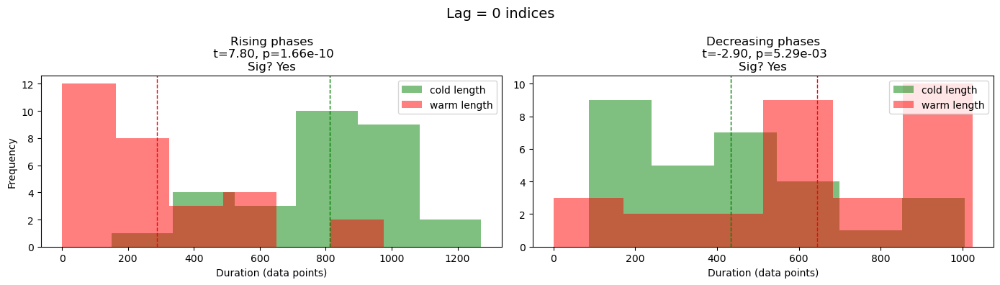

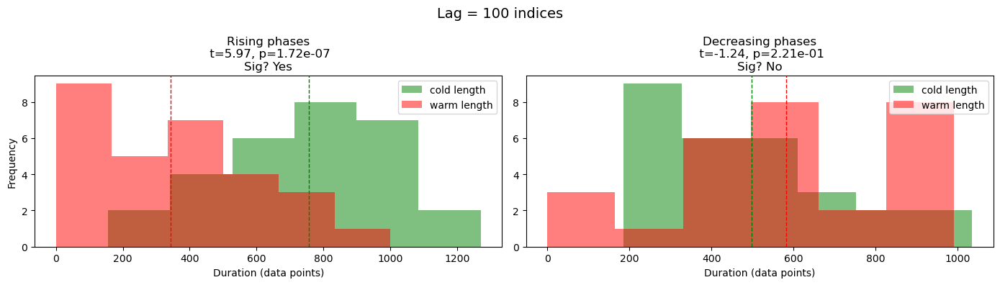

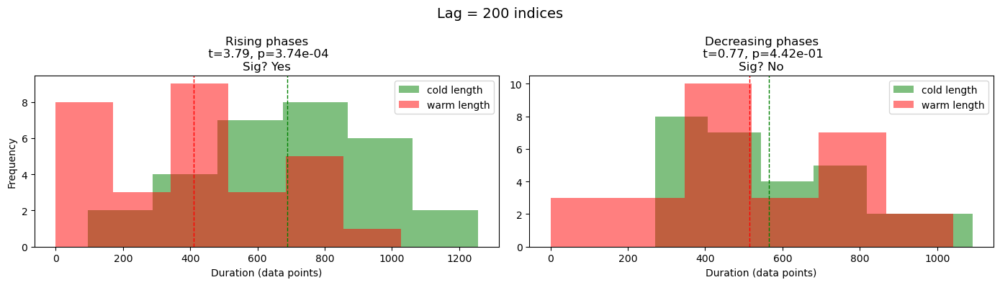

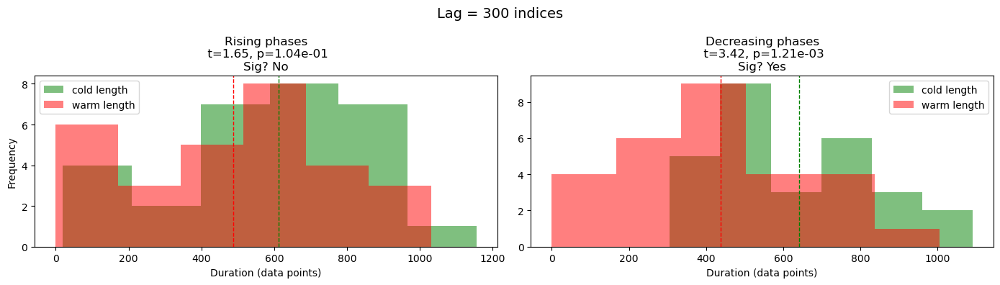

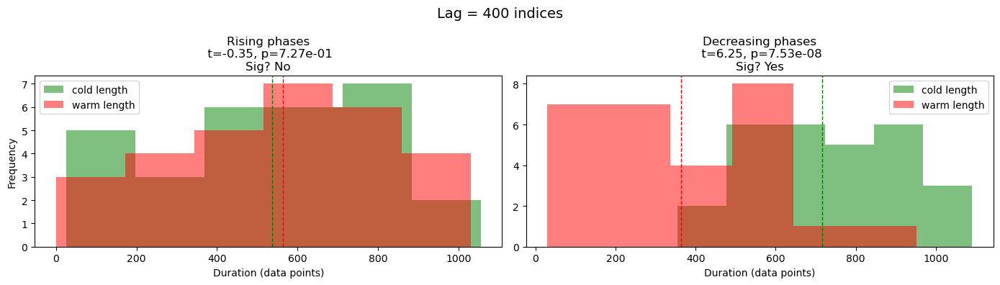

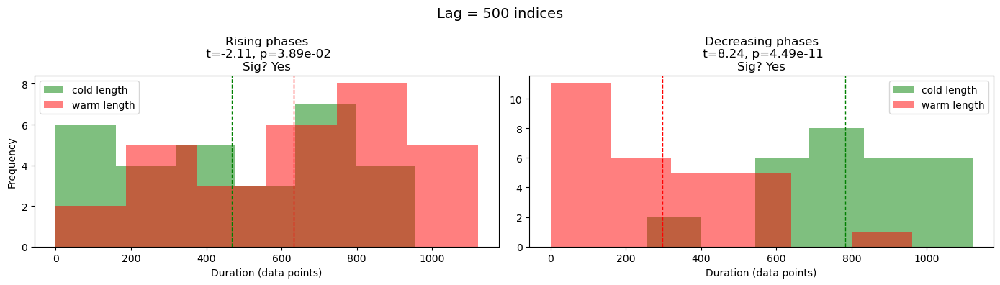

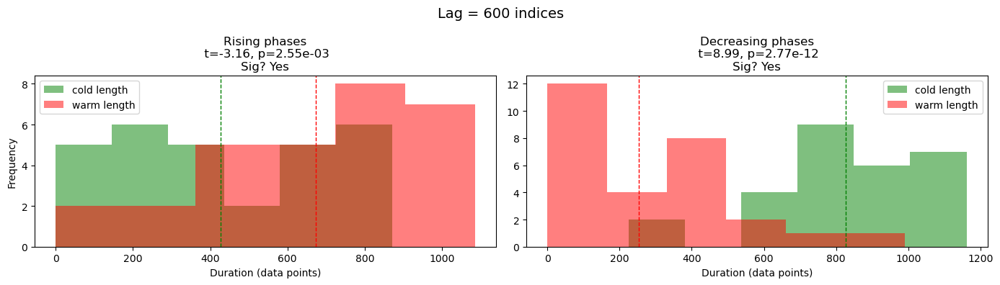

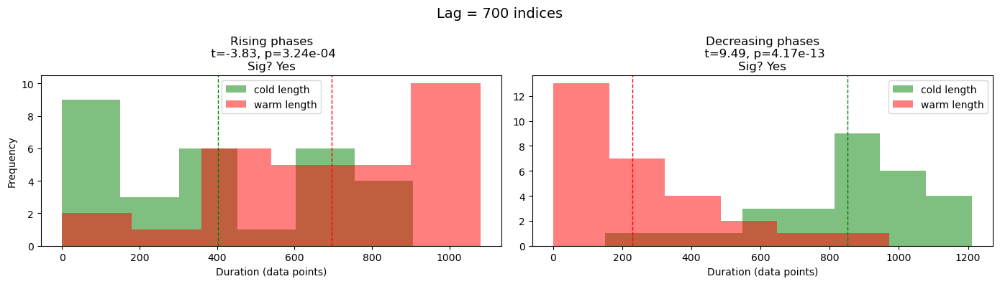

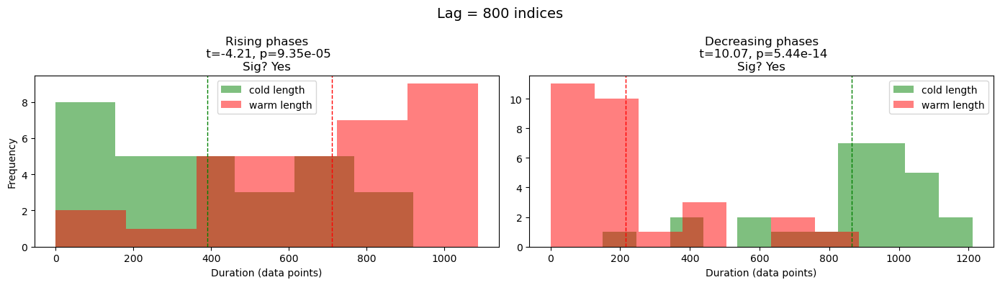

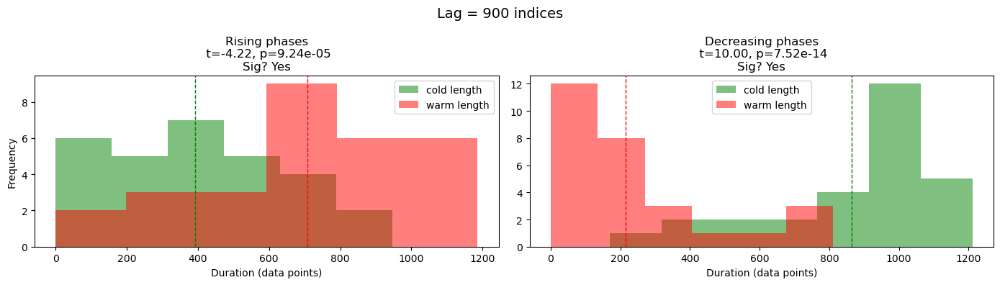

In [69]:
import numpy as np
from scipy.signal import find_peaks
from scipy.stats import ttest_ind
import matplotlib.pyplot as plt

pre_vals_orig = df_pre['pre'].values
sq_orig       = np.where(df_sq['sq'].values > 0, 1, -1)
N             = len(pre_vals_orig)

def count_transitions(intervals, sq_sign):
    lt, hl = [], []
    for i0, i1 in intervals:
        seg = sq_sign[i0:i1+1]
        lt.append(np.sum((seg[:-1]==-1) & (seg[1:]==+1)))
        hl.append(np.sum((seg[:-1]==+1) & (seg[1:]==-1)))
    return lt, hl

for lag in range(0, 901, 100):
    # --- 1) manual shift with NaNs ----------------------------
    pre_shifted = np.full(N, np.nan)
    if lag > 0:
        # move data left by lag → fill tail with NaN
        pre_shifted[0:N-lag] = pre_vals_orig[lag:N]
    elif lag < 0:
        k = -lag
        # move data right by k → fill head with NaN
        pre_shifted[k:N] = pre_vals_orig[0:N-k]
    else:
        pre_shifted[:] = pre_vals_orig

    # --- 2) mask out NaNs & truncate sq to match -------------
    valid    = ~np.isnan(pre_shifted)
    pre_vals = pre_shifted[valid]
    sq_sign  = sq_orig[valid]

    # --- 3) peak/trough detection -----------------------------
    peaks,   _ = find_peaks(pre_vals)
    troughs, _ = find_peaks(-pre_vals)

    # --- 4) rising & falling intervals ------------------------
    rising, falling = [], []
    for t in troughs:
        nxt = peaks[peaks > t]
        if nxt.size:
            rising.append((t, nxt[0]))
    for p in peaks:
        nxt = troughs[troughs > p]
        if nxt.size:
            falling.append((p, nxt[0]))

    # --- 5) compute durations ---------------------------------
    r_cold, r_warm = [], []
    for i0, i1 in rising:
        seg = sq_sign[i0:i1+1]
        r_cold.append(np.sum(seg == -1))
        r_warm.append(np.sum(seg == +1))

    d_cold, d_warm = [], []
    for i0, i1 in falling:
        seg = sq_sign[i0:i1+1]
        d_cold.append(np.sum(seg == -1))
        d_warm.append(np.sum(seg == +1))

    # --- 6) t‐tests on durations ------------------------------
    t_r, p_r = ttest_ind(r_cold, r_warm, equal_var=False)
    sig_r = 'Yes' if p_r < 0.05 else 'No'
    t_d, p_d = ttest_ind(d_cold, d_warm, equal_var=False)
    sig_d = 'Yes' if p_d < 0.05 else 'No'

    # --- 7) plotting ------------------------------------------
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 4), tight_layout=True)
    fig.suptitle(f"Lag = {lag} indices", fontsize=14)

    # Rising‐phase durations
    ax1.hist(r_cold, bins='auto', alpha=0.5, color='green', label='cold length')
    ax1.axvline(np.mean(r_cold), color='green', linestyle='dashed', linewidth=1)
    ax1.hist(r_warm, bins='auto', alpha=0.5, color='red',   label='warm length')
    ax1.axvline(np.mean(r_warm), color='red', linestyle='dashed', linewidth=1)
    ax1.set_title(f"Rising phases\n t={t_r:.2f}, p={p_r:.2e}\nSig? {sig_r}")
    ax1.set_xlabel('Duration (data points)')
    ax1.set_ylabel('Frequency')
    ax1.legend()

    # Decreasing‐phase durations
    ax2.hist(d_cold, bins='auto', alpha=0.5, color='green', label='cold length')
    ax2.axvline(np.mean(d_cold), color='green', linestyle='dashed', linewidth=1)
    ax2.hist(d_warm, bins='auto', alpha=0.5, color='red',   label='warm length')
    ax2.axvline(np.mean(d_warm), color='red', linestyle='dashed', linewidth=1)
    ax2.set_title(f"Decreasing phases\n t={t_d:.2f}, p={p_d:.2e}\nSig? {sig_d}")
    ax2.set_xlabel('Duration (data points)')
    ax2.legend()

    plt.show()


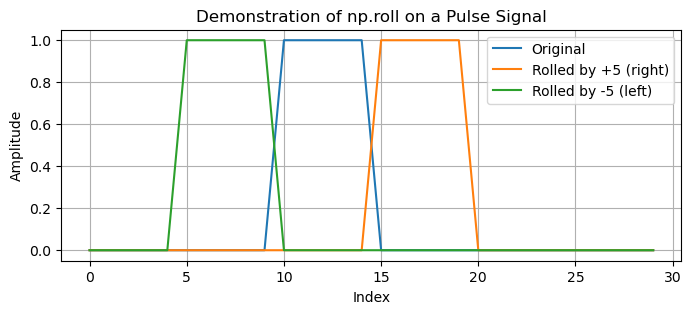

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Create a simple pulse signal
length = 30
pulse = np.zeros(length)
pulse[10:15] = 1  # a block of ones from index 10 to 14

# Apply np.roll shifts
rolled_right = np.roll(pulse, 5)   # shift right by 5
rolled_left  = np.roll(pulse, -5)  # shift left by 5

# Plot original and rolled pulse
plt.figure(figsize=(8, 3))
plt.plot(pulse, label='Original')
plt.plot(rolled_right, label='Rolled by +5 (right)')
plt.plot(rolled_left, label='Rolled by -5 (left)')
plt.xlabel('Index')
plt.ylabel('Amplitude')
plt.title('Demonstration of np.roll on a Pulse Signal')
plt.legend()
plt.grid(True)
plt.show()


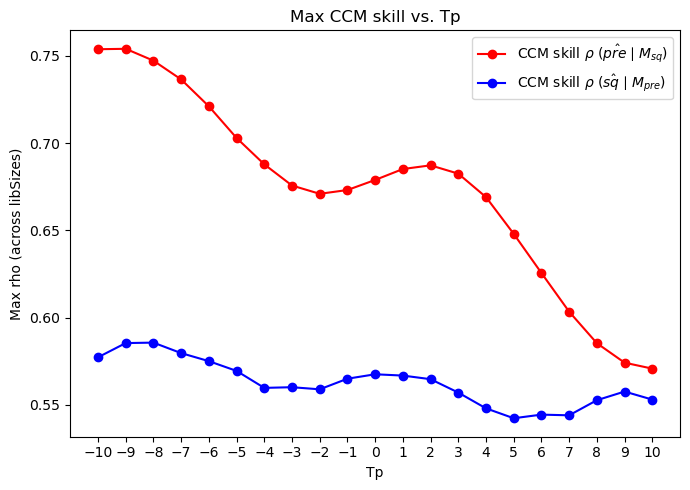

In [ ]:
from toolbox import ccm_functions as cf
import importlib
importlib.reload(cf)

Tps_list, forward_max_rhos, reverse_max_rhos = cf.find_optimal_Tp(df_sq_rs_noise, df_pre_rs,
                    E=6, tau=-5,
                    libSizes="100 200 300 400 500",
                    sample=20,
                    Tps=range(-10, 11),
                    interactive=False)

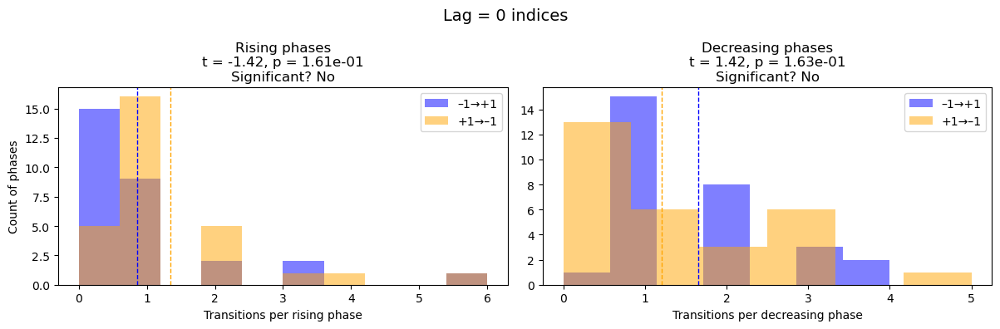

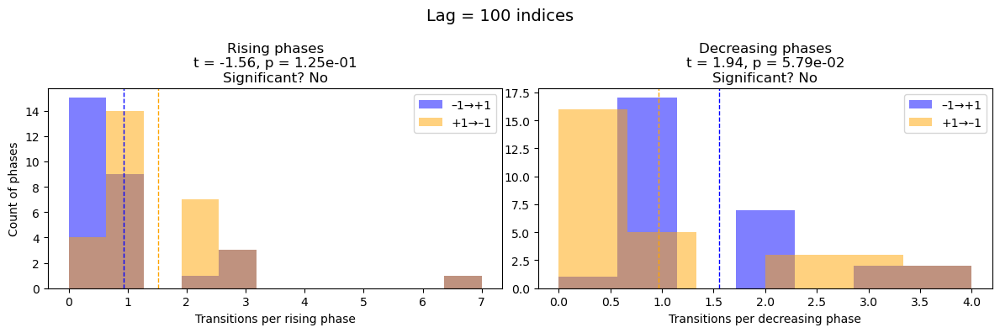

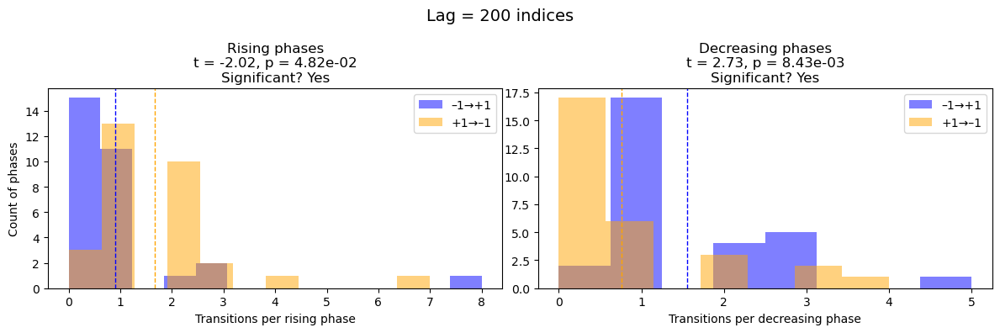

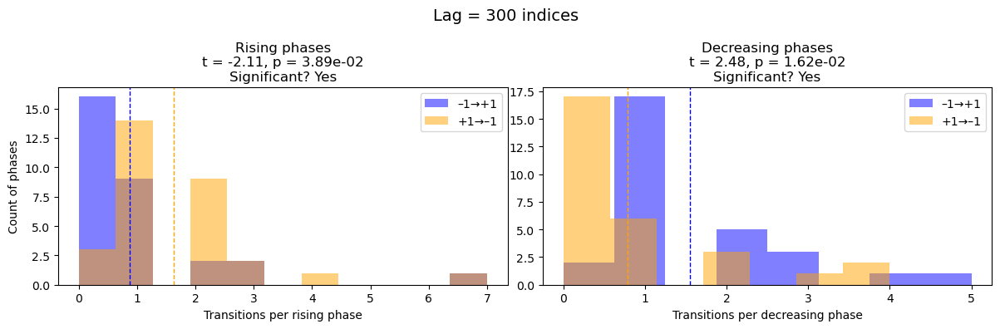

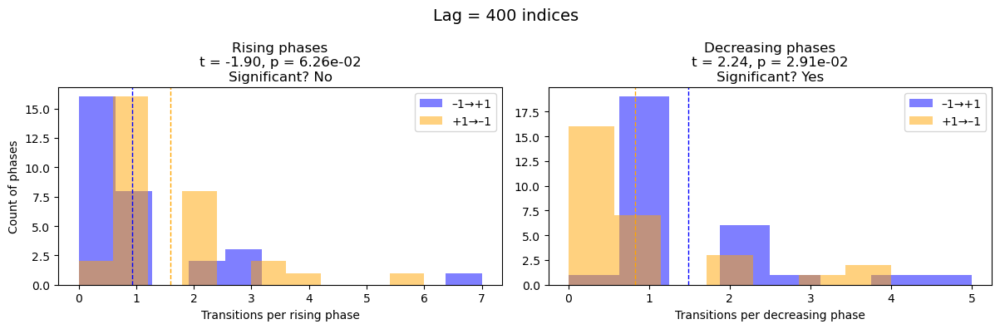

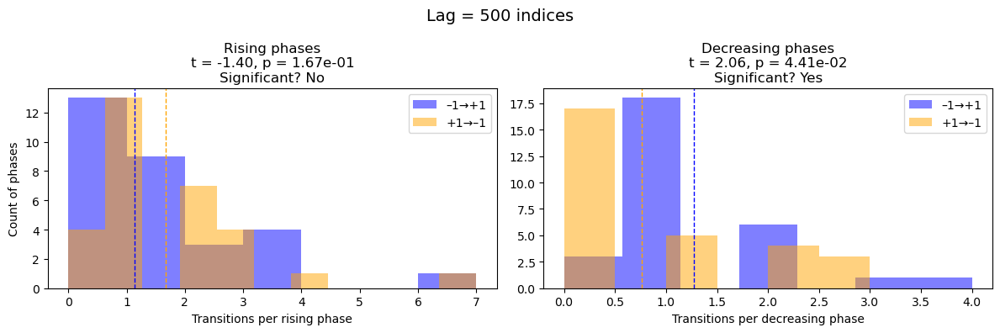

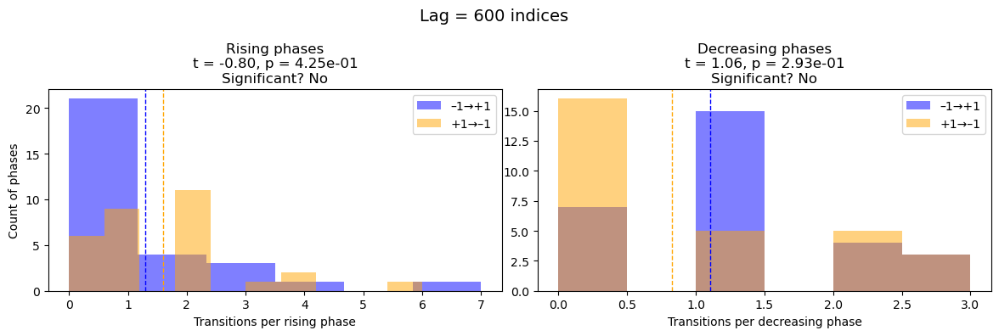

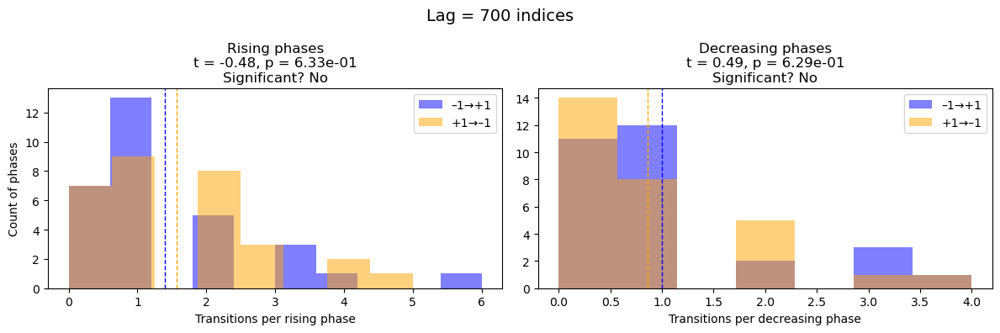

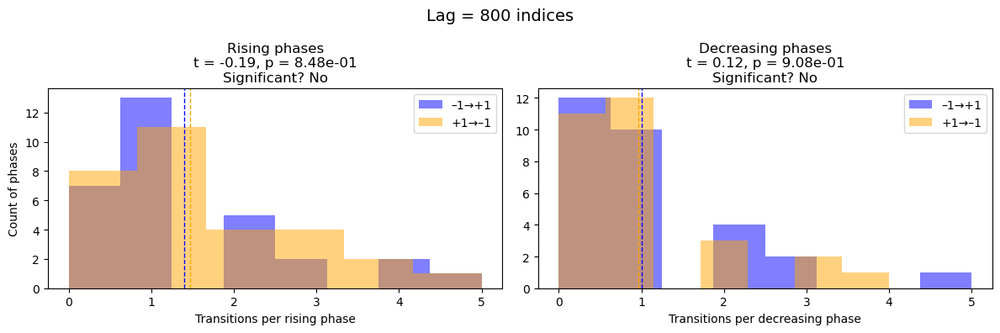

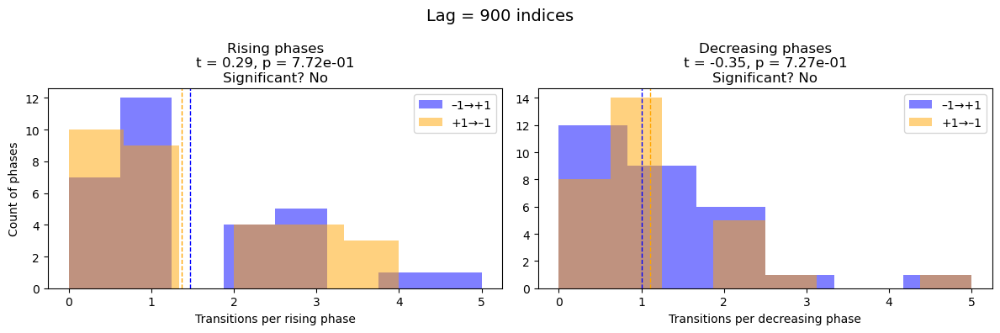

In [67]:
import numpy as np
from scipy.signal import find_peaks
from scipy.stats import ttest_ind
import matplotlib.pyplot as plt

# original arrays
pre_vals_orig = df_pre['pre'].values
sq_sign       = np.where(df_sq['sq'].values > 0, 1, -1)

def count_transitions(intervals, sq_sign):
    lt, hl = [], []
    for i0, i1 in intervals:
        seg = sq_sign[i0:i1+1]
        lt.append(np.sum((seg[:-1]==-1) & (seg[1:]==+1)))
        hl.append(np.sum((seg[:-1]==+1) & (seg[1:]==-1)))
    return lt, hl

# loop over lags
for lag in range(0, 901, 100):
    # 1) shift precession
    pre_shifted = np.roll(pre_vals_orig, -lag)
    
    # 2) find peaks & troughs on shifted data
    peaks,   _ = find_peaks(pre_shifted)
    troughs, _ = find_peaks(-pre_shifted)
    
    # 3) rising intervals: trough → next peak
    rising = []
    for t in troughs:
        nxt = peaks[peaks > t]
        if nxt.size:
            rising.append((t, nxt[0]))
    
    # 4) decreasing intervals: peak → next trough
    falling = []
    for p in peaks:
        nxt = troughs[troughs > p]
        if nxt.size:
            falling.append((p, nxt[0]))
    
    # 5) count transitions
    r_lt, r_hl = count_transitions(rising, sq_sign)
    f_lt, f_hl = count_transitions(falling, sq_sign)
    
    # 6) perform Welch’s t-tests
    t_r, p_r = ttest_ind(r_lt, r_hl, equal_var=False)
    sig_r = 'Yes' if p_r < 0.05 else 'No'
    t_f, p_f = ttest_ind(f_lt, f_hl, equal_var=False)
    sig_f = 'Yes' if p_f < 0.05 else 'No'
    
    # 7) plot
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4), tight_layout=True)
    fig.suptitle(f"Lag = {lag} indices", fontsize=14)
    
    # rising
    ax1.hist(r_lt, bins='auto', alpha=0.5, color='blue',   label='–1→+1')
    # plot mean line
    ax1.axvline(np.mean(r_lt), color='blue', linestyle='--', linewidth=1)
    ax1.hist(r_hl, bins='auto', alpha=0.5, color='orange', label='+1→–1')
    # plot mean line
    ax1.axvline(np.mean(r_hl), color='orange', linestyle='--', linewidth=1)
    ax1.set_title(
        f"Rising phases\n"
        f"t = {t_r:.2f}, p = {p_r:.2e}\n"
        f"Significant? {sig_r}"
    )
    ax1.set_xlabel('Transitions per rising phase')
    ax1.set_ylabel('Count of phases')
    ax1.legend()
    
    # falling
    ax2.hist(f_lt, bins='auto', alpha=0.5, color='blue',   label='–1→+1')
    # plot mean line
    ax2.axvline(np.mean(f_lt), color='blue', linestyle='--', linewidth=1)
    ax2.hist(f_hl, bins='auto', alpha=0.5, color='orange', label='+1→–1')
    # plot mean line
    ax2.axvline(np.mean(f_hl), color='orange', linestyle='--', linewidth=1)
    ax2.set_title(
        f"Decreasing phases\n"
        f"t = {t_f:.2f}, p = {p_f:.2e}\n"
        f"Significant? {sig_f}"
    )
    ax2.set_xlabel('Transitions per decreasing phase')
    ax2.legend()
    
    plt.show()


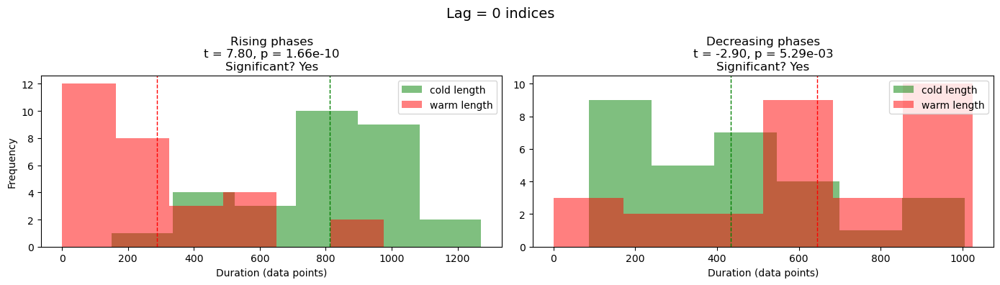

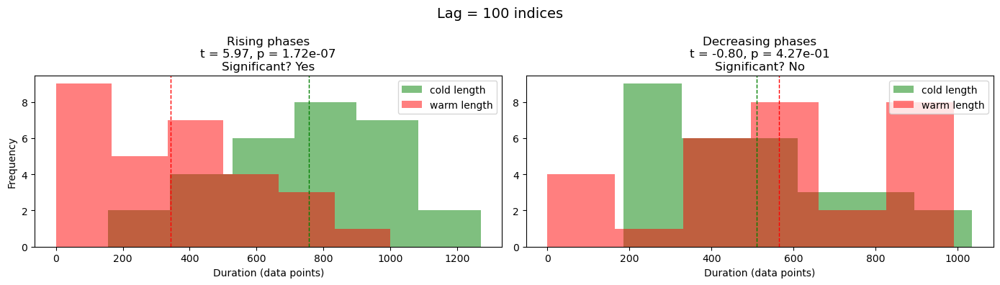

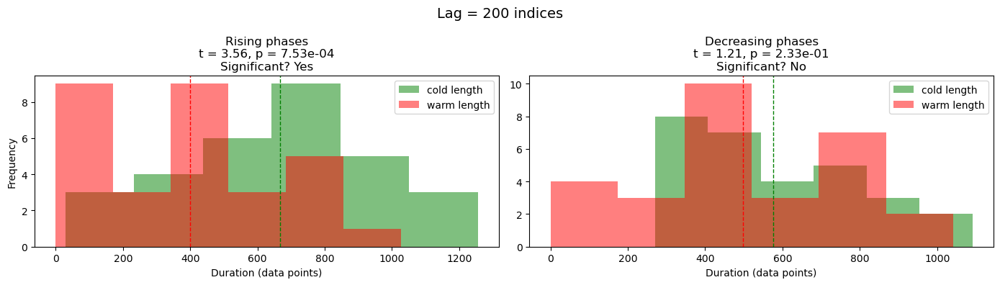

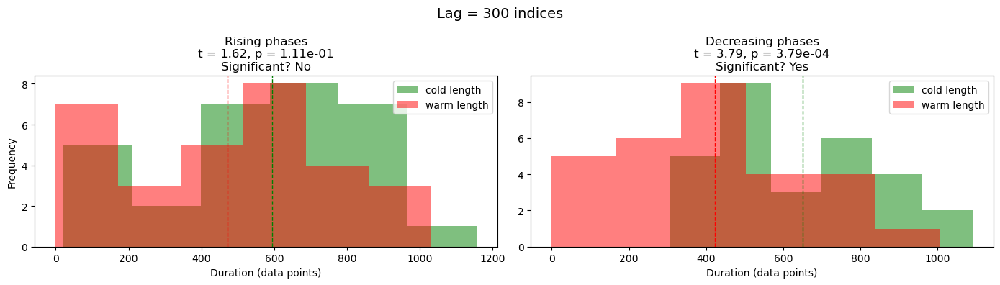

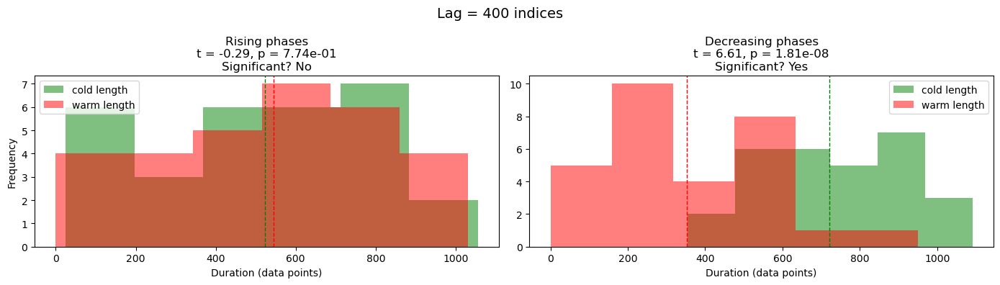

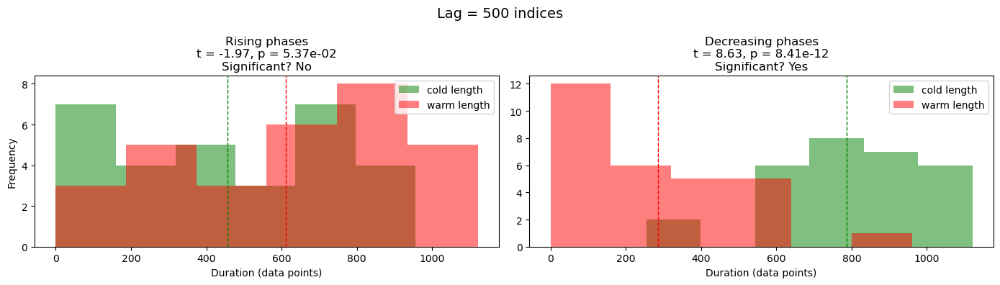

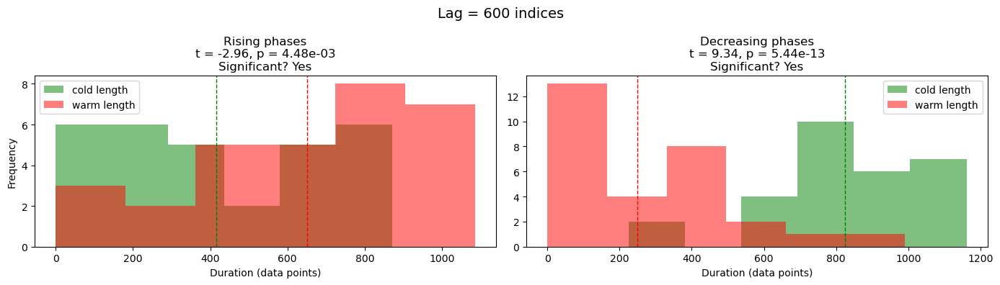

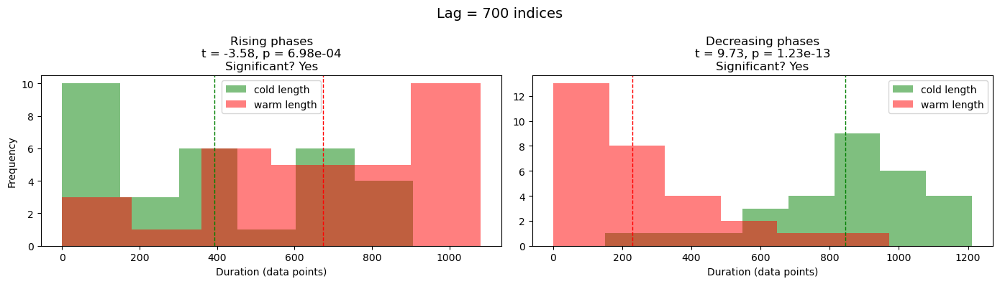

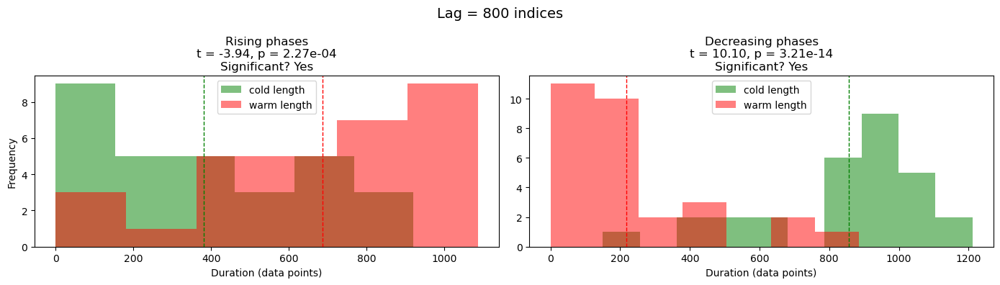

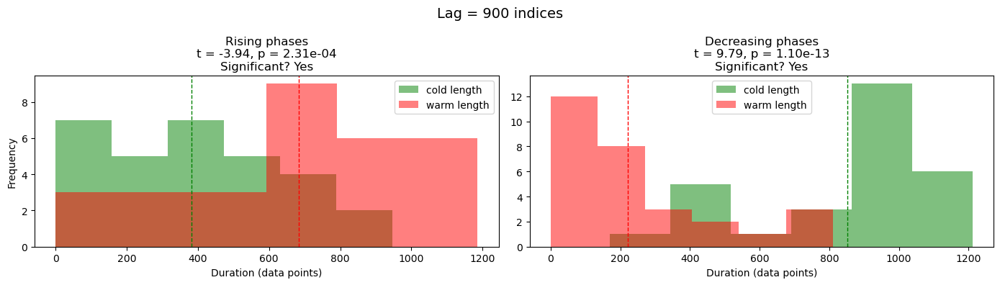

In [ ]:
import numpy as np
from scipy.signal import find_peaks
from scipy.stats import ttest_ind
import matplotlib.pyplot as plt



for lag in range(0, 901, 100):
    # 1) shift & detect peaks/troughs
    pre_shifted = np.roll(pre_vals_orig, -lag)
    peaks, _    = find_peaks(pre_shifted)
    troughs, _ = find_peaks(-pre_shifted)

    # 2) rising & falling intervals
    rising, falling = [], []
    for t in troughs:
        nxt = peaks[peaks > t]
        if nxt.size: rising.append((t, nxt[0]))
    for p in peaks:
        nxt = troughs[troughs > p]
        if nxt.size: falling.append((p, nxt[0]))

    # 3) compute durations for rising phases
    r_cold, r_warm = [], []
    for i0, i1 in rising:
        seg = sq_sign[i0:i1+1]
        r_cold.append(np.sum(seg == -1))
        r_warm.append(np.sum(seg == +1))

    # 4) compute durations for decreasing phases
    d_cold, d_warm = [], []
    for i0, i1 in falling:
        seg = sq_sign[i0:i1+1]
        d_cold.append(np.sum(seg == -1))
        d_warm.append(np.sum(seg == +1))

    # 5) t‐tests on durations
    t_r, p_r = ttest_ind(r_cold, r_warm, equal_var=False)
    sig_r = 'Yes' if p_r < 0.05 else 'No'
    t_d, p_d = ttest_ind(d_cold, d_warm, equal_var=False)
    sig_d = 'Yes' if p_d < 0.05 else 'No'

    # 6) plot
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 4), tight_layout=True)
    fig.suptitle(f"Lag = {lag} indices", fontsize=14)

    # Rising‐phase durations
    ax1.hist(r_cold, bins='auto', alpha=0.5, color='green', label='cold length')
    # plot the mean line
    ax1.axvline(np.mean(r_cold), color='green', linestyle='dashed', linewidth=1)
    ax1.hist(r_warm, bins='auto', alpha=0.5, color='red',   label='warm length')
    # plot the mean line
    ax1.axvline(np.mean(r_warm), color='red', linestyle='dashed', linewidth=1)
    ax1.set_title(
        f"Rising phases\n"
        f"t = {t_r:.2f}, p = {p_r:.2e}\n"
        f"Significant? {sig_r}"
    )
    ax1.set_xlabel('Duration (data points)')
    ax1.set_ylabel('Frequency')
    ax1.legend()

    # Decreasing‐phase durations
    ax2.hist(d_cold, bins='auto', alpha=0.5, color='green', label='cold length')
    # plot the mean line
    ax2.axvline(np.mean(d_cold), color='green', linestyle='dashed', linewidth=1)
    ax2.hist(d_warm, bins='auto', alpha=0.5, color='red',   label='warm length')
    # plot the mean line
    ax2.axvline(np.mean(d_warm), color='red', linestyle='dashed', linewidth=1)
    ax2.set_title(
        f"Decreasing phases\n"
        f"t = {t_d:.2f}, p = {p_d:.2e}\n"
        f"Significant? {sig_d}"
    )
    ax2.set_xlabel('Duration (data points)')
    ax2.legend()

    plt.show()


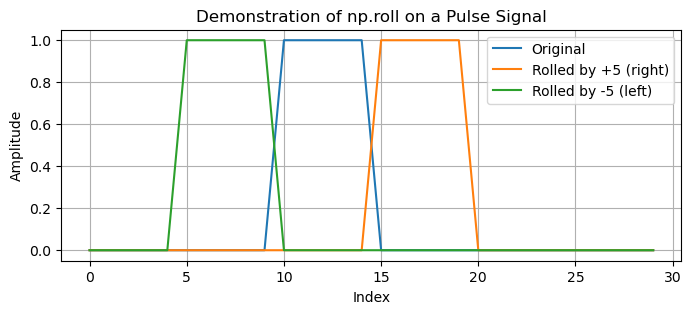

In [19]:
import numpy as np
import matplotlib.pyplot as plt

# Create a simple pulse signal
length = 30
pulse = np.zeros(length)
pulse[10:15] = 1  # a block of ones from index 10 to 14

# Apply np.roll shifts
rolled_right = np.roll(pulse, 5)   # shift right by 5
rolled_left  = np.roll(pulse, -5)  # shift left by 5

# Plot original and rolled pulse
plt.figure(figsize=(8, 3))
plt.plot(pulse, label='Original')
plt.plot(rolled_right, label='Rolled by +5 (right)')
plt.plot(rolled_left, label='Rolled by -5 (left)')
plt.xlabel('Index')
plt.ylabel('Amplitude')
plt.title('Demonstration of np.roll on a Pulse Signal')
plt.legend()
plt.grid(True)
plt.show()


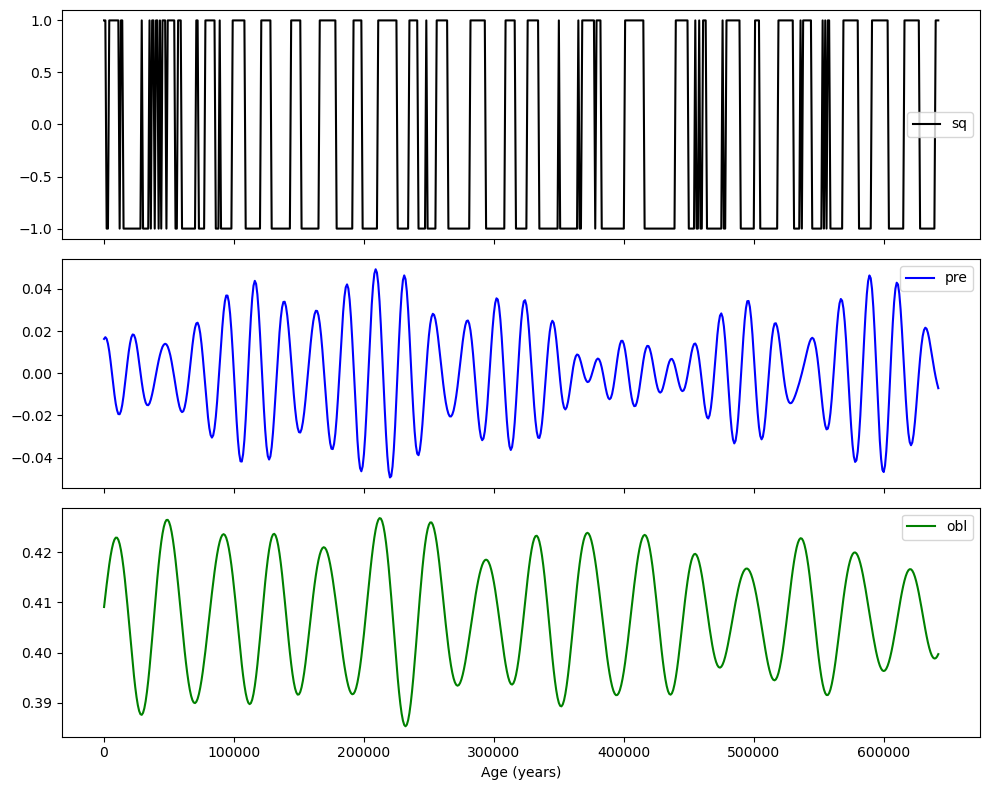

        age   sq
0         0  1.0
1      1000  1.0
2      2000 -1.0
3      3000 -1.0
4      4000  1.0
..      ...  ...
638  638000 -1.0
639  639000 -1.0
640  640000  1.0
641  641000  1.0
642  642000  1.0

[643 rows x 2 columns]
        age       pre
0         0  0.016280
1      1000  0.017116
2      2000  0.016308
3      3000  0.014018
4      4000  0.010453
..      ...       ...
638  638000  0.005100
639  639000  0.001432
640  640000 -0.001830
641  641000 -0.004658
642  642000 -0.007092

[643 rows x 2 columns]


In [46]:
from toolbox import sq_ana as sa 
import importlib
importlib.reload(sa)

df_sq_rs, df_pre_rs, df_obl_rs = sa.interpolate_data_forcing(df_sq, 1000, if_plot=True)
print(df_sq_rs)
print(df_pre_rs)

Replaced 66 values <-1.125 or >1.123 with N(0,0.010²) noise


KeyboardInterrupt: 

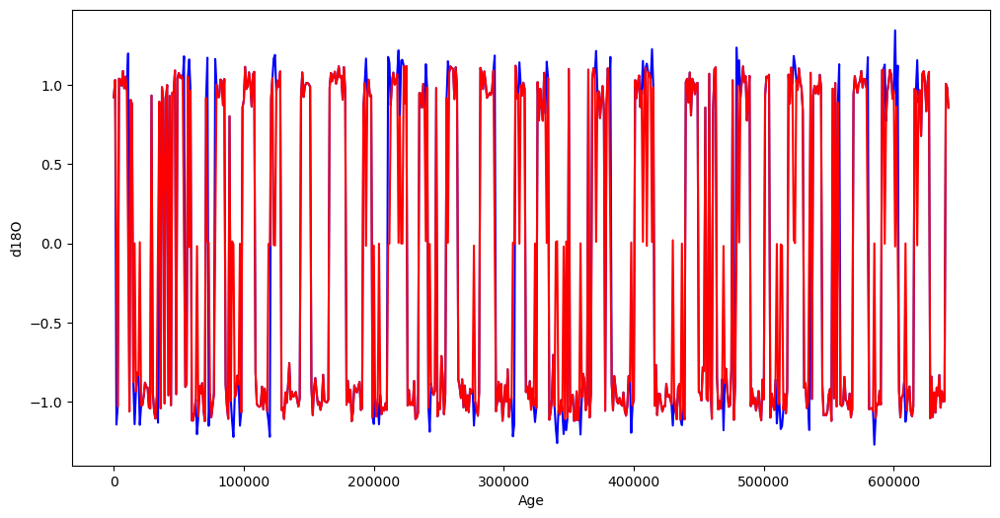

In [51]:
import numpy as np
import pandas as pd

def threshold_to_noise(df, 
                       col='d18O', 
                       lower_pct=5, 
                       upper_pct=95, 
                       noise_mean=0,
                       sigma=0.5):
    """
    Replace values of df[col] below the lower_pct‐percentile or 
    above the upper_pct‐percentile with white noise.
    
    Parameters
    ----------
    df : pandas.DataFrame
        Input DataFrame with at least the column `col`.
    col : str
        Name of the column to threshold.
    lower_pct : float
        Lower percentile cutoff (0–100).
    upper_pct : float
        Upper percentile cutoff (0–100).
    noise_mean : float
        Mean of the white‐noise distribution (default = 0).
    
    Returns
    -------
    df_out : pandas.DataFrame
        A copy of df where outliers in `col` are replaced by noise.
    lower_bound, upper_bound : float, float
        The thresholds actually used.
    """
    df_out = df.copy()
    series = df_out[col]
    
    # compute percentile thresholds
    lower_bound = np.percentile(series, lower_pct)
    upper_bound = np.percentile(series, upper_pct)
    
    # compute noise parameters
    # sigma = series.std()
    
    # mask of outliers
    mask = (series < lower_bound) | (series > upper_bound)
    n_outliers = mask.sum()
    
    # generate white noise for those positions
    noise = np.random.normal(loc=noise_mean, scale=sigma, size=n_outliers)
    
    # replace
    df_out.loc[mask, col] = noise
    
    print(f"Replaced {n_outliers} values <{lower_bound:.3f} or >{upper_bound:.3f} with N({noise_mean},{sigma:.3f}²) noise")
    return df_out, lower_bound, upper_bound





# say you want to replace anything below the 10th or above the 90th percentile:
df_clean, low, high = threshold_to_noise(df_sq_rs_noise.copy(), 
                                        col='d18O',
                                        lower_pct=5, 
                                        upper_pct=95,
                                        noise_mean=0,
                                        sigma=0.01)
                                        

# plot df_clean and df_sd using one plot
plt.figure(figsize=(12, 6))
plt.plot(df_sq_rs_noise['age'], df_sq_rs_noise['d18O'], label='df_sd', color='blue')
plt.plot(df_clean['age'], df_clean['d18O'], label='df_clean', color='red')
plt.xlabel("Age")
plt.ylabel("d18O")



from toolbox import significant_test as st
import importlib
importlib.reload(st)



ccm_out, ran_ccm_list_xy, test_result=st.ccm_significance_test_v3(
    df_clean, 
    df_pre,
    E=5, 
    tau=-10, 
    n_ran=20, 
    libSizes="100 200 300 400 500",
    Tp=0,
    sample=20,
    random=True,
    uni_dir=False,
    showPlot=True)

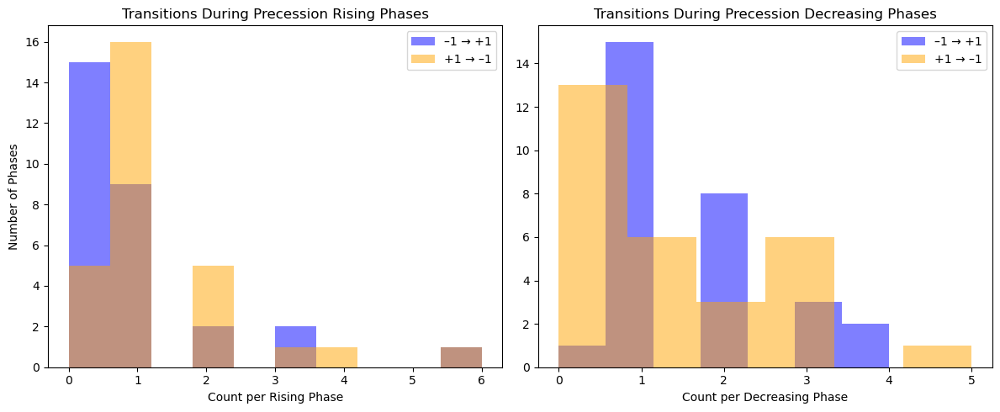

In [14]:
import numpy as np
from scipy.signal import find_peaks
import matplotlib.pyplot as plt

# --- assume df_pre and df_sq already exist as before ---

# 1) find peaks & troughs
pre_vals     = df_pre['pre'].values
peaks_idx, _ = find_peaks(pre_vals)
troughs_idx,_ = find_peaks(-pre_vals)

# 2) rising intervals (trough → next peak)
rising_intervals = []
for t in troughs_idx:
    next_pk = peaks_idx[peaks_idx > t]
    if next_pk.size:
        rising_intervals.append((t, next_pk[0]))

# 3) decreasing intervals (peak → next trough)
decreasing_intervals = []
for p in peaks_idx:
    next_tr = troughs_idx[troughs_idx > p]
    if next_tr.size:
        decreasing_intervals.append((p, next_tr[0]))

# 4) discretize square wave back to ±1
sq_sign = np.where(df_sq['sq'].values > 0, 1, -1)

# 5) helper to count transitions in a list of (start,end) indices
def count_transitions(intervals):
    lt_counts, hl_counts = [], []
    for i0, i1 in intervals:
        seg = sq_sign[i0 : i1+1]
        lt = np.sum((seg[:-1]==-1) & (seg[1:]==+1))
        hl = np.sum((seg[:-1]==+1) & (seg[1:]==-1))
        lt_counts.append(lt)
        hl_counts.append(hl)
    return lt_counts, hl_counts

r_lt, r_hl = count_transitions(rising_intervals)
d_lt, d_hl = count_transitions(decreasing_intervals)

# 6) plot side-by-side
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5), tight_layout=True)

# rising
ax1.hist(r_lt, bins='auto', alpha=0.5, label='–1 → +1', color='blue')
ax1.hist(r_hl, bins='auto', alpha=0.5, label='+1 → –1', color='orange')
ax1.set_title('Transitions During Precession Rising Phases')
ax1.set_xlabel('Count per Rising Phase')
ax1.set_ylabel('Number of Phases')
ax1.legend()

# decreasing
ax2.hist(d_lt, bins='auto', alpha=0.5, label='–1 → +1', color='blue')
ax2.hist(d_hl, bins='auto', alpha=0.5, label='+1 → –1', color='orange')
ax2.set_title('Transitions During Precession Decreasing Phases')
ax2.set_xlabel('Count per Decreasing Phase')
ax2.legend()

plt.show()


<bound method NDFrame.head of               age   d18O
0        -16.5010 -9.500
1          0.0000 -9.660
2         19.9980 -9.580
3         38.2475 -9.500
4         56.4970 -9.330
...           ...    ...
8348  640277.6000 -8.855
8349  640520.9000 -9.140
8350  640766.5000 -9.059
8351  641014.4000 -9.343
8352  641264.4000 -9.338

[8353 rows x 2 columns]>
641264.4
-16.501


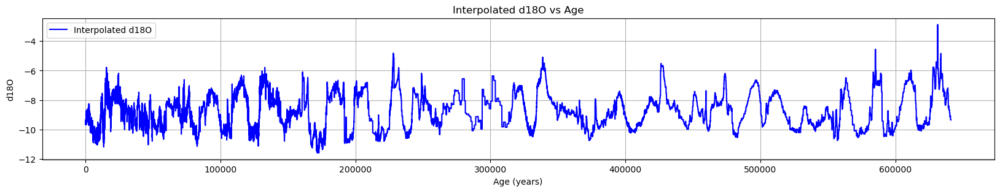

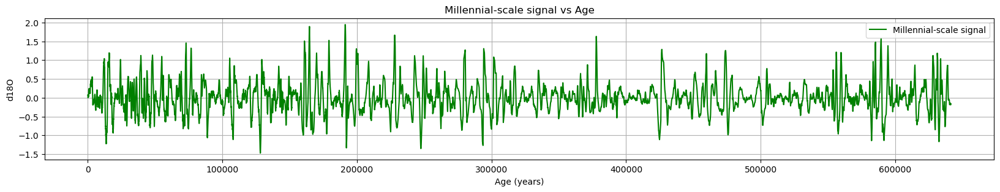

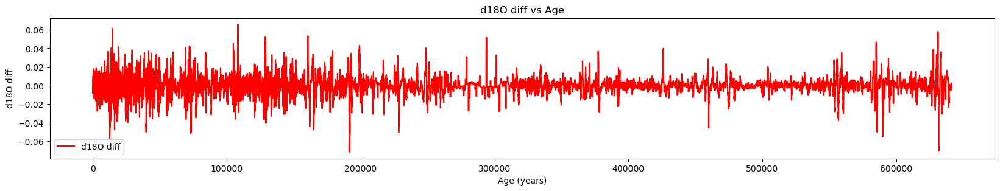

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from scipy.interpolate import interp1d

# path to your file
file_path = r"D:\VScode\bipolar_seesaw_CCM\other_data\monsoon.xlsx"

# read the first sheet into a DataFrame
df = pd.read_excel(file_path)
# age =age *1000
df['age'] = df['age'] * 1000

print(df.head)
# print the age max and min
print(df['age'].max())
print(df['age'].min())
# resample the data from age 0 to 641260 with a step of 10
new_age = np.arange(0, 641260, 10)
# create a new DataFrame with the new age values
f = interp1d(df['age'], df['d18O'], kind='nearest',
             bounds_error=False,
             fill_value=1)            

interpolated_sq = f(new_age)

# create a new DataFrame with the new age values
new_df = pd.DataFrame({'age': new_age, 'd18O': interpolated_sq})
# plot the data
plt.figure(figsize=(20, 3))
plt.plot(new_df['age'], new_df['d18O'], label='Interpolated d18O', color='blue')
plt.xlabel('Age (years)')
plt.ylabel('d18O')
plt.title('Interpolated d18O vs Age')
plt.legend()
plt.grid()
plt.show()


new_df["smoothed"] = new_df["d18O"].rolling(window=1000, center=True, min_periods=1).mean()

# 3) Millennial‐scale signal = original minus low‐frequency
new_df["d18O"] = new_df["d18O"] - new_df["smoothed"]


# from scipy.signal import butter, filtfilt

# def butter_highpass(cutoff, fs, order=4):
#     nyq = 0.5 * fs
#     normal_cutoff = cutoff / nyq
#     b, a = butter(order, normal_cutoff, btype='high', analog=False)
#     return b, a
# # 2) Parameters
# dt = 10.0              # years between samples
# fs = 1.0 / dt          # sampling frequency [per year]
# cutoff = 1.0 / 10000.0 # desired cutoff [per year]
# order = 4

# # 3) Design filter
# b, a = butter_highpass(cutoff, fs, order=order)
# # 4) Apply filter (zero-phase) to the d18O column
# new_df['d18O'] = filtfilt(b, a, new_df['d18O'].values)



# smooth the millennial‐scale signal with a rolling mean 
new_df["d18O"] = new_df["d18O"].rolling(window=50, center=True, min_periods=1).mean()

# plot the smoothed data
plt.figure(figsize=(20, 3))
plt.plot(new_df['age'], new_df['d18O'], label='Millennial‐scale signal', color='green')
plt.xlabel('Age (years)')
plt.ylabel('d18O')
plt.title('Millennial‐scale signal vs Age')
plt.legend()
plt.grid()
plt.show()

# calculate the diff of d18O, and create a new DataFrame with the diff values
diff_d18O = np.diff(new_df['d18O'])
df_d18O_diff = pd.DataFrame({'age': new_df['age'].values[1:], 'd18O_diff': diff_d18O})

# plot the diff of d18O
plt.figure(figsize=(20, 3))
plt.plot(df_d18O_diff['age'], df_d18O_diff['d18O_diff'], label='d18O diff', color='red')
plt.xlabel('Age (years)')
plt.ylabel('d18O diff')
plt.title('d18O diff vs Age')
plt.legend()



Best threshold = gt -0.068,  F1 = 0.65


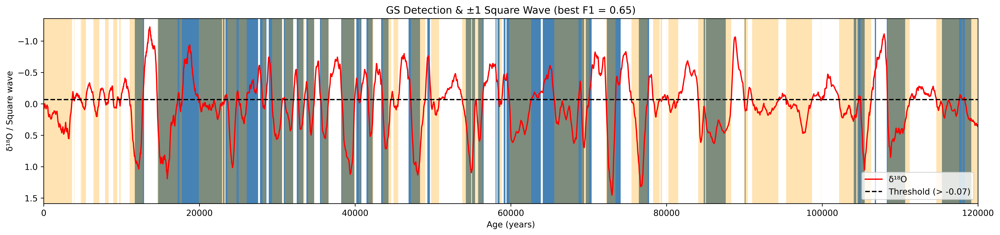

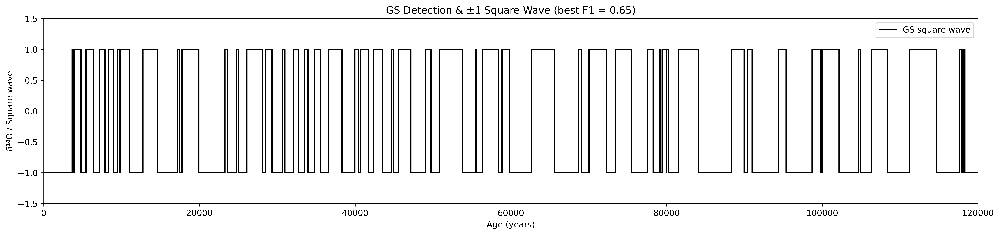

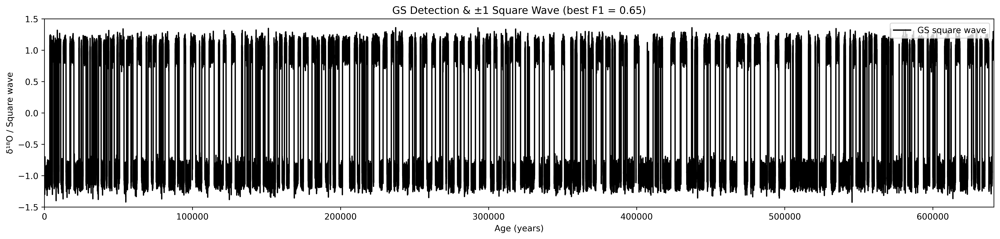

In [55]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from itertools import groupby

# ------------------------------------------------------------------
# 1.  YOUR GS TABLE  (unchanged)
# ------------------------------------------------------------------
data = {
    "event": ["GS-1", "GS-2.1c", "GS-2.2", "GS-3", "GS-4", "GS-5.1", "GS-5.2", "GS-6",
              "GS-7", "GS-8", "GS-9", "GS-10", "GS-11", "GS-12", "GS-13", "GS-14",
              "GS-15.1", "GS-15.2", "GS-16.1", "GS-16.2", "GS-17.1", "GS-17.2",
              "GS-18", "GS-19.1", "GS-19.2", "GS-20", "GS-21.1", "GS-21.2", "GS-22",
              "GS-23.1", "GS-23.2", "GS-24.1", "GS-24.2", "GS-25", "GS-26"],
    "start": [11703, 14692, 23020, 23340, 27780, 28900, 30840, 32500, 33740, 35480,
              38220, 40160, 41460, 43340, 46860, 49280, 54220, 55000, 55800, 58040,
              58280, 59080, 59440, 64100, 69620, 72340, 76440, 84760, 85060, 90040,
              104040, 104520, 106750, 108280, 115370],
    "end":   [12896, 22900, 23220, 27540, 28600, 30600, 32040, 33360, 34740, 36580,
              39900, 40800, 42240, 44280, 48340, 49600, 54900, 55400, 56500, 58160,
              58560, 59300, 63840, 69400, 70380, 74100, 77760, 84960, 87600, 90140,
              104380, 105440, 106900, 110640, 119140]
}

# ------------------------------------------------------------------
# 2.  Boolean "ground-truth" vector
# ------------------------------------------------------------------
# crop the df for data <120000 years
new_df_crop = new_df.copy()
new_df_crop = new_df_crop[new_df_crop['age'] < 120000]

ages = new_df_crop['age'].values
d18O  = new_df_crop['d18O'].values

ages_all = new_df['age'].values
d18O_all  = new_df['d18O'].values

is_gs_true = np.zeros_like(ages, dtype=bool)
for s, e in zip(data["start"], data["end"]):
    is_gs_true |= (ages >= s) & (ages <= e)

# ------------------------------------------------------------------
# 3.  Find best δ18O threshold (as before)
# ------------------------------------------------------------------
def f1(pred, true):
    tp = np.sum(pred & true)
    fp = np.sum(pred & ~true)
    fn = np.sum(~pred & true)
    return 2*tp / (2*tp + fp + fn) if (2*tp + fp + fn) else 0

cands = np.percentile(d18O, np.linspace(5, 95, 181))
best_thr, best_f1, best_dir = None, -1, None
for direction in ('gt','lt'):
    for thr in cands:
        pred = d18O > thr if direction=='gt' else d18O < thr
        score = f1(pred, is_gs_true)
        if score > best_f1:
            best_thr, best_f1, best_dir = thr, score, direction

# ------------------------------------------------------------------
# 4.  Build predicted GS mask & contiguous segments
# ------------------------------------------------------------------

# is_gs_pred = d18O > best_thr if best_dir=='gt' else d18O < best_thr
is_gs_pred = d18O_all > best_thr if best_dir=='gt' else d18O_all < best_thr

segments = []
for k, grp in groupby(enumerate(is_gs_pred), key=lambda x:x[1]):
    if k:
        grp = list(grp)
        segments.append((ages_all[grp[0][0]], ages_all[grp[-1][0]]))

print(f"Best threshold = {best_dir} {best_thr:.3f},  F1 = {best_f1:.2f}")

# ------------------------------------------------------------------
# 5.  Create the ±1 square wave: -1 inside GS, +1 outside
# ------------------------------------------------------------------
square_wave = np.where(is_gs_pred, -1, 1)

# ------------------------------------------------------------------
# 6.  Plot everything
# ------------------------------------------------------------------
fig, ax = plt.subplots(figsize=(20, 4), dpi=600)

# a) Official GS intervals
for s, e in zip(data["start"], data["end"]):
    ax.axvspan(s, e, color='steelblue', alpha=1, zorder=0, linewidth=0)

# b) Predicted GS intervals
for s, e in segments:
    ax.axvspan(s, e, color='orange', alpha=0.30, zorder=1, linewidth=0)

# c) δ18O curve
ax.plot(ages, d18O, color='red', label='δ¹⁸O', zorder=2)

# d) Horizontal threshold
ax.axhline(best_thr, color='k', linestyle='--',
           label=f"Threshold ({'>' if best_dir=='gt' else '<'} {best_thr:.2f})",
           zorder=3)

# # e) Square wave
# ax.plot(ages, square_wave, drawstyle='steps-post',
#         color='black', linewidth=1.5, label='GS square wave', zorder=4)

# # adjust y-limits so the square wave is clear
# ax.set_ylim(min(square_wave)-0.5, max(square_wave)+0.5)
# inverse the y-axis
ax.invert_yaxis()
# Cosmetics
ax.set_xlabel('Age (years)')
ax.set_ylabel('δ¹⁸O / Square wave')
ax.set_xlim(0, 120000)
ax.set_title(f"GS Detection & ±1 Square Wave (best F1 = {best_f1:.2f})")
# ax.grid(True)
ax.legend(loc='lower right')

plt.show()




fig, ax = plt.subplots(figsize=(20, 4), dpi=600)

# e) Square wave
ax.plot(ages_all, square_wave, drawstyle='steps-post',
        color='black', linewidth=1.5, label='GS square wave', zorder=4)

# adjust y-limits so the square wave is clear
ax.set_ylim(min(square_wave)-0.5, max(square_wave)+0.5)

# Cosmetics
ax.set_xlabel('Age (years)')
ax.set_ylabel('δ¹⁸O / Square wave')
ax.set_xlim(0, 120000)
ax.set_title(f"GS Detection & ±1 Square Wave (best F1 = {best_f1:.2f})")
# ax.grid(True)
ax.legend()

plt.show()






# create a new DataFrame for the square wave
df_sq = pd.DataFrame({'age': ages_all, 'sq': square_wave})

white_noise = np.random.normal(0, 0.1, len(square_wave))
df_sq['sq'] = df_sq['sq'] + white_noise




fig, ax = plt.subplots(figsize=(20, 4), dpi=600)
# e) Square wave
ax.plot(df_sq['age'], df_sq['sq'], drawstyle='steps-post',
        color='black', linewidth=1.5, label='GS square wave', zorder=4)

# adjust y-limits so the square wave is clear
ax.set_ylim(min(square_wave)-0.5, max(square_wave)+0.5)

# Cosmetics
ax.set_xlabel('Age (years)')
ax.set_ylabel('δ¹⁸O / Square wave')
# ax.set_xlim(0, 120000)
ax.set_title(f"GS Detection & ±1 Square Wave (best F1 = {best_f1:.2f})")
# ax.grid(True)
ax.legend(loc='upper right')
# set x lim
ax.set_xlim(0, 641260)

plt.show()



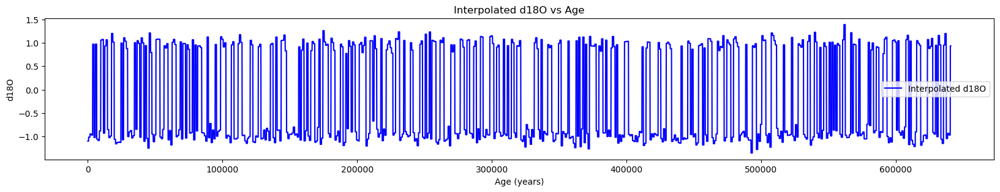

         age       pre
0          0  0.016280
1        100  0.016431
2        200  0.016568
3        300  0.016690
4        400  0.016798
...      ...       ...
6405  640500 -0.003302
6406  640600 -0.003582
6407  640700 -0.003858
6408  640800 -0.004129
6409  640900 -0.004396

[6410 rows x 2 columns]


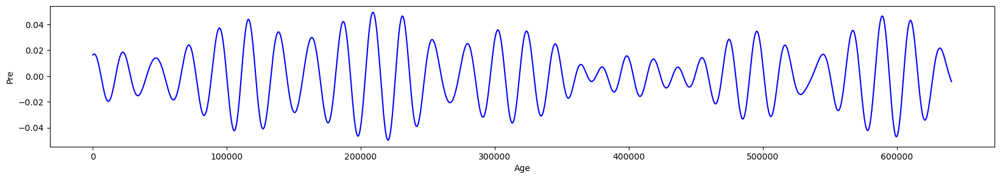

         age       obl
0          0  0.409093
1        100  0.409320
2        200  0.409547
3        300  0.409773
4        400  0.410000
...      ...       ...
6405  640500  0.398998
6406  640600  0.399029
6407  640700  0.399062
6408  640800  0.399098
6409  640900  0.399136

[6410 rows x 2 columns]


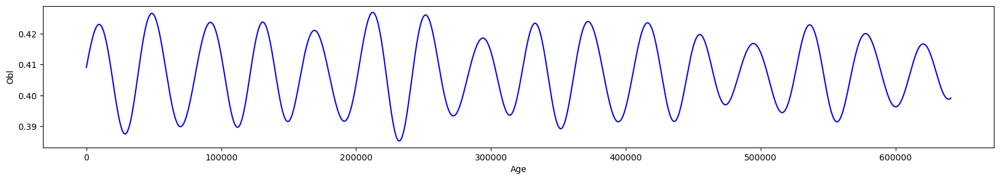

In [50]:
import pandas as pd
from scipy.interpolate import interp1d

# for df_sq, interpolated it to has 100 times lower resolution
new_age = np.arange(np.min(df_sq['age'].values), np.max(df_sq['age'].values), 100)
# create a new DataFrame with the new age values
f_sq = interp1d(df_sq['age'], df_sq['sq'], kind='nearest',
             bounds_error=False,
             fill_value=1)
interpolated_sq = f_sq(new_age)
# create a new DataFrame with the new age values
df_sq = pd.DataFrame({'age': new_age, 'sq': interpolated_sq})

# plot the data
plt.figure(figsize=(20, 3))
plt.plot(df_sq['age'], df_sq['sq'], label='Interpolated d18O', color='blue')
plt.xlabel('Age (years)')
plt.ylabel('d18O')
plt.title('Interpolated d18O vs Age')
plt.legend()
plt.show()

# # filp the second column upside down (last row to first row)
# df_sq['sq'] = df_sq['sq'].iloc[::-1].reset_index(drop=True)
# # plot the data
# plt.figure(figsize=(20, 3))
# plt.plot(df_sq['age'], df_sq['sq'], label='Interpolated d18O', color='blue')
# plt.xlabel('Age (years)')
# plt.ylabel('d18O')
# plt.title('Interpolated d18O vs Age')
# plt.legend()
# plt.show()




# Read the file into a DataFrame
df_pre = pd.read_csv(
    r"D:\VScode\bipolar_seesaw_CCM\inso_data\pre_800_inter100.txt", 
    sep='\s+',       # '\s+' means "split on any whitespace"
    header=None,     # or specify a row number if there's a header
    engine='python'
)

df_obl = pd.read_csv(
    r"D:\VScode\bipolar_seesaw_CCM\inso_data\obl_800_inter100.txt", 
    sep='\s+',       # '\s+' means "split on any whitespace"
    header=None,     # or specify a row number if there's a header
    engine='python'
)

df_pre.iloc[:, 0] = df_pre.iloc[:, 0].abs() * 1000
df_obl.iloc[:, 0] = df_obl.iloc[:, 0].abs() * 1000


# # plot df_pre
# plt.figure(figsize=(20, 3))
# plt.plot(df_pre.iloc[:, 0], df_pre.iloc[:, 1], label='pre', color='blue')
# plt.xlabel("Age")
# plt.ylabel("Pre")
# print(df_pre)
# plt.show()

# Reverse the DataFrame rows
df_pre = df_pre.iloc[::-1]
df_pre.columns = ['age', 'pre']

df_obl = df_obl.iloc[::-1]
df_obl.columns = ['age', 'obl']


# interpolate the data using new_age
f = interp1d(df_pre['age'], df_pre['pre'], kind='nearest',
             bounds_error=False,
             fill_value=1)

interpolated_pre = f(new_age)
df_pre = pd.DataFrame({'age': new_age, 'pre': interpolated_pre})

f = interp1d(df_obl['age'], df_obl['obl'], kind='nearest',
             bounds_error=False,
             fill_value=1)

interpolated_obl = f(new_age)
df_obl = pd.DataFrame({'age': new_age, 'obl': interpolated_obl})

# plot df_pre
plt.figure(figsize=(20, 3))
plt.plot(df_pre.iloc[:, 0], df_pre.iloc[:, 1], label='pre', color='blue')
plt.xlabel("Age")
plt.ylabel("Pre")
print(df_pre)
plt.show()

plt.figure(figsize=(20, 3))
plt.plot(df_obl.iloc[:, 0], df_obl.iloc[:, 1], label='obl', color='blue')
plt.xlabel("Age")
plt.ylabel("Obl")
print(df_obl)
plt.show()

TE(pre→residual) = 0.0095 bits


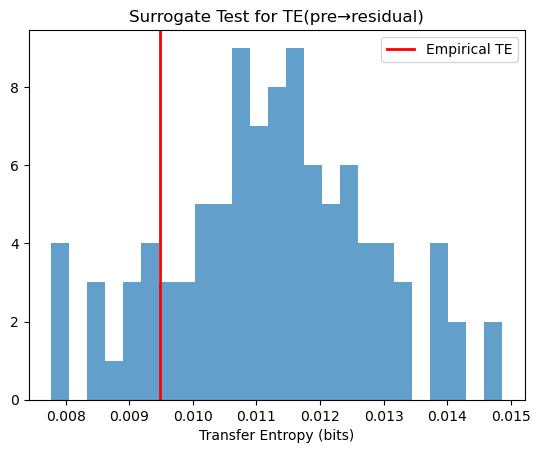

p-value = 0.850


In [53]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from pyinform import transfer_entropy  # correct import! :contentReference[oaicite:0]{index=0}

# — assume df_pre_aligned['pre'] and df_residual['residual'] exist and are same length
x = df_pre['pre'].values      # source (precession)
y = df_sq['sq'].values    # target (residual)

# 1) Discretize into nbins equiprobable bins
nbins = 8
xbins = np.histogram_bin_edges(x, bins=nbins)
ybins = np.histogram_bin_edges(y, bins=nbins)
x_disc = np.digitize(x, xbins) - 1
y_disc = np.digitize(y, ybins) - 1

# 2) Compute TE from pre→residual with history length k=1
#    note: drop last/first sample to align t→t+1
te_xy = transfer_entropy(x_disc[:-1], y_disc[1:], k=1)
print(f"TE(pre→residual) = {te_xy:.4f} bits")

# 3) Permutation‐based surrogate test
n_surr = 100
te_null = np.zeros(n_surr)
for i in range(n_surr):
    xs = np.random.permutation(x_disc)
    te_null[i] = transfer_entropy(xs[:-1], y_disc[1:], k=1)

# 4) Plot null distribution
plt.hist(te_null, bins=25, alpha=0.7)
plt.axvline(te_xy, color='r', lw=2, label='Empirical TE')
plt.xlabel('Transfer Entropy (bits)')
plt.legend()
plt.title('Surrogate Test for TE(pre→residual)')
plt.show()

# 5) Compute p-value
p_value = np.mean(te_null >= te_xy)
print(f"p-value = {p_value:.3f}")

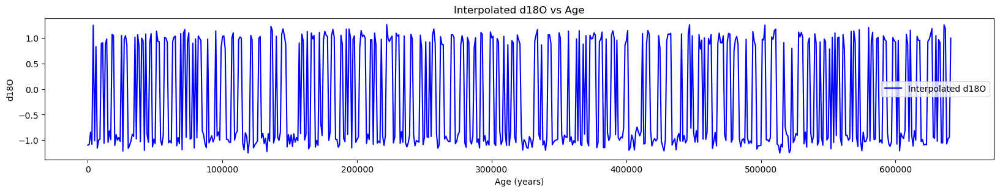

        age       pre
0         0  0.016280
1      1000  0.017116
2      2000  0.016308
3      3000  0.014018
4      4000  0.010453
..      ...       ...
637  637000  0.008929
638  638000  0.005100
639  639000  0.001432
640  640000 -0.001830
641  641000 -0.004658

[642 rows x 2 columns]


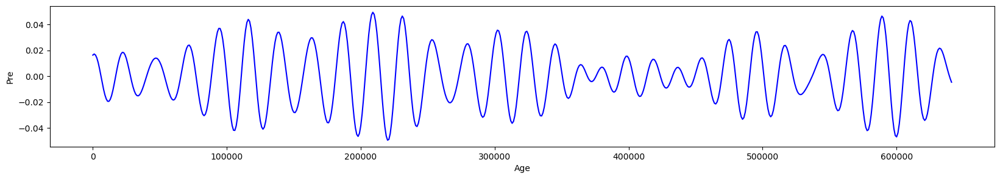

        age       obl
0         0  0.409093
1      1000  0.411353
2      2000  0.413555
3      3000  0.415639
4      4000  0.417555
..      ...       ...
637  637000  0.399430
638  638000  0.399004
639  639000  0.398819
640  640000  0.398878
641  641000  0.399176

[642 rows x 2 columns]


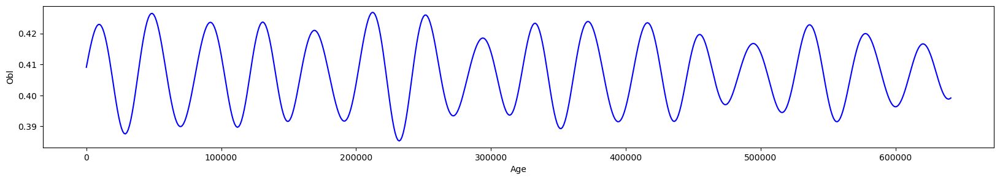

In [56]:
import pandas as pd
from scipy.interpolate import interp1d

# for df_sq, interpolated it to has 100 times lower resolution
new_age = np.arange(np.min(df_sq['age'].values), np.max(df_sq['age'].values), 1000)
# create a new DataFrame with the new age values
f_sq = interp1d(df_sq['age'], df_sq['sq'], kind='nearest',
             bounds_error=False,
             fill_value=1)
interpolated_sq = f_sq(new_age)
# create a new DataFrame with the new age values
df_sq = pd.DataFrame({'age': new_age, 'sq': interpolated_sq})

# plot the data
plt.figure(figsize=(20, 3))
plt.plot(df_sq['age'], df_sq['sq'], label='Interpolated d18O', color='blue')
plt.xlabel('Age (years)')
plt.ylabel('d18O')
plt.title('Interpolated d18O vs Age')
plt.legend()
plt.show()

# # filp the second column upside down (last row to first row)
# df_sq['sq'] = df_sq['sq'].iloc[::-1].reset_index(drop=True)
# # plot the data
# plt.figure(figsize=(20, 3))
# plt.plot(df_sq['age'], df_sq['sq'], label='Interpolated d18O', color='blue')
# plt.xlabel('Age (years)')
# plt.ylabel('d18O')
# plt.title('Interpolated d18O vs Age')
# plt.legend()
# plt.show()




# Read the file into a DataFrame
df_pre = pd.read_csv(
    r"D:\VScode\bipolar_seesaw_CCM\inso_data\pre_800.txt", 
    sep='\s+',       # '\s+' means "split on any whitespace"
    header=None,     # or specify a row number if there's a header
    engine='python'
)

df_obl = pd.read_csv(
    r"D:\VScode\bipolar_seesaw_CCM\inso_data\obl_800.txt", 
    sep='\s+',       # '\s+' means "split on any whitespace"
    header=None,     # or specify a row number if there's a header
    engine='python'
)

df_pre.iloc[:, 0] = df_pre.iloc[:, 0].abs() * 1000
df_obl.iloc[:, 0] = df_obl.iloc[:, 0].abs() * 1000


# # plot df_pre
# plt.figure(figsize=(20, 3))
# plt.plot(df_pre.iloc[:, 0], df_pre.iloc[:, 1], label='pre', color='blue')
# plt.xlabel("Age")
# plt.ylabel("Pre")
# print(df_pre)
# plt.show()

# Reverse the DataFrame rows
df_pre = df_pre.iloc[::-1]
df_pre.columns = ['age', 'pre']

df_obl = df_obl.iloc[::-1]
df_obl.columns = ['age', 'obl']


# interpolate the data using new_age
f = interp1d(df_pre['age'], df_pre['pre'], kind='nearest',
             bounds_error=False,
             fill_value=1)

interpolated_pre = f(new_age)
df_pre = pd.DataFrame({'age': new_age, 'pre': interpolated_pre})

f = interp1d(df_obl['age'], df_obl['obl'], kind='nearest',
             bounds_error=False,
             fill_value=1)

interpolated_obl = f(new_age)
df_obl = pd.DataFrame({'age': new_age, 'obl': interpolated_obl})

# plot df_pre
plt.figure(figsize=(20, 3))
plt.plot(df_pre.iloc[:, 0], df_pre.iloc[:, 1], label='pre', color='blue')
plt.xlabel("Age")
plt.ylabel("Pre")
print(df_pre)
plt.show()

plt.figure(figsize=(20, 3))
plt.plot(df_obl.iloc[:, 0], df_obl.iloc[:, 1], label='obl', color='blue')
plt.xlabel("Age")
plt.ylabel("Obl")
print(df_obl)
plt.show()

In [15]:
df_sq.info

<bound method DataFrame.info of         age        sq
0         0 -0.798224
1      1000 -0.919420
2      2000 -1.072063
3      3000 -1.089792
4      4000 -0.976345
..      ...       ...
636  636000  0.852289
637  637000  0.811075
638  638000 -0.972099
639  639000 -0.888085
640  640000  0.993051

[641 rows x 2 columns]>

In [16]:
df_pre.info

<bound method DataFrame.info of         age       pre
0         0  0.016280
1      1000  0.017116
2      2000  0.016308
3      3000  0.014018
4      4000  0.010453
..      ...       ...
636  636000  0.012790
637  637000  0.008929
638  638000  0.005100
639  639000  0.001432
640  640000 -0.001830

[641 rows x 2 columns]>

TE(pre→residual) = 0.1013 bits


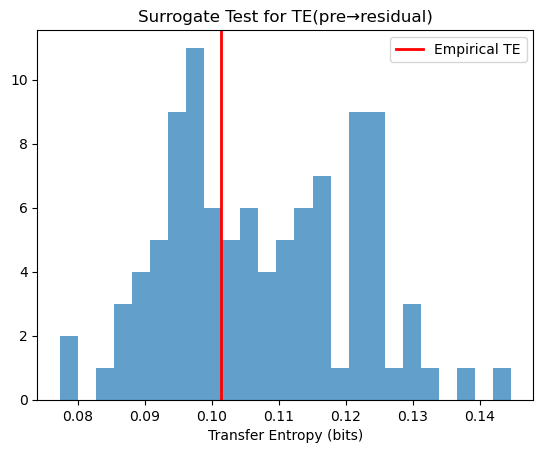

p-value = 0.600


In [95]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from pyinform import transfer_entropy  # correct import! :contentReference[oaicite:0]{index=0}

# — assume df_pre_aligned['pre'] and df_residual['residual'] exist and are same length
x = df_pre['pre'].values      # source (precession)
y = df_sq['sq'].values    # target (residual)

# 1) Discretize into nbins equiprobable bins
nbins = 8
xbins = np.histogram_bin_edges(x, bins=nbins)
ybins = np.histogram_bin_edges(y, bins=nbins)
x_disc = np.digitize(x, xbins) - 1
y_disc = np.digitize(y, ybins) - 1

# 2) Compute TE from pre→residual with history length k=1
#    note: drop last/first sample to align t→t+1
te_xy = transfer_entropy(x_disc[:-1], y_disc[1:], k=1)
print(f"TE(pre→residual) = {te_xy:.4f} bits")

# 3) Permutation‐based surrogate test
n_surr = 100
te_null = np.zeros(n_surr)
for i in range(n_surr):
    xs = np.random.permutation(x_disc)
    te_null[i] = transfer_entropy(xs[:-1], y_disc[1:], k=1)

# 4) Plot null distribution
plt.hist(te_null, bins=25, alpha=0.7)
plt.axvline(te_xy, color='r', lw=2, label='Empirical TE')
plt.xlabel('Transfer Entropy (bits)')
plt.legend()
plt.title('Surrogate Test for TE(pre→residual)')
plt.show()

# 5) Compute p-value
p_value = np.mean(te_null >= te_xy)
print(f"p-value = {p_value:.3f}")

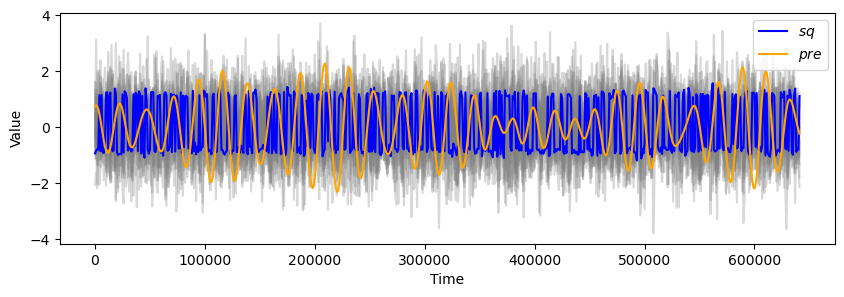

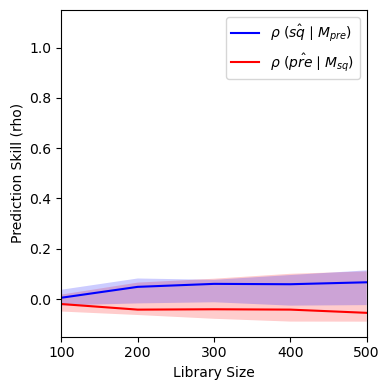

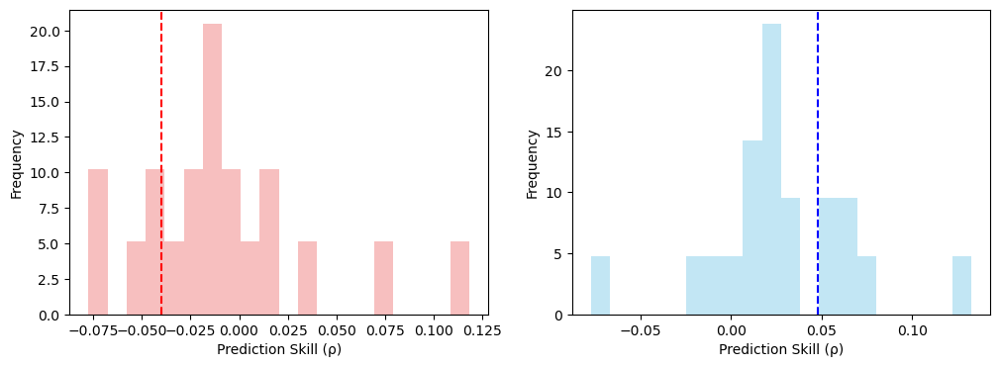

(False, False)


In [48]:
from toolbox import significant_test as st
import importlib
importlib.reload(st)



ccm_out, ran_ccm_list_xy, test_result=st.ccm_significance_test_v3(
    df_sq, 
    df_pre,
    E=6, 
    tau=-5, 
    n_ran=20, 
    libSizes="100 200 300 400 500",
    Tp=0,
    sample=20,
    random=True,
    uni_dir=False,
    showPlot=True)

print(test_result)

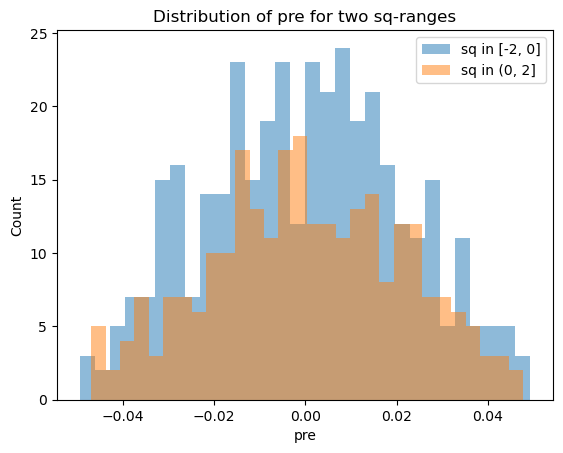

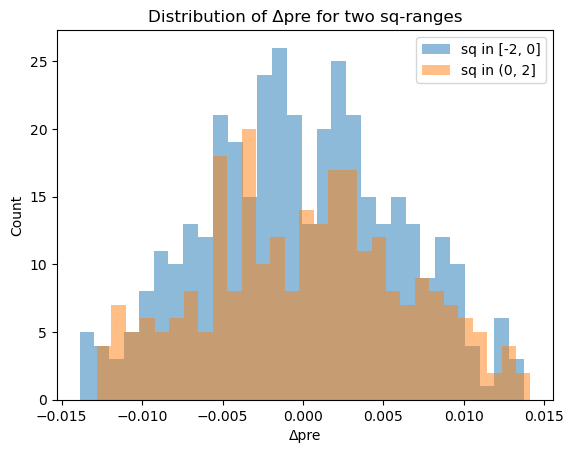

In [49]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

# --- assume df_pre and df_sq are already defined ---
# df_pre has columns ['age','pre'], df_sq has ['age','sq'] and identical indexing

# Part 1: histograms of pre for sq in [-2,0] vs (0,2]
mask1 = (df_sq['sq'] >= -2) & (df_sq['sq'] <= 0)
mask2 = (df_sq['sq'] >  0) & (df_sq['sq'] <= 2)

pre1 = df_pre.loc[mask1, 'pre']
pre2 = df_pre.loc[mask2, 'pre']

plt.figure()
plt.hist(pre1, bins=30, alpha=0.5, label='sq in [-2, 0]')
plt.hist(pre2, bins=30, alpha=0.5, label='sq in (0, 2]')
plt.xlabel('pre')
plt.ylabel('Count')
plt.title('Distribution of pre for two sq‐ranges')
plt.legend()
plt.show()


# Part 2: histograms of diff(pre) aligned to sq[1:]
pre_vals   = df_pre['pre'].values
diff_pre   = np.diff(pre_vals)
sq_aligned = df_sq['sq'].values[1:]  # diff[i] corresponds to transition into index i+1

mask1_d = (sq_aligned >= -2) & (sq_aligned <= 0)
mask2_d = (sq_aligned >  0) & (sq_aligned <= 2)

diff1 = diff_pre[mask1_d]
diff2 = diff_pre[mask2_d]

plt.figure()
plt.hist(diff1, bins=30, alpha=0.5, label='sq in [-2, 0]')
plt.hist(diff2, bins=30, alpha=0.5, label='sq in (0, 2]')
plt.xlabel('Δpre')
plt.ylabel('Count')
plt.title('Distribution of Δpre for two sq‐ranges')
plt.legend()
plt.show()


In [20]:
import numpy as np
import plotly.graph_objs as go
from plotly.offline import init_notebook_mode

# Initialize Plotly for offline use
init_notebook_mode(connected=True)

# Ensure df_sq is present
if 'df_sq' not in globals():
    raise NameError("DataFrame 'df_sq' not found. Please ensure you have loaded your DataFrame 'df_sq' with a 'sq' column.")

# Extract the 'sq' series
sq = df_sq['sq'].values

# Embedding parameters
E = 3
tau = 10

# Compute embedding dimension
N = len(sq)
M = N - (E - 1) * tau

# Build the delay embedding matrix
embedded = np.zeros((M, E))
for i in range(M):
    for j in range(E):
        embedded[i, j] = sq[i + j * tau]

# Assign axes
x, y, z = embedded[:, 0], embedded[:, 1], embedded[:, 2]

# Create 3D scatter plot
trace = go.Scatter3d(
    x=x,
    y=y,
    z=z,
    mode='markers',
    marker=dict(size=3)
)

layout = go.Layout(
    title=f'Shadow Manifold (E={E}, τ={tau})',
    scene=dict(
        xaxis=dict(title='sq(t)'),
        yaxis=dict(title=f'sq(t+{tau})'),
        zaxis=dict(title=f'sq(t+{2*tau})')
    )
)

fig = go.Figure(data=[trace], layout=layout)
fig.show()


In [21]:
import numpy as np
import plotly.graph_objs as go
from plotly.offline import init_notebook_mode

# Initialize Plotly for offline use
init_notebook_mode(connected=True)

# Ensure df_sq is present
if 'df_sq' not in globals():
    raise NameError("DataFrame 'df_sq' not found. Please ensure you have loaded your DataFrame 'df_sq' with a 'sq' column.")

# Extract the 'sq' series
sq = df_sq['sq'].values

# Embedding parameters (same as before)
E = 3
tau = 5

# Compute embedding length
N = len(sq)
M = N - (E - 1) * tau

# Build the delay embedding matrix
embedded = np.zeros((M, E))
for i in range(M):
    for j in range(E):
        embedded[i, j] = sq[i + j * tau]

# Use first two dimensions for 2D plot
x = embedded[:, 0]
y = embedded[:, 1]

# Create 2D scatter plot
trace = go.Scatter(
    x=x,
    y=y,
    mode='markers',
    marker=dict(size=5)
)

layout = go.Layout(
    title=f'2D Shadow Manifold (sq(t) vs sq(t+{tau}))',
    xaxis=dict(title='sq(t)'),
    yaxis=dict(title=f'sq(t+{tau})')
)

fig = go.Figure(data=[trace], layout=layout)
fig.show()


In [ ]:
# save df_sq and df_pre to csv under 'test/', please create the folder first
df_sq.to_csv(r"D:\VScode\bipolar_seesaw_CCM\test\df_sq.csv", index=False)
df_pre.to_csv(r"D:\VScode\bipolar_seesaw_CCM\test\df_pre.csv", index=False)

# read the csv file
df_sq = pd.read_csv(r"D:\VScode\bipolar_seesaw_CCM\test\df_sq.csv")
df_pre = pd.read_csv(r"D:\VScode\bipolar_seesaw_CCM\test\df_pre.csv")

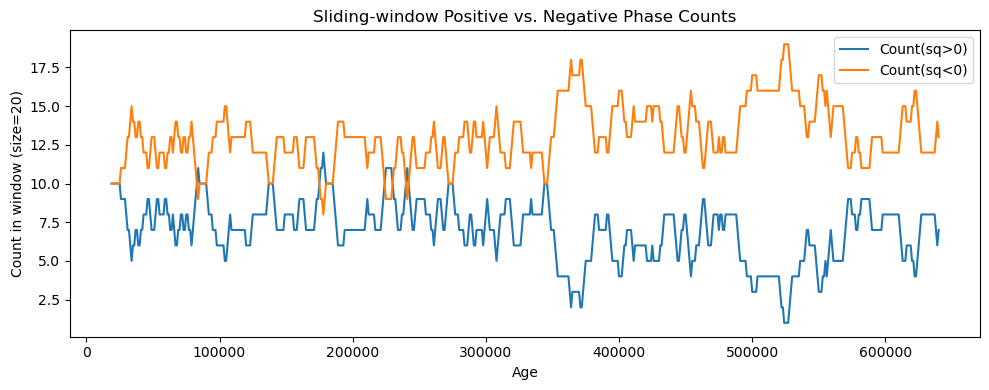

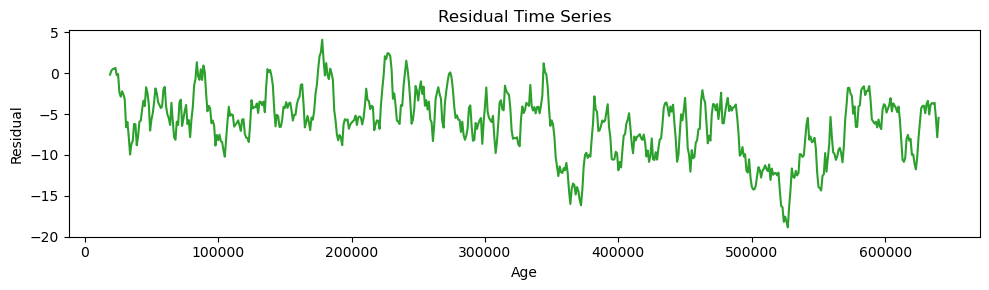

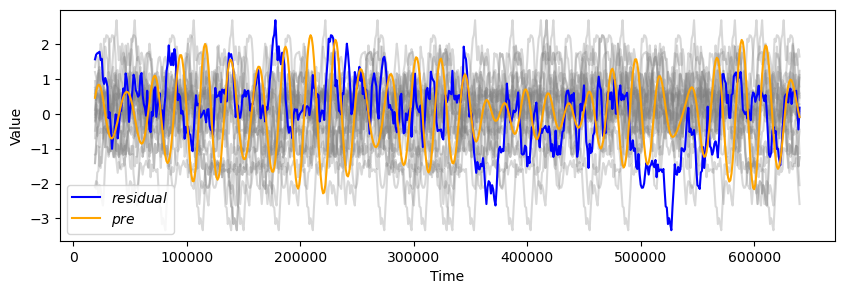

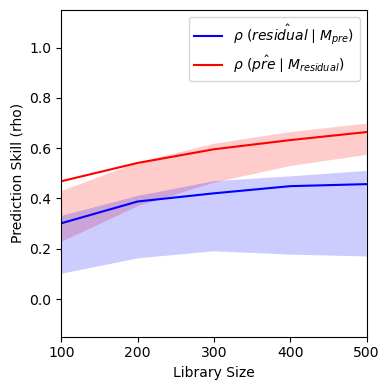

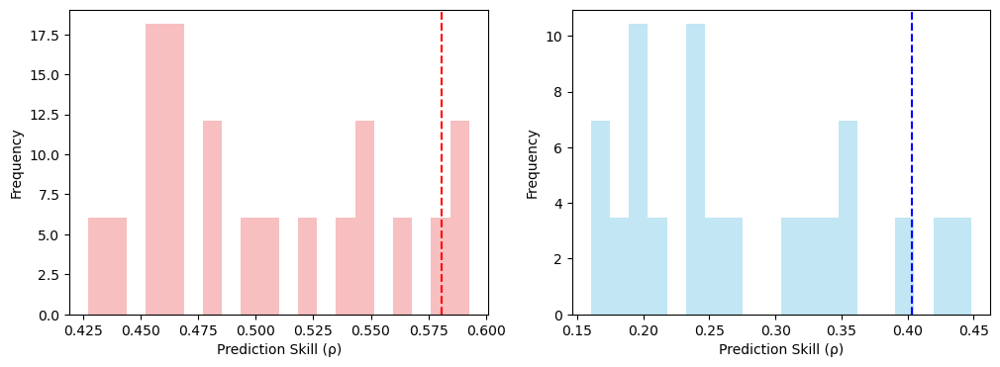

(False, False)


In [35]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from toolbox import significant_test as st
import importlib
importlib.reload(st)

# --- Parameters ---
window_size = 20

# --- 1) Compute moving‐window phase counts ---
sq_vals = df_sq['sq'].values
N       = len(sq_vals)
n_win   = N - window_size + 1

pos_counts = np.empty(n_win, dtype=int)
neg_counts = np.empty(n_win, dtype=int)
# For plotting, we can assign each window an “age” at its right edge:
ages = df_sq['age'].values[window_size-1 : ]

for i in range(n_win):
    w = sq_vals[i : i + window_size]
    pos_counts[i] = np.sum(w >  0)
    neg_counts[i] = np.sum(w <  0)

# --- 2) Plot positive vs. negative counts ---
plt.figure(figsize=(10,4))
plt.plot(ages, pos_counts, label='Count(sq>0)', color='tab:blue')
plt.plot(ages, neg_counts, label='Count(sq<0)', color='tab:orange')
plt.xlabel('Age')
plt.ylabel('Count in window (size=20)')
plt.title('Sliding‐window Positive vs. Negative Phase Counts')
plt.legend()
plt.tight_layout()
plt.show()

# --- 3) Compute and plot the “residual” time series ---
residual = pos_counts - neg_counts

# adding some noise to the residual
white_noise = np.random.normal(0, 0.5, len(residual))
residual = residual + white_noise

plt.figure(figsize=(10,3))
plt.plot(ages, residual, label='Residual = pos_counts - neg_counts', color='tab:green')
plt.xlabel('Age')
plt.ylabel('Residual')
plt.title('Residual Time Series')
plt.tight_layout()
plt.show()

# --- 4) Prepare for CCM: align residual and precession ---
#   Residual has length n_win, so drop the first (window_size-1) rows of df_pre:
df_pre_aligned = df_pre.iloc[window_size-1 : ].reset_index(drop=True)

#   Make a small DataFrame for residual
df_residual = pd.DataFrame({
    'age':      ages,
    'residual': residual
})

# --- 5) Run your CCM significance test ---
ccm_out, ran_ccm_list_xy, test_result = st.ccm_significance_test_v2(
    df_residual,           # now our “driver” series
    df_pre_aligned,        # target (precession), same length as residual
    E=6,
    tau=-5,
    n_ran=20,
    libSizes="100 200 300 400 500",
    Tp=0,
    sample=20,
    random=True,
    uni_dir=False,
    showPlot=True
)

print(test_result)


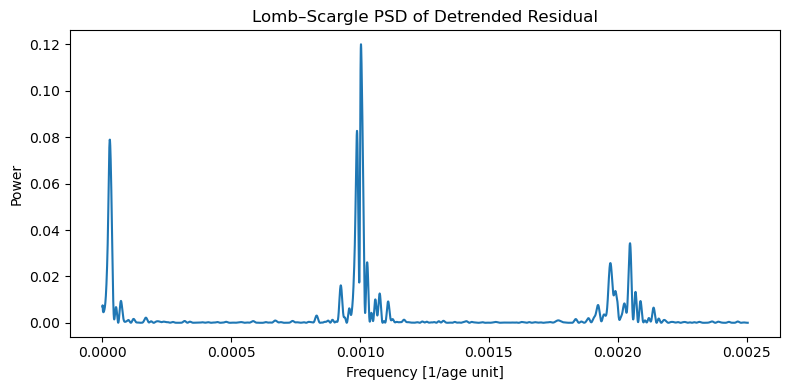

In [38]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import detrend
from astropy.timeseries import LombScargle

# --- Assume df_residual exists with 'age' (time) and 'residual' columns ---
t = df_residual['age'].values
y = df_residual['residual'].values

# 1) Linearly detrend the residual
y_detrended = detrend(y)

# 2) Compute Lomb-Scargle periodogram (power spectral density)
ls = LombScargle(t, y_detrended)
frequency, power = ls.autopower()

# 3) Plot PSD
plt.figure(figsize=(8, 4))
plt.plot(frequency, power)
# set x lim to 0 to 0.0001
# plt.xlim(0, 0.0001)
plt.xlabel('Frequency [1/age unit]')
plt.ylabel('Power')
plt.title('Lomb–Scargle PSD of Detrended Residual')
plt.tight_layout()
plt.show()


TE(pre→residual) = 0.1523 bits


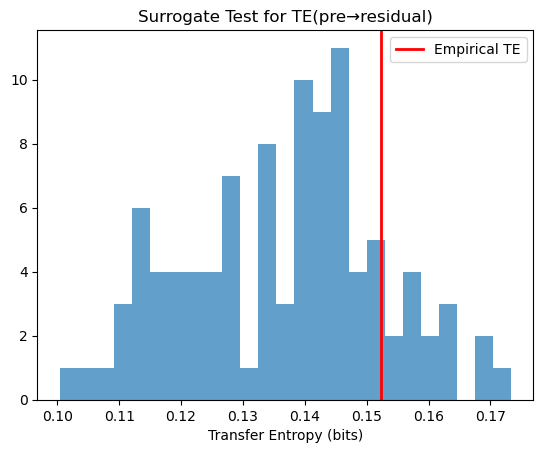

p-value = 0.150


In [42]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from pyinform import transfer_entropy  # correct import! :contentReference[oaicite:0]{index=0}

# — assume df_pre_aligned['pre'] and df_residual['residual'] exist and are same length
x = df_pre_aligned['pre'].values      # source (precession)
y = df_residual['residual'].values    # target (residual)

# 1) Discretize into nbins equiprobable bins
nbins = 8
xbins = np.histogram_bin_edges(x, bins=nbins)
ybins = np.histogram_bin_edges(y, bins=nbins)
x_disc = np.digitize(x, xbins) - 1
y_disc = np.digitize(y, ybins) - 1

# 2) Compute TE from pre→residual with history length k=1
#    note: drop last/first sample to align t→t+1
te_xy = transfer_entropy(x_disc[:-1], y_disc[1:], k=1)
print(f"TE(pre→residual) = {te_xy:.4f} bits")

# 3) Permutation‐based surrogate test
n_surr = 100
te_null = np.zeros(n_surr)
for i in range(n_surr):
    xs = np.random.permutation(x_disc)
    te_null[i] = transfer_entropy(xs[:-1], y_disc[1:], k=1)

# 4) Plot null distribution
plt.hist(te_null, bins=25, alpha=0.7)
plt.axvline(te_xy, color='r', lw=2, label='Empirical TE')
plt.xlabel('Transfer Entropy (bits)')
plt.legend()
plt.title('Surrogate Test for TE(pre→residual)')
plt.show()

# 5) Compute p-value
p_value = np.mean(te_null >= te_xy)
print(f"p-value = {p_value:.3f}")


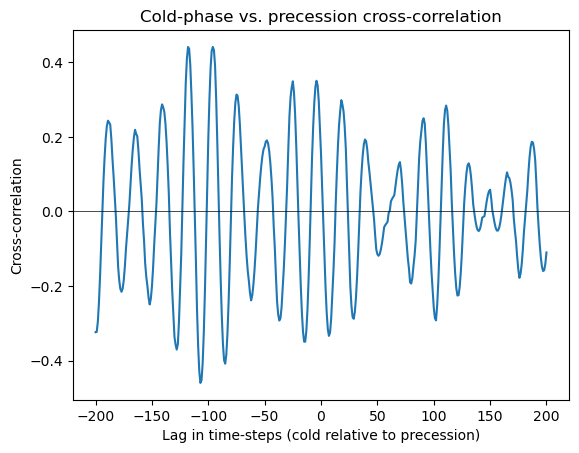

In [26]:
cold = (df_sq['sq'] < 0).astype(float)
pre  = (df_pre['pre'] - df_pre['pre'].mean()) / df_pre['pre'].std()


import numpy as np
import matplotlib.pyplot as plt

cold = (df_sq['sq'] < 0).astype(float).values
pre  = (df_pre['pre'] - df_pre['pre'].mean()) / df_pre['pre'].std()

maxlag = 200  # choose based on your sampling (e.g. ±200 kyr)
lags = np.arange(-maxlag, maxlag+1)
ccf  = []
for lag in lags:
    # shift cold forward by “lag” so that positive lag means “cold after precession”
    c = np.corrcoef(np.roll(cold, -lag)[maxlag:-maxlag],
                    pre          [maxlag:-maxlag])[0,1]
    ccf.append(c)

plt.plot(lags, ccf)
plt.axhline(0, color='k', lw=0.5)
plt.xlabel('Lag in time‐steps (cold relative to precession)')
plt.ylabel('Cross‐correlation')
plt.title('Cold‐phase vs. precession cross‐correlation')
plt.show()



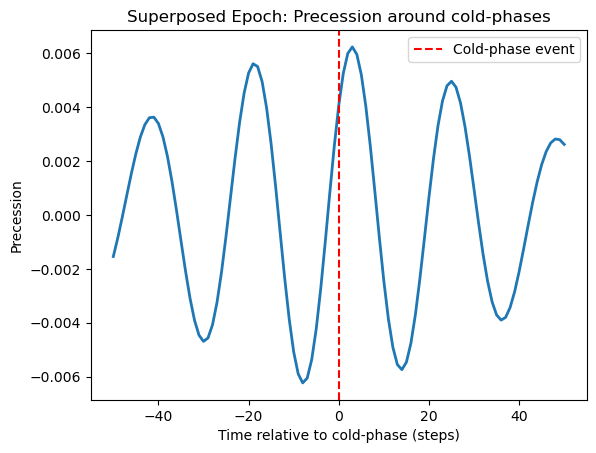

In [27]:
import numpy as np
import matplotlib.pyplot as plt

# 1) Identify event indices
events    = df_sq.index[df_sq['sq'] < 0]          # or whichever criterion you like
half_win  = 50                                    # e.g. ±50 time‐steps around each event
windows   = []

for e in events:
    if e-half_win >= 0 and e+half_win < len(df_pre):
        window = df_pre['pre'].iloc[e-half_win:e+half_win+1].values
        windows.append(window)

# 2) Build the composite
composite = np.vstack(windows)
mean_compo = composite.mean(axis=0)

# 3) Plot
times = np.arange(-half_win, half_win+1)
plt.plot(times, mean_compo, lw=2)
plt.axvline(0, color='r', ls='--', label='Cold‐phase event')
plt.xlabel('Time relative to cold‐phase (steps)')
plt.ylabel('Precession')
plt.title('Superposed Epoch: Precession around cold‐phases')
plt.legend()
plt.show()


In [ ]:
from scipy.stats import chi2_contingency

# 1) Compute Δpre
dpre = np.diff(df_pre['pre'])
# Align mask to same length as df_sq (drop first row of sq)
cold_mask = (df_sq['sq'].iloc[1:] < 0)
dec_mask  = (dpre < 0)

# 2) Build table
# a = cold & decreasing; b = cold & increasing; c = warm & decreasing; d = warm & increasing
a = np.sum( cold_mask & dec_mask)
b = np.sum( cold_mask & ~dec_mask)
c = np.sum(~cold_mask & dec_mask)
d = np.sum(~cold_mask & ~dec_mask)
table = np.array([[a, b],
                  [c, d]])

print("Contingency table:\n", table)

# 3) Test
chi2, p, dof, expected = chi2_contingency(table)
print(f"χ²={chi2:.2f}, p={p:.3f}")


Contingency table:
 [[239 178]
 [ 79 144]]
χ²=26.98, p=0.000


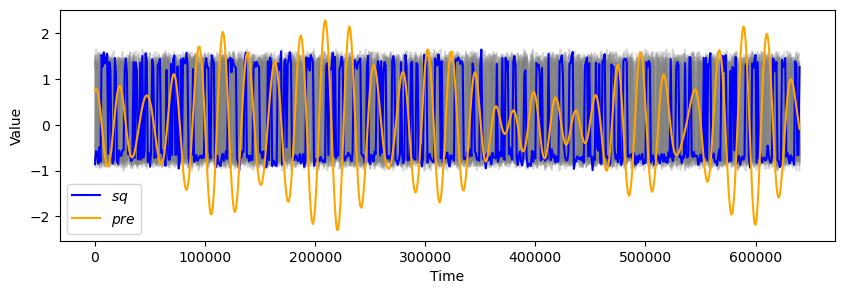

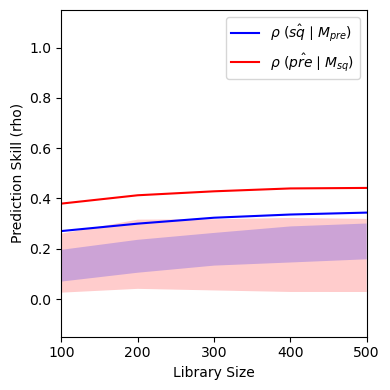

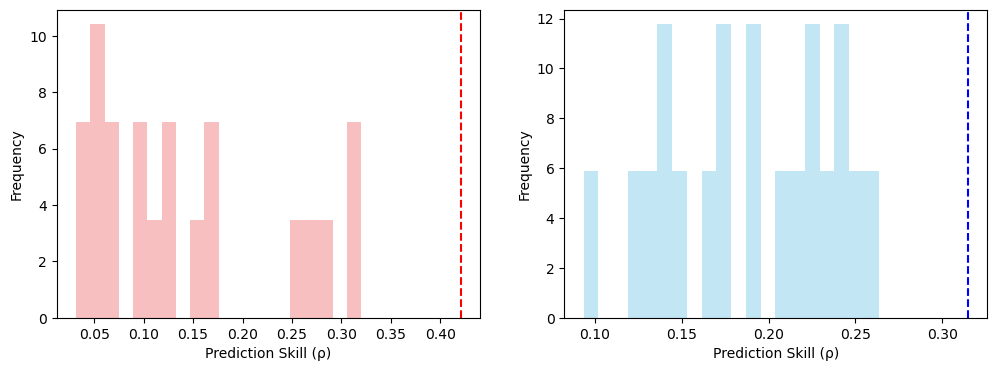

In [ ]:
from toolbox import significant_test as st
import importlib
importlib.reload(st)



ccm_out, ran_ccm_list_xy, test_result=st.ccm_significance_test_v2(
    df_sq, 
    df_pre,
    E=6, 
    tau=-5, 
    n_ran=20, 
    libSizes="100 200 300 400 500",
    Tp=0,
    sample=20,
    random=True,
    uni_dir=False,
    showPlot=True)

Best threshold = gt 0.352,  F1 = 0.24


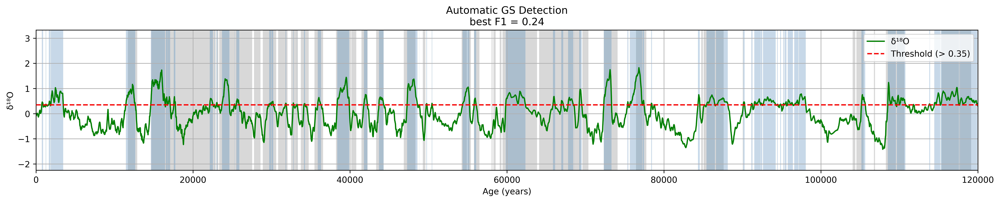

In [22]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from itertools import groupby

# ------------------------------------------------------------------
# 1.  YOUR GS TABLE  (unchanged – keep it exactly as you supplied)
# ------------------------------------------------------------------
data = {
    "event": ["GS-1", "GS-2.1c", "GS-2.2", "GS-3", "GS-4", "GS-5.1", "GS-5.2", "GS-6",
              "GS-7", "GS-8", "GS-9", "GS-10", "GS-11", "GS-12", "GS-13", "GS-14",
              "GS-15.1", "GS-15.2", "GS-16.1", "GS-16.2", "GS-17.1", "GS-17.2",
              "GS-18", "GS-19.1", "GS-19.2", "GS-20", "GS-21.1", "GS-21.2", "GS-22",
              "GS-23.1", "GS-23.2", "GS-24.1", "GS-24.2", "GS-25", "GS-26"],
    "start": [11703, 14692, 23020, 23340, 27780, 28900, 30840, 32500, 33740, 35480,
              38220, 40160, 41460, 43340, 46860, 49280, 54220, 55000, 55800, 58040,
              58280, 59080, 59440, 64100, 69620, 72340, 76440, 84760, 85060, 90040,
              104040, 104520, 106750, 108280, 115370],
    "end":   [12896, 22900, 23220, 27540, 28600, 30600, 32040, 33360, 34740, 36580,
              39900, 40800, 42240, 44280, 48340, 49600, 54900, 55400, 56500, 58160,
              58560, 59300, 63840, 69400, 70380, 74100, 77760, 84960, 87600, 90140,
              104380, 105440, 106900, 110640, 119140]
}

# ------------------------------------------------------------------
# 2.  Boolean "ground-truth" vector: 1⇔inside any GS interval, 0⇔otherwise
# ------------------------------------------------------------------
ages = new_df['age'].values
d18O = new_df['d18O'].values

is_gs_true = np.zeros_like(ages, dtype=bool)
for s, e in zip(data["start"], data["end"]):
    is_gs_true |= (ages >= s) & (ages <= e)          # element-wise “OR”

# ------------------------------------------------------------------
# 3.  Scan candidate thresholds and pick the one that maximises F1
#     • We try both directions (δ¹⁸O > y  *or*  δ¹⁸O < y)
# ------------------------------------------------------------------
def f1(pred, true):
    tp = np.sum(pred & true)
    fp = np.sum(pred & ~true)
    fn = np.sum(~pred & true)
    return 2 * tp / (2 * tp + fp + fn) if (2 * tp + fp + fn) else 0.0

# Use a grid of percentiles as candidate cut-offs
cands = np.percentile(d18O, np.linspace(5, 95, 181))   # ≈0.5 % steps

best_thr, best_f1, best_dir = None, -1, None
for direction in ('gt', 'lt'):                         # greater-than OR less-than
    for thr in cands:
        pred = d18O > thr if direction == 'gt' else d18O < thr
        score = f1(pred, is_gs_true)
        if score > best_f1:
            best_thr, best_f1, best_dir = thr, score, direction

# ------------------------------------------------------------------
# 4.  Build contiguous predicted GS segments for plotting
# ------------------------------------------------------------------
is_gs_pred = d18O > best_thr if best_dir == 'gt' else d18O < best_thr

segments = []                                          # (start_age, end_age) pairs
for k, grp in groupby(enumerate(is_gs_pred), key=lambda x: x[1]):
    if k:                                              # only True segments
        grp = list(grp)
        segments.append((ages[grp[0][0]], ages[grp[-1][0]]))

print(f"Best threshold = {best_dir} {best_thr:.3f},  F1 = {best_f1:.2f}")

# ------------------------------------------------------------------
# 5.  Plot everything
# ------------------------------------------------------------------
fig, ax = plt.subplots(figsize=(20, 3), dpi=600)

# a) Official GS intervals (grey)
for s, e in zip(data["start"], data["end"]):
    ax.axvspan(s, e, color='grey', alpha=0.30, zorder=0, linewidth=0)

# b) Predicted GS intervals from δ¹⁸O (blue)
for s, e in segments:
    ax.axvspan(s, e, color='steelblue', alpha=0.30, zorder=1, linewidth=0)

# c) δ¹⁸O curve
ax.plot(ages, d18O, color='green', label='δ¹⁸O', zorder=2)

# d) Horizontal threshold
ax.axhline(best_thr, color='red', linestyle='--',
           label=f"Threshold ({'>' if best_dir=='gt' else '<'} {best_thr:.2f})", zorder=3)

# Cosmetic bits
ax.set_xlabel('Age (years)')
ax.set_ylabel('δ¹⁸O')
ax.set_xlim(0, 120000)
ax.set_title(f"Automatic GS Detection\nbest F1 = {best_f1:.2f}")
ax.grid(True)
ax.legend(loc='upper right')

plt.show()


In [26]:
# for column d18O in new_df, find the quantiles that 0.35 corresponds to

quantile_0_35 = np.percentile(new_df['d18O'],80)
print(f"0.35 quantile of d18O: {quantile_0_35}")

0.35 quantile of d18O: 0.45055558476972235


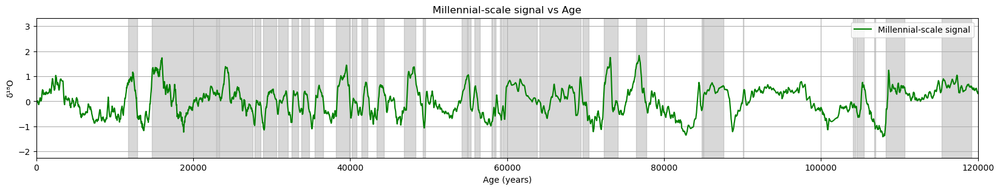

In [ ]:
import numpy as np
import matplotlib.pyplot as plt


data = {
    "event": ["GS-1", "GS-2.1c", "GS-2.2", "GS-3", "GS-4", "GS-5.1", "GS-5.2", "GS-6", "GS-7", "GS-8",
              "GS-9", "GS-10", "GS-11", "GS-12", "GS-13", "GS-14", "GS-15.1", "GS-15.2", "GS-16.1", "GS-16.2",
              "GS-17.1", "GS-17.2", "GS-18", "GS-19.1", "GS-19.2", "GS-20", "GS-21.1", "GS-21.2", "GS-22",
              "GS-23.1", "GS-23.2", "GS-24.1", "GS-24.2", "GS-25", "GS-26"],
    # note: these are the *start* times of the GS events
    "start": [11703, 14692, 23020, 23340, 27780, 28900, 30840, 32500, 33740, 35480,
              38220, 40160, 41460, 43340, 46860, 49280, 54220, 55000, 55800, 58040,
              58280, 59080, 59440, 64100, 69620, 72340, 76440, 84760, 85060, 90040,
              104040, 104520, 106750, 108280, 115370],
    # and these are the *end* times
    "end":   [12896, 22900, 23220, 27540, 28600, 30600, 32040, 33360, 34740, 36580,
              39900, 40800, 42240, 44280, 48340, 49600, 54900, 55400, 56500, 58160,
              58560, 59300, 63840, 69400, 70380, 74100, 77760, 84960, 87600, 90140,
              104380, 105440, 106900, 110640, 119140]
}


# plot
plt.figure(figsize=(20, 3))

# add grey spans for each GS event
for s, e in zip(data["start"], data["end"]):
    plt.axvspan(s, e, color='grey', alpha=0.3)

# millennial-scale signal
plt.plot(new_df['age'], new_df['d18O'],
         label='Millennial‐scale signal', color='green')

plt.xlabel('Age (years)')
plt.ylabel('δ¹⁸O')
plt.title('Millennial‐scale signal vs Age')
plt.legend(loc='upper right')
plt.grid(True)
# reverse the y-axis
# plt.gca().invert_yaxis()
plt.xlim(0, 120000)

plt.show()

